# **👑DATA SCHOOL TEAM PROJECT**  
**┗ 은행 사기거래 계좌 탐지**
---
> **목차(Context)**

* 프로젝트 Summary
* 문제상황 Introduction
* 데이터 전처리
* Process 1: 데이터 EDA
* Process 2: 모델링
* Process 3: 데이터 EDA
* Process 4: 모델링
* Process 5: 결과 해석
* Lesson & Learn

## **프로젝트 Summary**
---

> **프로젝트명**

```
▶ 은행 사기거래 계좌 탐지
```  

> **프로젝트유형**

```
▶ 데이터 EDA
▶ 룰베이스 이진분류
▶ 머신러닝 이진분류
```

> **학습목표**

```
▶ 추출한 유용한 정보를 시각화하는 능력 향상
▶ 인사이트 도출 능력 향상
▶ 분류 모델링 능력 향상
▶ 은행 데이터로부터 유용한 정보를 추출
▶ 사기 데이터로부터 유용한 정보를 추출
```

> **예상 결과물**

```
▶ 은행 계좌 사기에 대한 인사이트
▶ 사기 사기거래 분류 모델
```

## **문제상황 Introduction**
---
> **시나리오**

```
최근 사기의 형태가 다양해지고 있으며, 사기 건수 또한 증가하고 있습니다.
특히 은행 및 금융 분야에서의 사기는 막대한 재산 피해를 초래할 수 있습니다.
이에 저희는 이러한 은행 및 금융 분야에 중점을 두고 사기를 탐지하고 예방하고자 합니다.
```  

> **문제정의**

```
은행 계좌 사기로 인한 막대한 재산 피해
```  

> **기대효과**

```
은행 계좌 사기 방지
```

> **해결방안**

```
사기 계좌 이진분류 모델을 설계하여 사실 확인 후 계좌 정지
```

> **성과측정**  

```
은행 계좌 사기 건수 모니터링
```

> **데이터 살펴보기** (수정 필요)

|Column|Description|
|:---|:---|
|fraud_bool|사기 여부 (bool)|
|income|연간소득 순위 (십분위 형식), 범위 [0.1 ~ 0.9]|
|name_email_similarity|이메일과 이름 유사성 (값이 높을수록 유사성이 높음)|
|prev_address_months_count|이전 등록 주소 유지 개월 수 (-1은 결측값)|
|current_address_months_count|현재 등록 주소 유지 개월 수 (-1은 결측값)|
|customer_age|신청자 나이 (10년 단위로 반올림)|
|days_since_request|신청완료 경과일|
|intended_balcon_amount|초기 이체 금액 (없으면 -1)|
|payment_type|결제 요금제 유형|
|zip_count_4w|동일 우편번호 신청 건수 (4주 기간)|
|velocity_6h|개설신청 속도 (직전 6시간)|
|velocity_24h|개설신청 속도 (직전 24시간)|
|velocity_4w|개설신청 속도 (직전 4주)|
|bank_branch_count_8w|해당 은행 지점에 접수 신청 건수 (8주)|
|date_of_birth_distinct_emails_4w|동일 생년월일 이메일 수 (4주)|
|employment_status|고용 상태|
|credit_risk_score|신용위험점수|
|email_is_free|이메일의 종류 (무료는 1)|
|housing_status|거주 상태|
|phone_home_valid|집전화 유효 여부|
|phone_mobile_valid|휴대폰의 유효 여부|
|bank_months_count|가입기간이 오래된 정도 (-1은 결측값)|
|has_other_cards|같은 은행의 다른 카드 여부|
|proposed_credit_limit|신용 한도|
|foreign_request|외국여부|
|source|신청 소스 (인터넷, 텔레폰)|
|session_length_in_minutes|사용자 웹사이트 세션의 길이 (-1은 결측값)|
|device_os|신청 디바이스의 os|
|keep_alive_session|세션 로그아웃 여부|
|device_distinct_emails_8w|해당 기기로 접속한 이메일 수 (8주) (-1은 결측값)|
|device_fraud_count|해당 디바이스의 사기 이력|
|month|신청한 월|

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
import torch

In [ ]:
import warnings
warnings.filterwarnings('ignore')

# from google.colab import drive
# drive.mount('/content/drive')

# import os
# os.chdir('/content/drive/MyDrive')
# os.getcwd()

In [ ]:
import pandas as pd

df = pd.read_csv('Base.csv')
df.head()

,fraud_bool,income,name_email_similarity,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,has_other_cards,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_distinct_emails_8w,device_fraud_count,month
0,0,0.3,0.986506,-1,25,40,0.006735,102.453711,AA,1059,...,0,1500.0,0,INTERNET,16.224843,linux,1,1,0,0
1,0,0.8,0.617426,-1,89,20,0.010095,-0.849551,AD,1658,...,0,1500.0,0,INTERNET,3.363854,other,1,1,0,0
2,0,0.8,0.996707,9,14,40,0.012316,-1.490386,AB,1095,...,0,200.0,0,INTERNET,22.730559,windows,0,1,0,0
3,0,0.6,0.475100,11,14,30,0.006991,-1.863101,AB,3483,...,0,200.0,0,INTERNET,15.215816,linux,1,1,0,0
4,0,0.9,0.842307,-1,29,40,5.742626,47.152498,AA,2339,...,0,200.0,0,INTERNET,3.743048,other,0,1,0,0


## **데이터 전처리**

In [ ]:
df.shape

(1000000, 32)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 32 columns):
 #   Column                            Non-Null Count    Dtype  
---  ------                            --------------    -----  
 0   fraud_bool                        1000000 non-null  int64  
 1   income                            1000000 non-null  float64
 2   name_email_similarity             1000000 non-null  float64
 3   prev_address_months_count         1000000 non-null  int64  
 4   current_address_months_count      1000000 non-null  int64  
 5   customer_age                      1000000 non-null  int64  
 6   days_since_request                1000000 non-null  float64
 7   intended_balcon_amount            1000000 non-null  float64
 8   payment_type                      1000000 non-null  object 
 9   zip_count_4w                      1000000 non-null  int64  
 10  velocity_6h                       1000000 non-null  float64
 11  velocity_24h                      1000

In [ ]:
df.isnull().sum()

,0
fraud_bool,0
income,0
name_email_similarity,0
prev_address_months_count,0
current_address_months_count,0
customer_age,0
days_since_request,0
intended_balcon_amount,0
payment_type,0
zip_count_4w,0


In [ ]:
# missing value는 -1으로 표시하는 컬럼이 있다. (총 6개)

# prev_address_months_count -> 신규인 경우, pass
# current_address_months_count -> 신규인 경우, pass
# bank_months_count -> 신규인 경우, pass
# device_distinct_emails_8w -> 신규인 경우, pass
# session_length_in_minutes -> 세션 튕긴 것인지? (2015개, 내부에 사기유저 있음)

# intended_balcon_amount -> 명세서와 다른 부분이 있다. drop 한다.
# (-1이 결측치라고 나와 있다. 하지만 음수가 -1만 있는게 아니라 float 이다.)

df.describe().T

,count,mean,std,min,25%,50%,75%,max
fraud_bool,1000000.0,0.011029,0.104438,0.000000e+00,0.000000,0.000000,0.000000,1.000000
income,1000000.0,0.562696,0.290343,1.000000e-01,0.300000,0.600000,0.800000,0.900000
name_email_similarity,1000000.0,0.493694,0.289125,1.434550e-06,0.225216,0.492153,0.755567,0.999999
prev_address_months_count,1000000.0,16.718568,44.046230,-1.000000e+00,-1.000000,-1.000000,12.000000,383.000000
current_address_months_count,1000000.0,86.587867,88.406599,-1.000000e+00,19.000000,52.000000,130.000000,428.000000
customer_age,1000000.0,33.689080,12.025799,1.000000e+01,20.000000,30.000000,40.000000,90.000000
days_since_request,1000000.0,1.025705,5.381835,4.036860e-09,0.007193,0.015176,0.026331,78.456904
intended_balcon_amount,1000000.0,8.661499,20.236155,-1.553055e+01,-1.181488,-0.830507,4.984176,112.956928
zip_count_4w,1000000.0,1572.692049,1005.374565,1.000000e+00,894.000000,1263.000000,1944.000000,6700.000000
velocity_6h,1000000.0,5665.296605,3009.380665,-1.706031e+02,3436.365848,5319.769349,7680.717827,16715.565404


In [ ]:
df = df.drop('intended_balcon_amount', axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 31 columns):
 #   Column                            Non-Null Count    Dtype  
---  ------                            --------------    -----  
 0   fraud_bool                        1000000 non-null  int64  
 1   income                            1000000 non-null  float64
 2   name_email_similarity             1000000 non-null  float64
 3   prev_address_months_count         1000000 non-null  int64  
 4   current_address_months_count      1000000 non-null  int64  
 5   customer_age                      1000000 non-null  int64  
 6   days_since_request                1000000 non-null  float64
 7   payment_type                      1000000 non-null  object 
 8   zip_count_4w                      1000000 non-null  int64  
 9   velocity_6h                       1000000 non-null  float64
 10  velocity_24h                      1000000 non-null  float64
 11  velocity_4w                       1000

## **Process01: 데이터 EDA**

In [ ]:
cols_categorical = df.select_dtypes(include=object).columns
cols_numerical = df.select_dtypes(exclude=object).columns

In [ ]:
# fraud 비율은 약 1.1%, 개수는 11029개

fraud_counts = df['fraud_bool'].value_counts()
fraud_ratio = df['fraud_bool'].value_counts(normalize=True) * 100
fraud_summary = pd.DataFrame({'Count': fraud_counts, 'Ratio': fraud_ratio})
print(fraud_summary)

             Count    Ratio
fraud_bool                 
0           988971  98.8971
1            11029   1.1029


### **Categorical**

payment_type: 5
employment_status: 7
housing_status: 7
source: 2
device_os: 5
--------------------------------------------------
##### payment_type Distribution #####


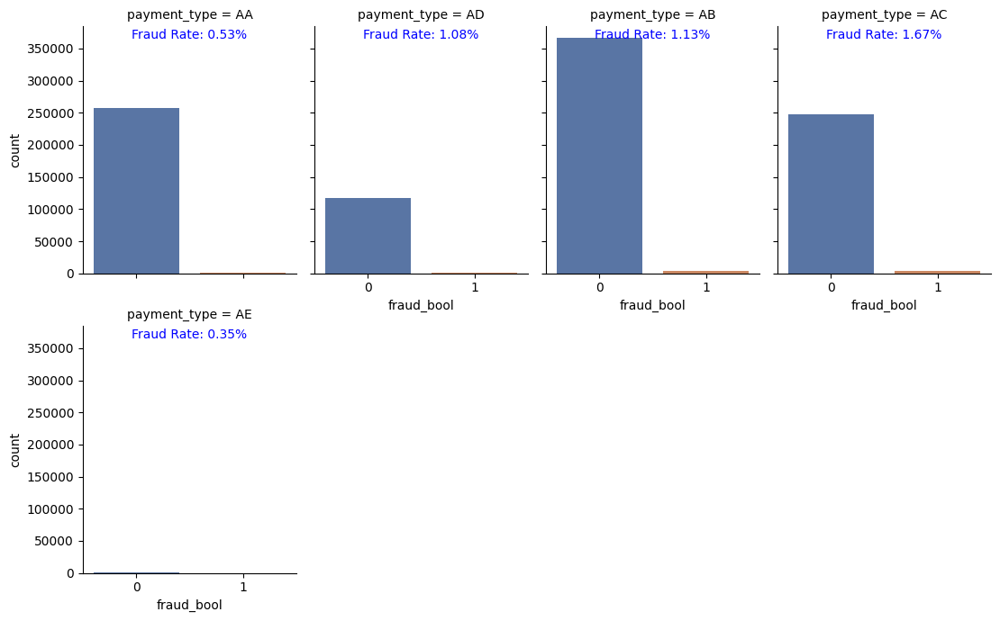

--------------------------------------------------
--------------------------------------------------
##### employment_status Distribution #####


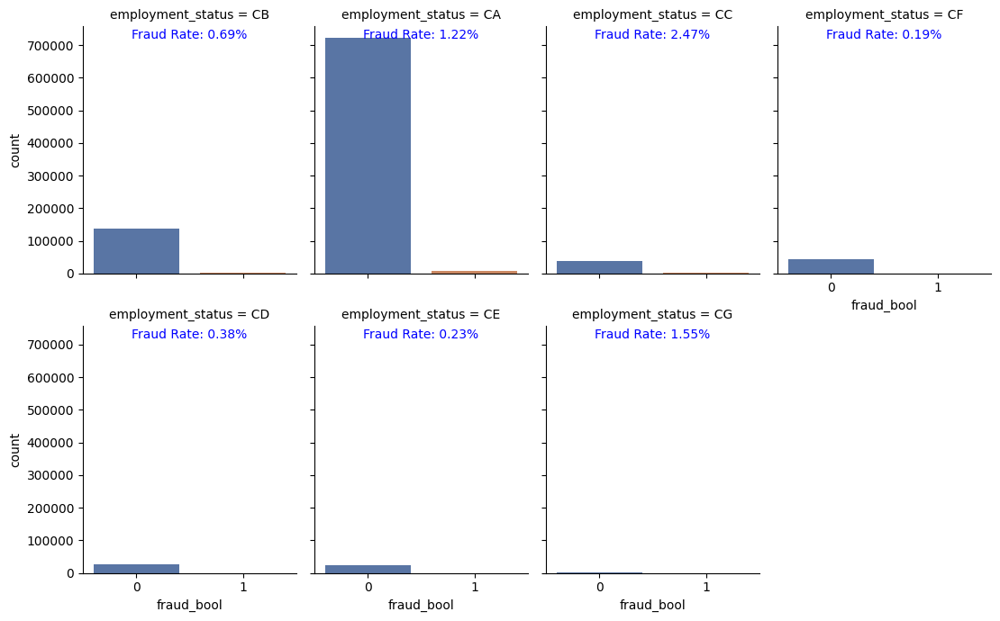

--------------------------------------------------
--------------------------------------------------
##### housing_status Distribution #####


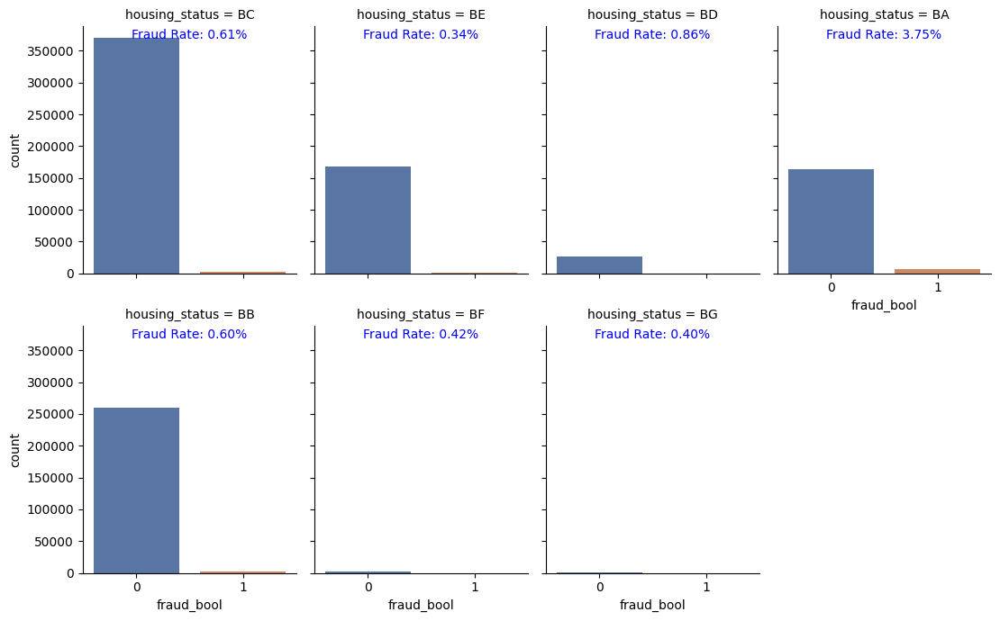

--------------------------------------------------
--------------------------------------------------
##### source Distribution #####


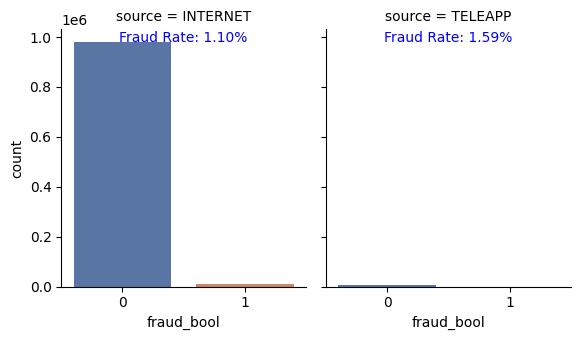

--------------------------------------------------
--------------------------------------------------
##### device_os Distribution #####


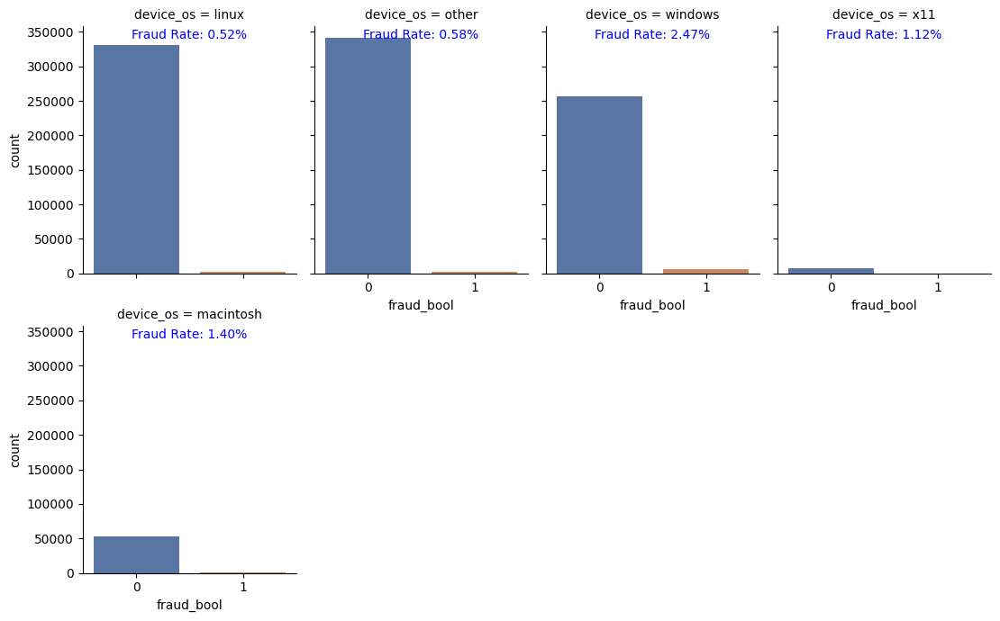

--------------------------------------------------


In [ ]:
# 카테고리컬 데이터 분석 1
# 구성 확인 및 사기 비율 확인
# 평균 fraud 비율과 비슷하거나 더 많은 클래스 확인

# payment_type = ['AC', 'AB']
# 'AC'의 경우 3번째로 사용하는 타입인데도 불구하고 fraud 비율이 높은 편이다. (1.67%)
# employment_status = ['CC', 'CA', 'CG']
# 소비자 대부분이 'CA'이다. 'CC'는 아주 높은 편이다. (2.47%)
# housing_status = ['BA']
# 'BA'의 경우 4번째로 거주하는 상태임에도 불구하고 fraud 비율이 높은 편이다. (3.75%)
# device_os = ['window', 'macintosh', 'x11']
# 'window'로 사기를 시도하는 경우가 매우 많다. (2.47%)

[print(f'{col}: {df[col].nunique()}') for col in cols_categorical]
for col in cols_categorical:
    print(f'-'*50)
    print(f'##### {col} Distribution #####')
    ratio_1 = df[df["fraud_bool"] == 1].groupby(col).size() / df.groupby(col).size() * 100
    g = sns.catplot(x="fraud_bool", col=col, col_wrap=4, data=df,
                kind="count", height=3.5, aspect=.8,  palette='deep')
    for ax in g.axes.flat:
        cat = ax.get_title().split(" = ")[-1]
        if cat in ratio_1:
            ax.text(0.5, 0.94,
                    f"Fraud Rate: {ratio_1[cat]:.2f}%",
                    ha="center", va="bottom", transform=ax.transAxes, fontsize=10, color="blue")
    plt.show()
    print(f'-'*50)

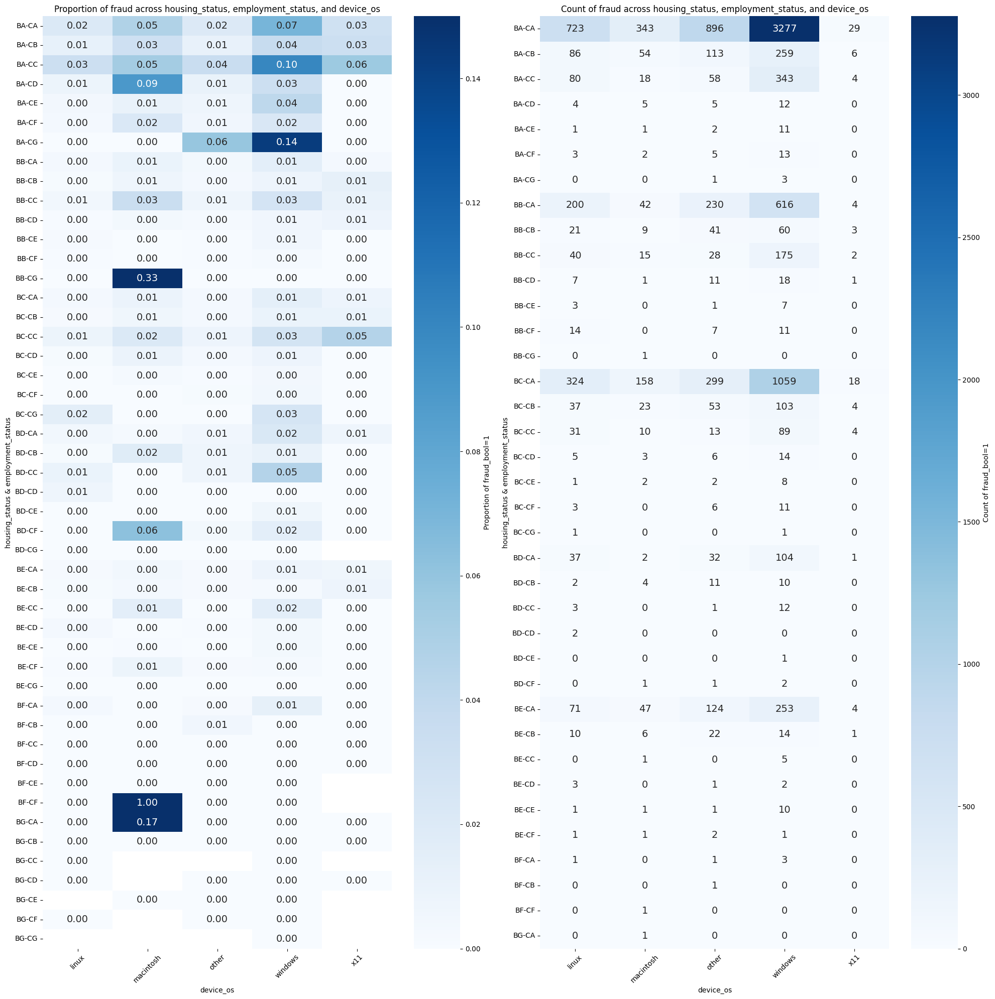

In [ ]:
# 카테고리컬 데이터 분석 2
# employment_status, housing_status, device_os 3차원 플랏

# [overview]
# 3개의 feature는 유용한 것으로 판단된다.
# 군집이 발견되긴 하나 확률이 높은 편이 아니라서 3개 만으로 분류할 순 없다.
# 따라서, 추가로 다른 feature를 활용해야만 한다. (뉴머리컬)
# 군집별로 분류를 진행하는 것도 괜찮아 보인다.

# [확률 높은 케이스]
# mac-BF-CF 조합은 100% 확률로 사기다. (1개, 의미 없음)
# mac-BB-CG 조합은 33% 확률로 사기다. (1개, 의미 없음)
# mac-BG-CA 조합은 17% 확률로 사기다.( 1개, 의미 없음)
# win-BA-CG 조합은 14% 확률로 사기다. (3개, 의미 없음)
# win-BA-CC 조합은 10% 확률로 사기다. (343개) (!) -> 군집 발견
# mac-BA-CD 조합은 9% 확률로 사기다. (5개, 의미 없음)
# win-BA-CA 조합은 5% 확률로 사기다. (343개) (!) -> 군집 발견
# mac-BA-CA 조합은 7% 확률로 사기다. (3277개) (!) -> 군집 발견

col_A = 'housing_status'
col_B = 'employment_status'
col_C = 'device_os'

grouped_mean = df.groupby([col_A, col_B, col_C])['fraud_bool'].mean().reset_index()
pivot_df_mean = grouped_mean.pivot_table(values='fraud_bool', index=[col_A, col_B], columns=col_C)

df_temp = df[df['fraud_bool'] == 1]
grouped_count = df_temp.groupby([col_A, col_B, col_C])['fraud_bool'].count().reset_index(name='count')
pivot_df_count = grouped_count.pivot_table(values='count', index=[col_A, col_B], columns=col_C, fill_value=0)
pivot_df_count = np.round(pivot_df_count).astype(int)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))

sns.heatmap(pivot_df_mean, annot=True, cmap="Blues", fmt=".2f", cbar_kws={'label': 'Proportion of fraud_bool=1'}, annot_kws={'size': 14}, ax=ax1, vmin=0, vmax=0.15)
ax1.set_title(f"Proportion of fraud across {col_A}, {col_B}, and {col_C}")
ax1.set_ylabel(f"{col_A} & {col_B}")
ax1.set_xlabel(f"{col_C}")
ax1.tick_params(axis='x', rotation=45)

sns.heatmap(pivot_df_count, annot=True, cmap="Blues", fmt="d", cbar_kws={'label': 'Count of fraud_bool=1'}, annot_kws={'size': 14}, ax=ax2)
ax2.set_title(f"Count of fraud across {col_A}, {col_B}, and {col_C}")
ax2.set_ylabel(f"{col_A} & {col_B}")
ax2.set_xlabel(f"{col_C}")
ax2.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

### **Numerical**

In [ ]:
# bool 타입이랑 사분위수 처럼 사실상 카테고리컬 같은 컬럼 분리

unique_counts = {col: df[col].nunique() for col in cols_numerical}
cols_numerical_under5 = [col for col, count in unique_counts.items() if count <= 5]
cols_numerical_over5 = [col for col, count in unique_counts.items() if count > 5]

--------------------------------------------------
##### fraud_bool Distribution #####


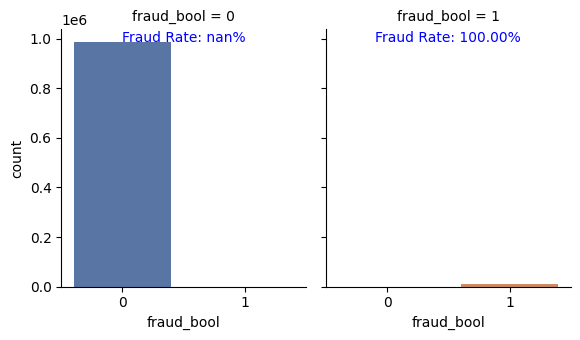

--------------------------------------------------
--------------------------------------------------
##### email_is_free Distribution #####


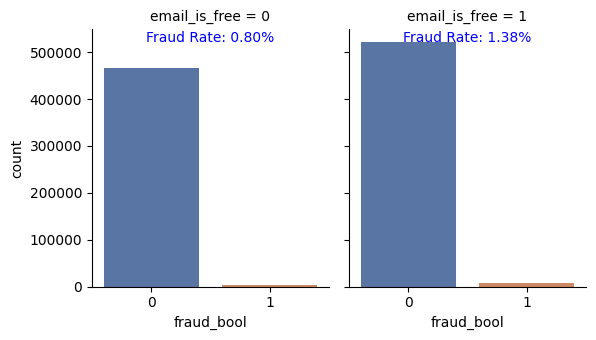

--------------------------------------------------
--------------------------------------------------
##### phone_home_valid Distribution #####


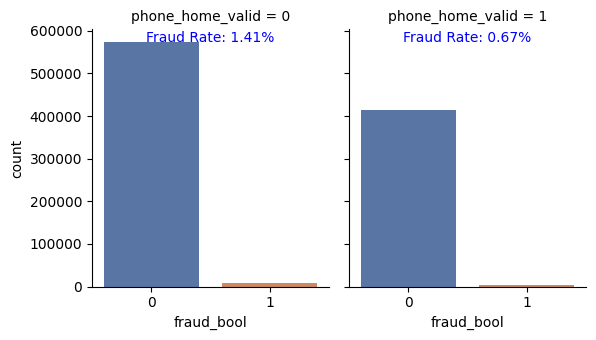

--------------------------------------------------
--------------------------------------------------
##### phone_mobile_valid Distribution #####


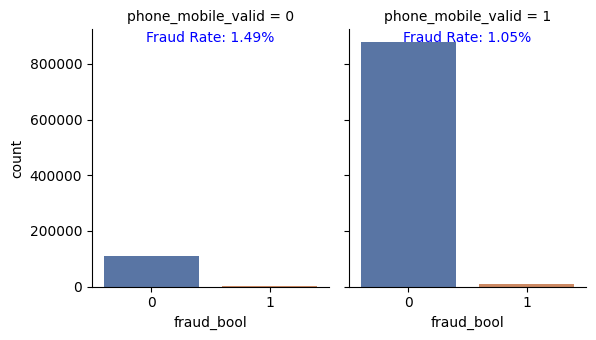

--------------------------------------------------
--------------------------------------------------
##### has_other_cards Distribution #####


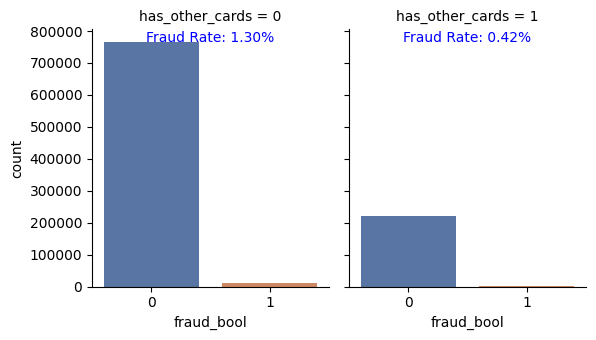

--------------------------------------------------
--------------------------------------------------
##### foreign_request Distribution #####


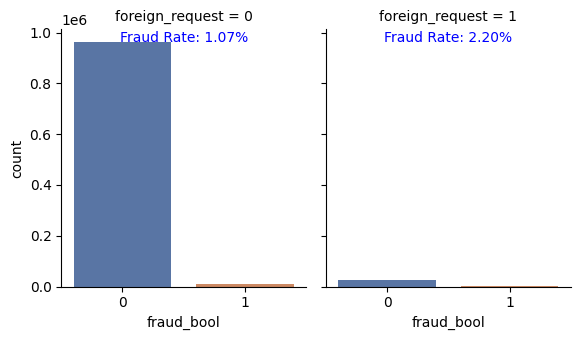

--------------------------------------------------
--------------------------------------------------
##### keep_alive_session Distribution #####


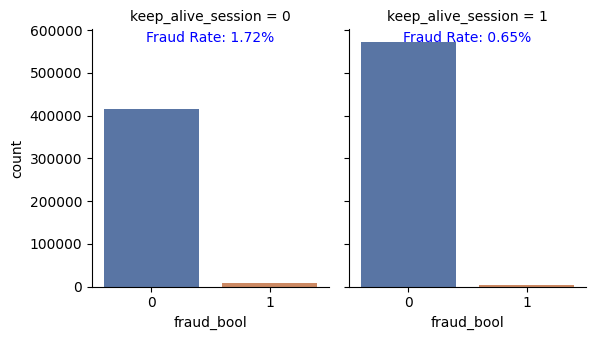

--------------------------------------------------
--------------------------------------------------
##### device_distinct_emails_8w Distribution #####


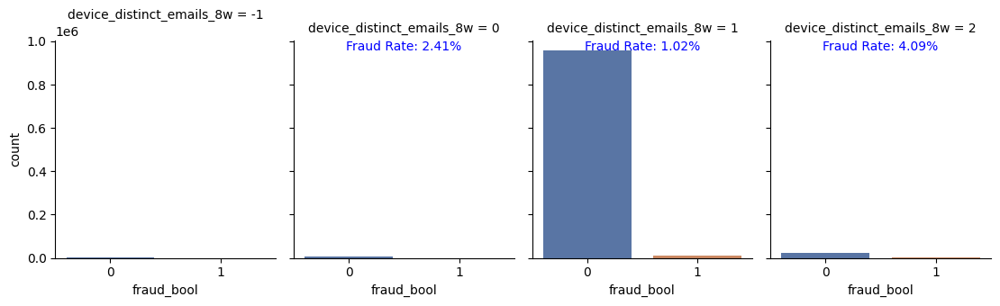

--------------------------------------------------
--------------------------------------------------
##### device_fraud_count Distribution #####


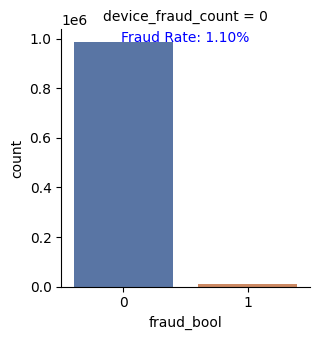

--------------------------------------------------


In [ ]:
# 뉴머리컬 데이터 분석 1 (=카테고리컬)
# foreign_request = [1]
# foreign_request는 1인 경우가 적은데 사기인 경우가 많다. (2.20%)
# keep_alive_session는 = [0]
# keep_alive_session는 0과 1이 비슷한 양이며 0에서 사기인 경우가 많다. (1.72%)
# device_distinct_emails_8w = [2, 0]
# device_distinct_emails_8w은 1인 경우가 대부분이다. 2와 0인 경우 사기 비율이 높다. (4.09%, 2.41%)
# 3개 컬럼 ['foreign_request', 'keep_alive_session', 'device_distinct_emails_8w']

for col in cols_numerical_under5:
    print(f'-'*50)
    print(f'##### {col} Distribution #####')
    ratio_1 = df[df["fraud_bool"] == 1].groupby(col).size() / df.groupby(col).size() * 100
    g = sns.catplot(x="fraud_bool", col=col, col_wrap=4, data=df,
                kind="count", height=3.5, aspect=.8,  palette='deep')
    fig.suptitle('sf')
    for ax in g.axes.flat:
        cat = ax.get_title().split(" = ")[-1]
        try:
            cat = int(cat) if cat.isdigit() else cat
        except ValueError:
            pass
        if cat in ratio_1:
            ax.text(0.5, 0.94,
                    f"Fraud Rate: {ratio_1[cat]:.2f}%",
                    ha="center", va="bottom", transform=ax.transAxes, fontsize=10, color="blue")
    plt.show()
    print(f'-'*50)

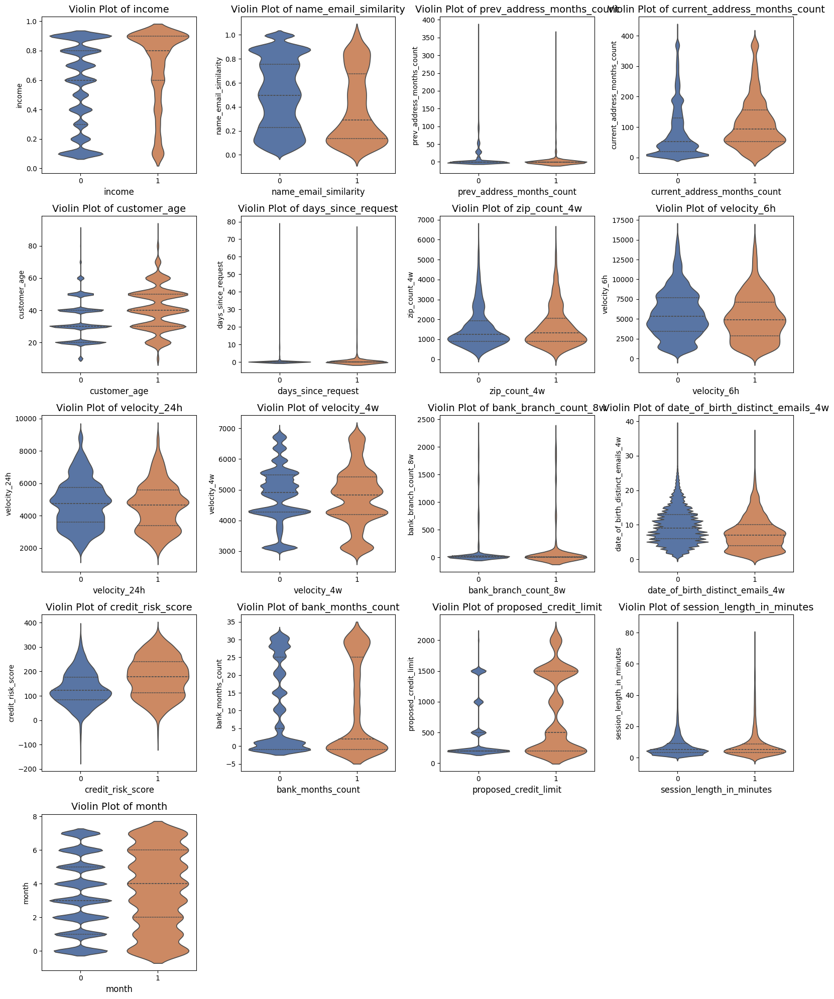

In [ ]:
# 뉴머리컬 데이터 분석 2
# 바이올린 플랏의 shape이 다른 feature 선별
# 큰 분포 차이 : ['income', 'name_email_similarity']
# 작은 분포 차이 : ['current_address_months_count', 'customer_age', 'credit_risk_score', 'proposed_credit_limit']

n_cols = 4
n_rows = (len(cols_numerical_over5) + n_cols - 1) // n_cols
fig, axs = plt.subplots(n_rows, n_cols, figsize=(16, 4 * n_rows))
axs = axs.flatten()
for i, col in enumerate(cols_numerical_over5):
    sns.violinplot(x='fraud_bool', y=col, data=df, scale='width', inner='quartile', ax=axs[i], palette='deep')
    axs[i].set_title(f'Violin Plot of {col}', fontsize=14)
    axs[i].set_xlabel(col, fontsize=12)
for j in range(i + 1, len(axs)):
        axs[j].axis('off')
plt.tight_layout()
plt.show()

<Figure size 800x640 with 0 Axes>

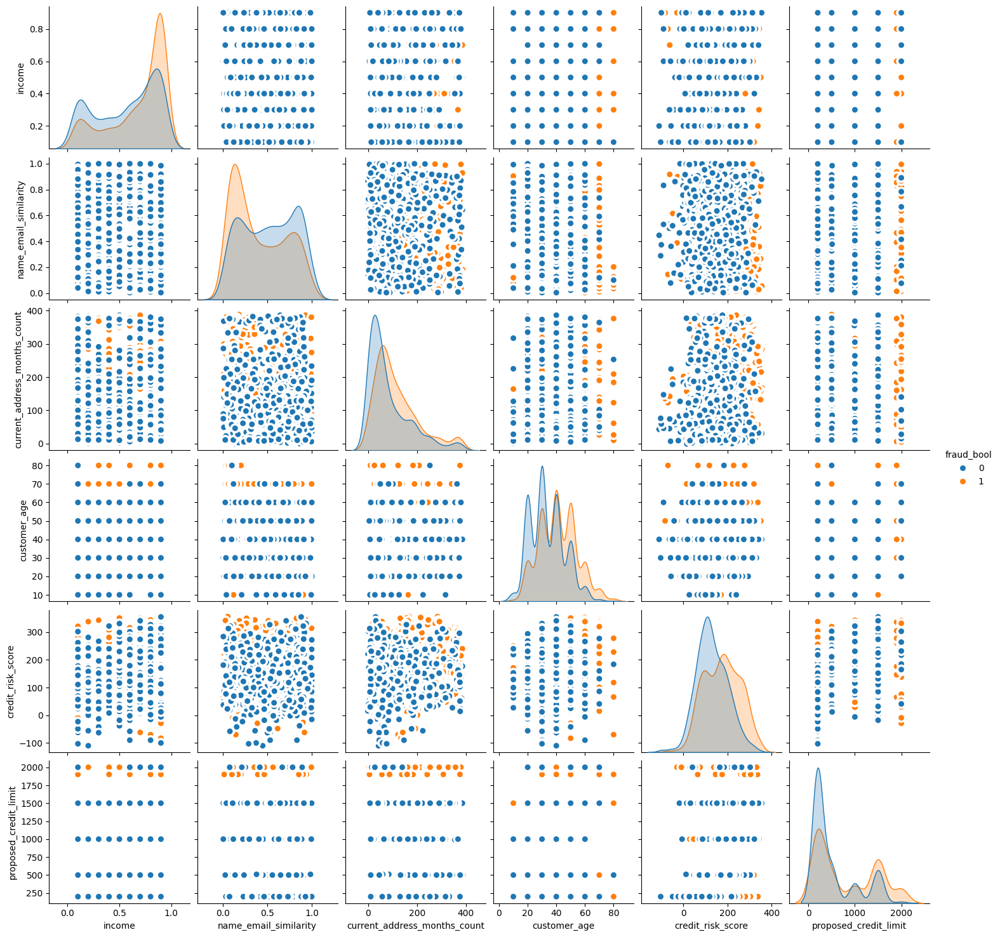

In [ ]:
# 뉴머리컬 데이터 분석 3
# 뉴머리컬 데이터만 넣고 분석

# 데이터 너무 많아서 샘플링 하고 스캐터링 한다.
# fraud 1과 0이 동일 비율이 되도록 샘플링 -> 2만개도 많아서 10%로 줄였다.

# income, name_email_similarity 2가지에 대하여 경향성이 있다.
# credit_risk_score, proposed_credit_limit 2가지도 약간의 경향성이 있다.

cols_temp = ['fraud_bool', 'income', 'name_email_similarity', 'current_address_months_count', 'customer_age', 'credit_risk_score', 'proposed_credit_limit']
df_temp = df.copy()
df_temp = df_temp[cols_temp]

df_fraud = df_temp[df_temp['fraud_bool'] == 1]
df_fraud = df_temp[df_temp['fraud_bool'] == 1].sample(n=len(df_fraud)//10, random_state=42)
df_non_fraud = df_temp[df_temp['fraud_bool'] == 0].sample(n=len(df_fraud), random_state=42)
df_sampled = pd.concat([df_fraud, df_non_fraud])

plt.figure(figsize=(10, 8), dpi=80)
sns.pairplot(df_sampled, kind="scatter", hue="fraud_bool", plot_kws=dict(s=80, edgecolor="white", linewidth=2.5))
plt.show()

### **Total**

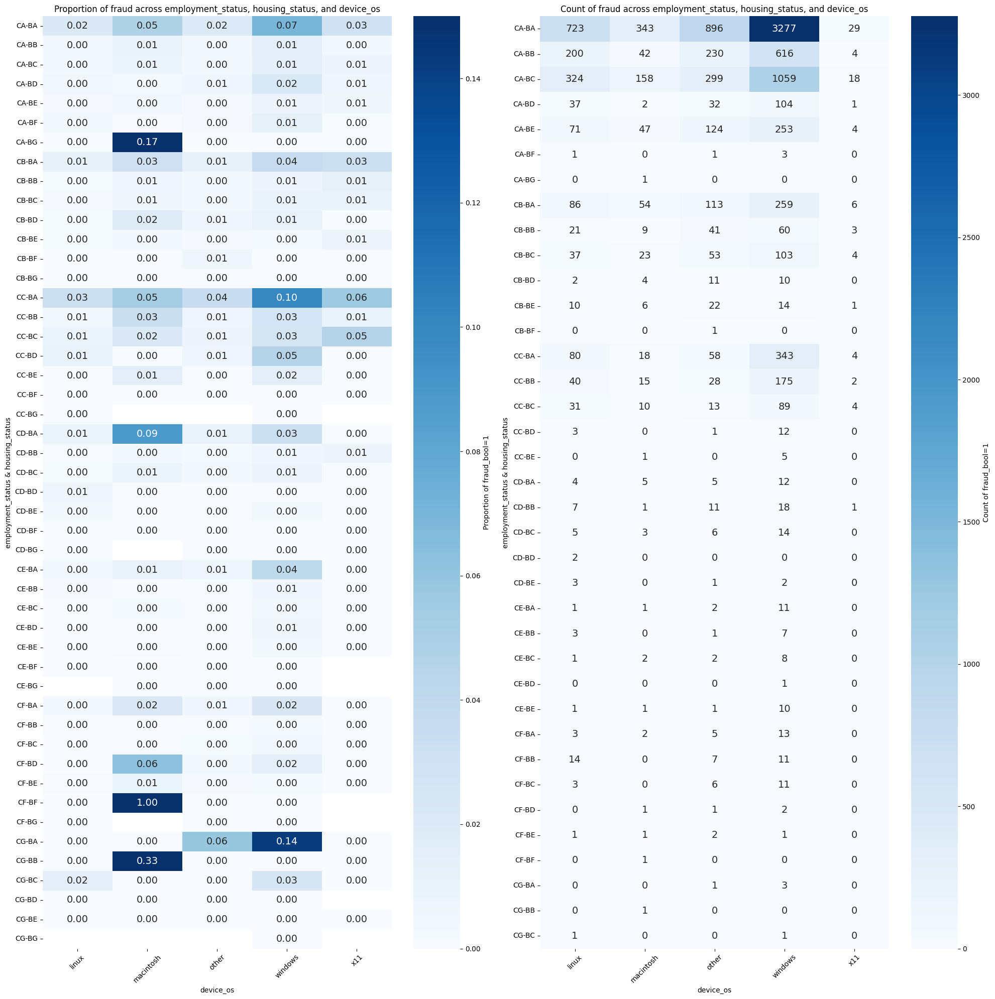

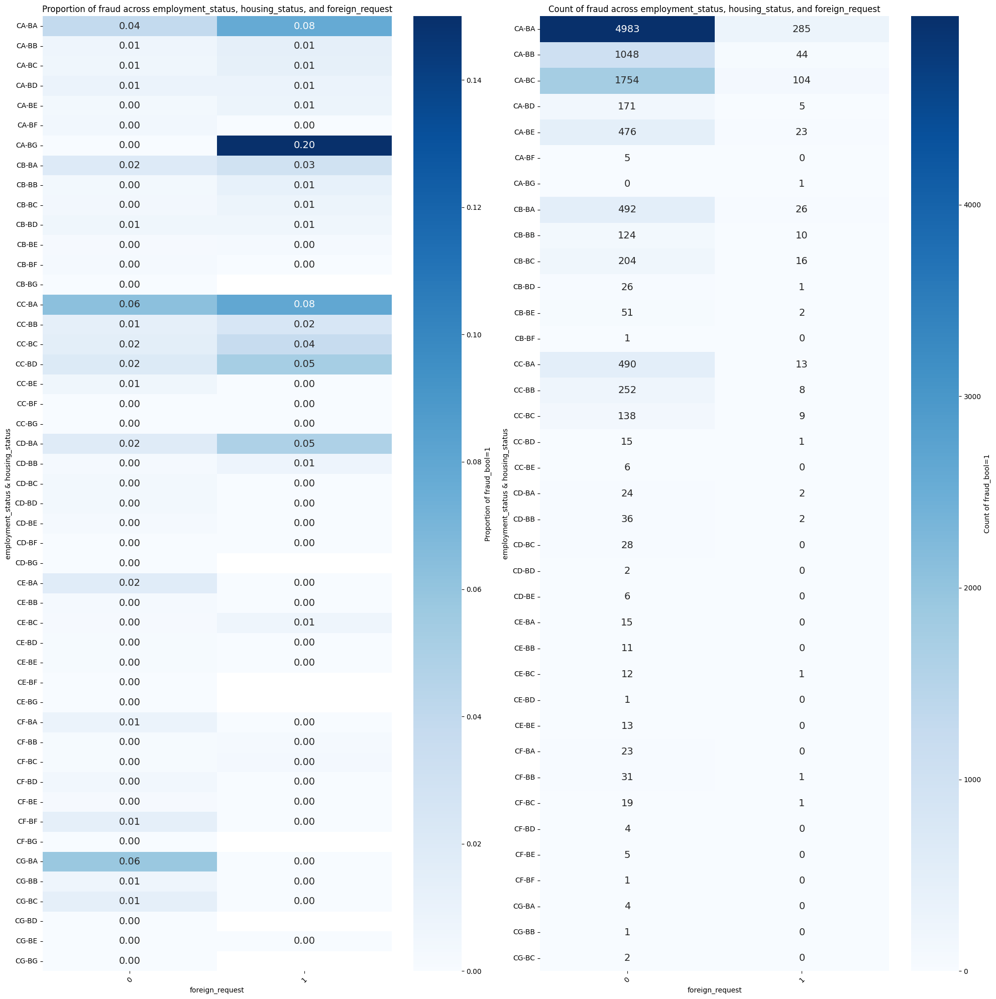

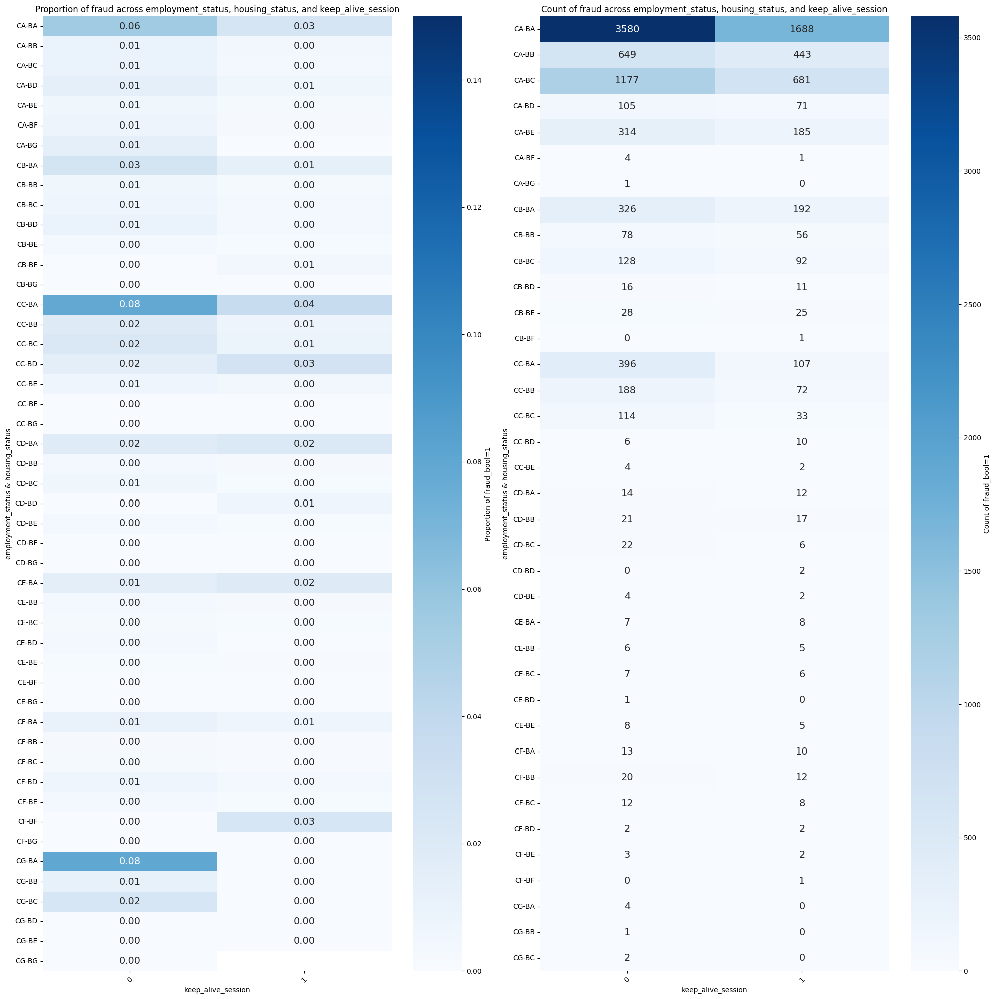

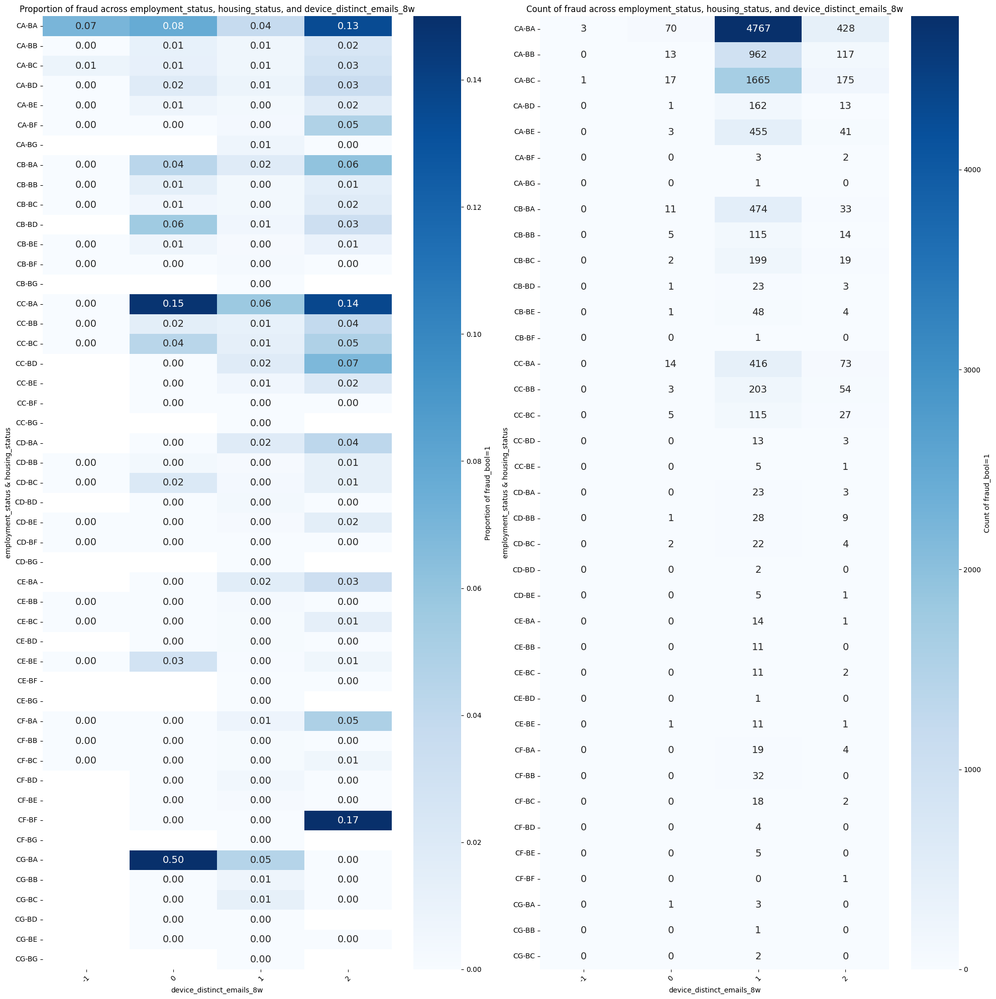

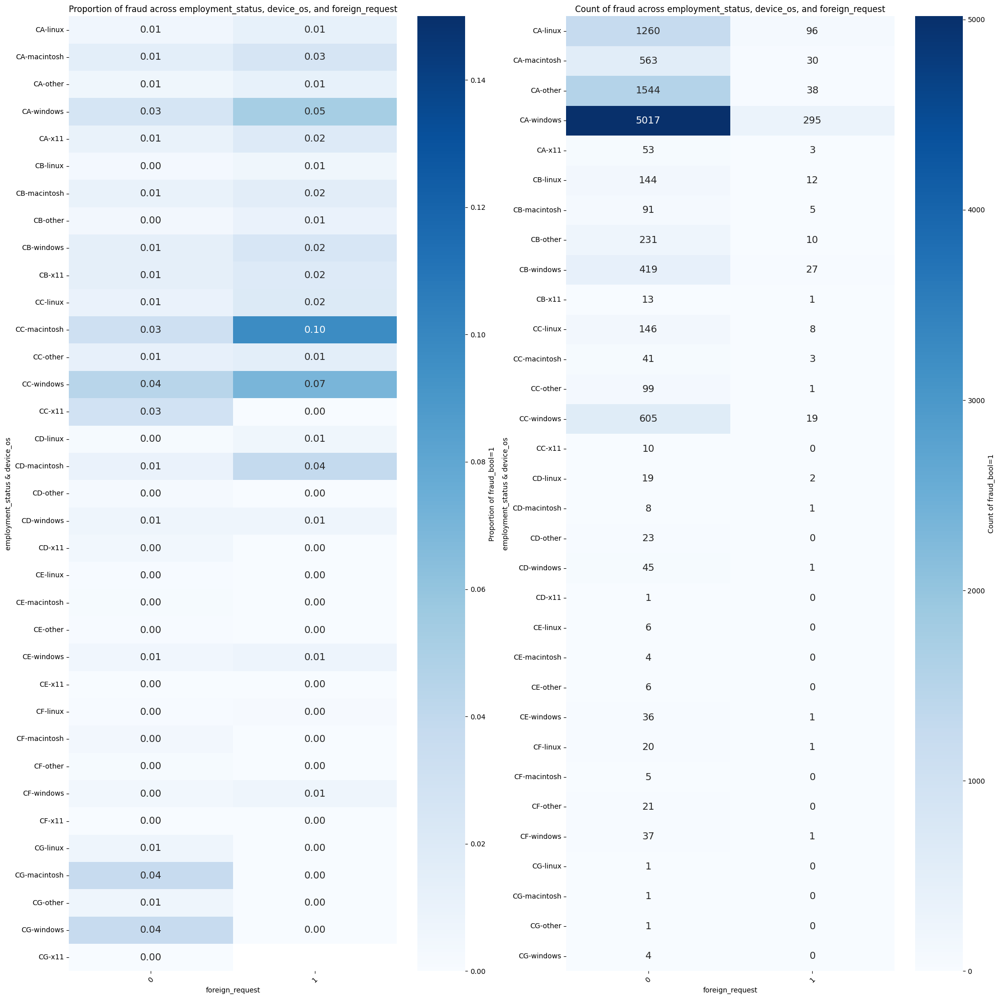

...

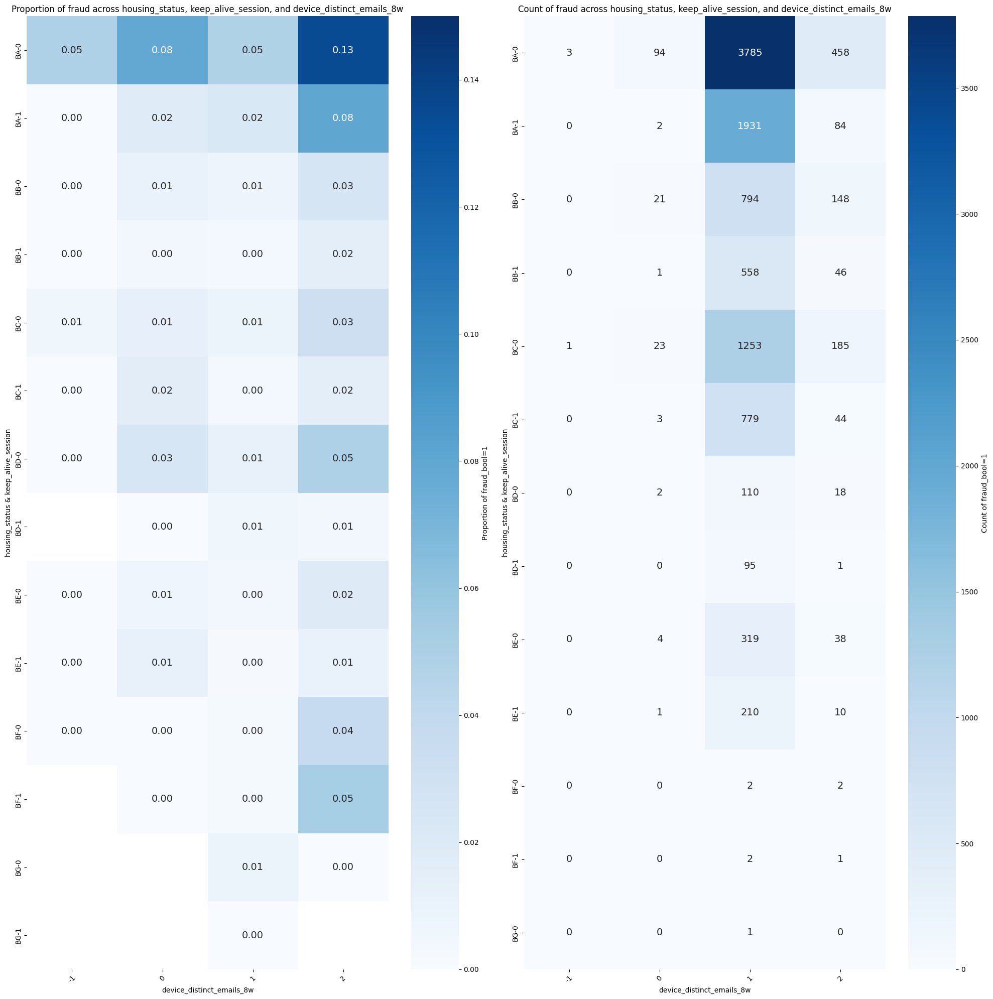

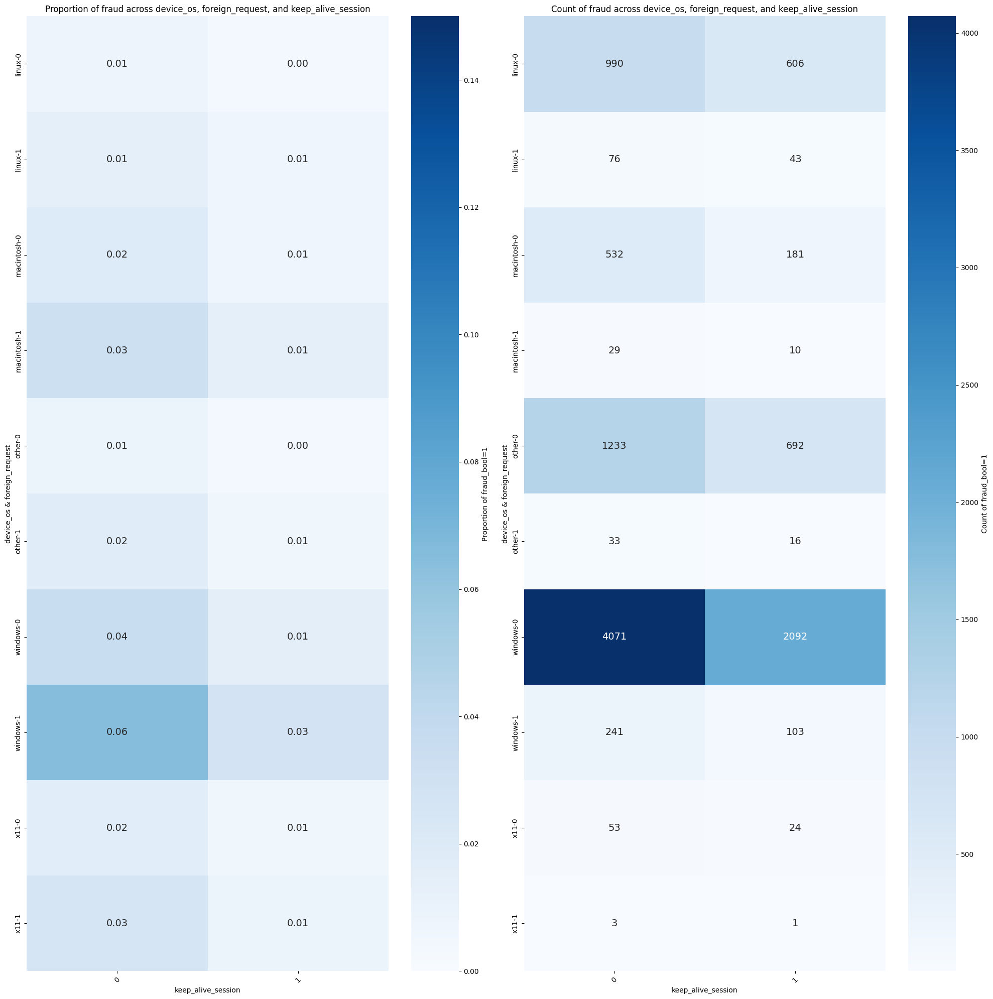

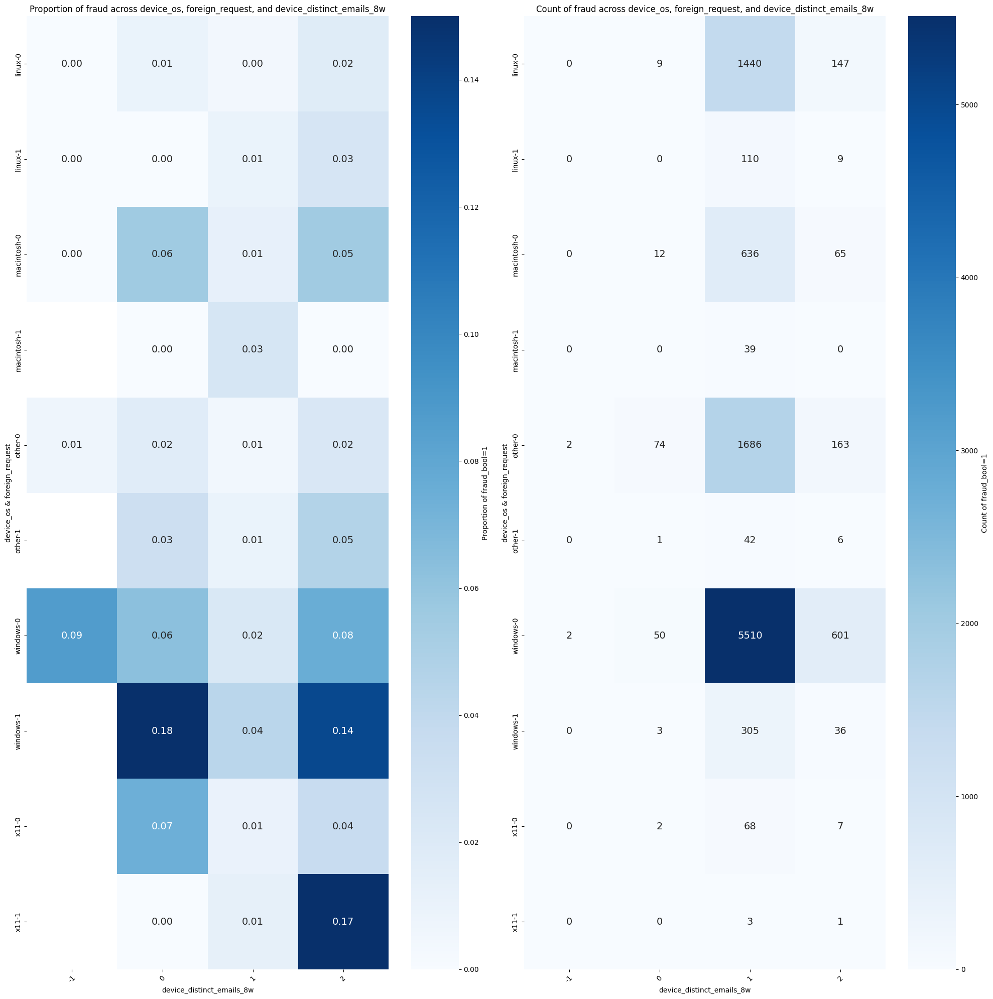

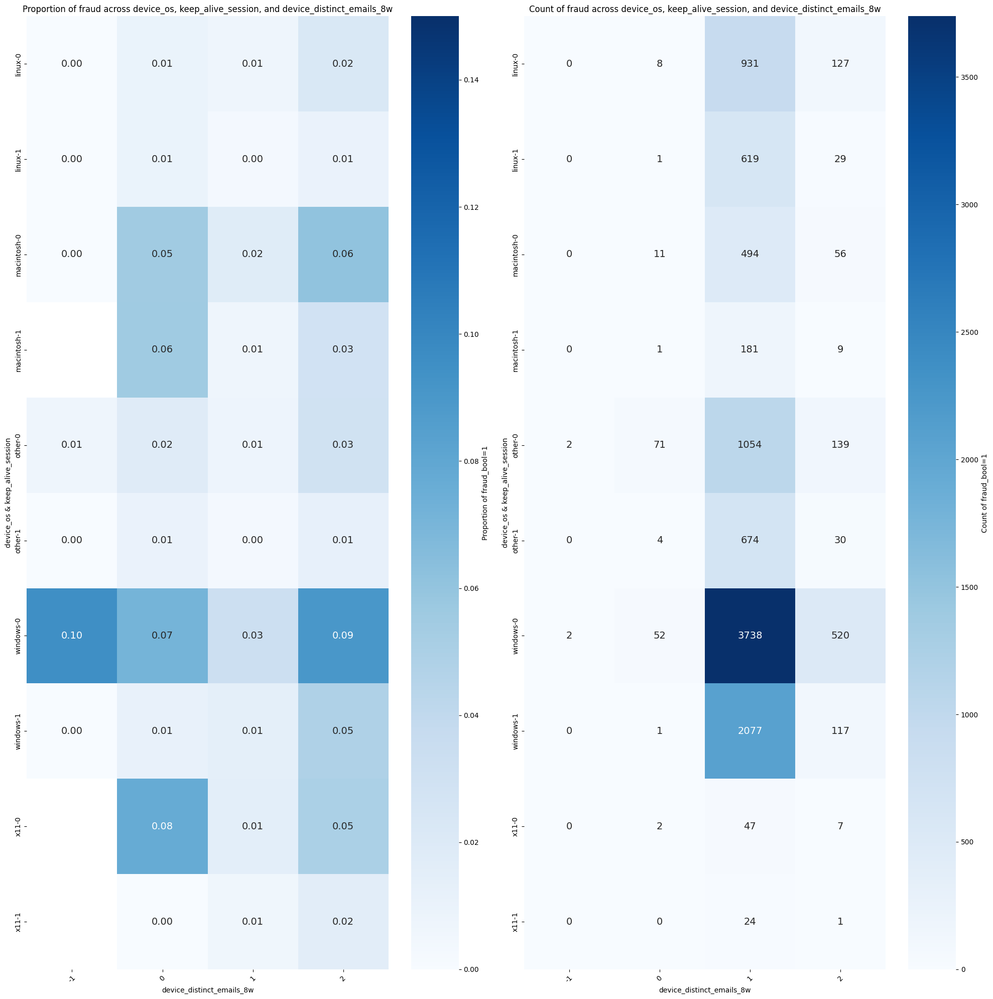

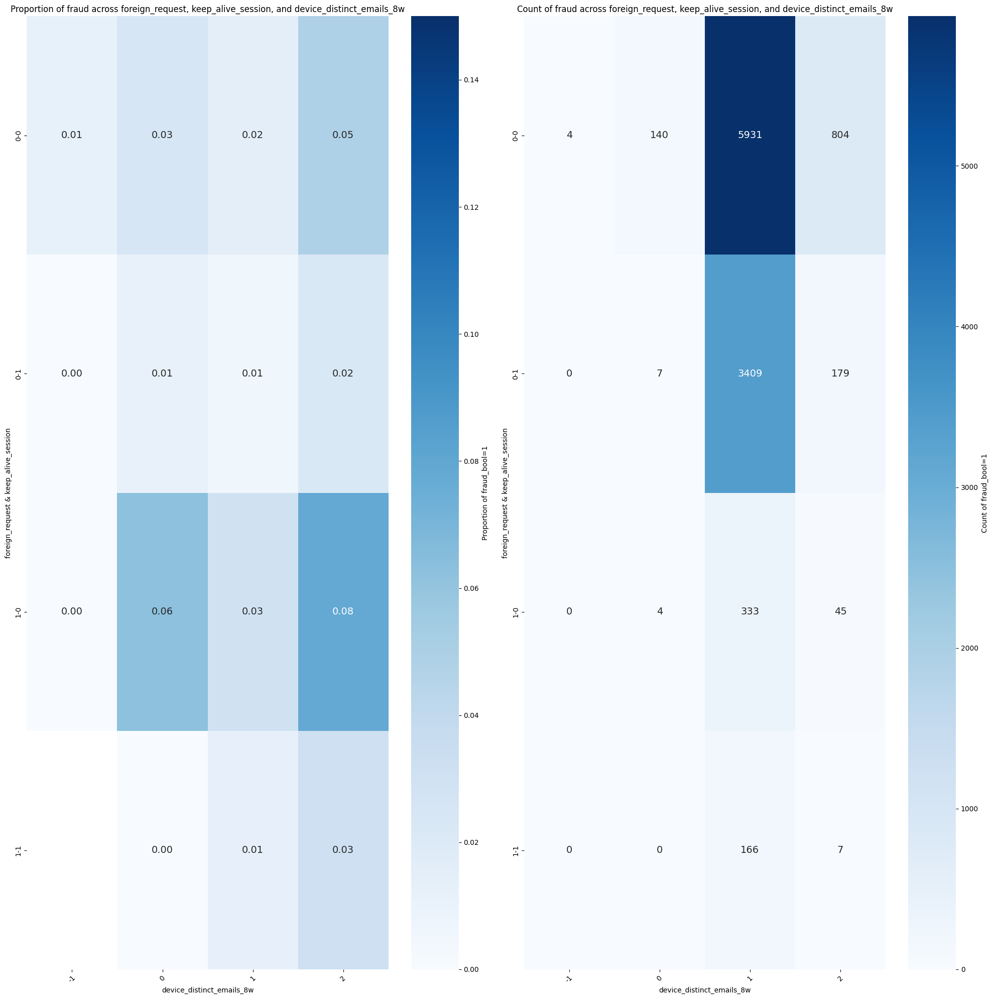

In [ ]:
# 통합 데이터 분석 1
# 카테고리컬만 활용해서 군집 추출
# 기준: 2000명 이상, 5% 이상
# ['housing', 'os', 'keep_alive'] -> ['BA', 'win', 0] : 9%, 2669
# ['housing', 'os', 'forign'] -> ['BA', 'win', 0] : 7%, 3713
# ['employment', 'housing', 'os'] -> ['CA', 'BA', 'win'] : 7%, 3277
# ['employment', 'housing', 'keep_alive'] -> ['CA', 'BA', 0] : 6%, 3580
# ['housing', 'os', 'dist_emails'] -> ['BA', 'win', 1] : 6%, 3543
# ['housing', 'forign', 'keep_alive'] -> ['BA', 0, 0] : 5%, 4103
# ['housing', 'keep_alive', 'dist_emails'] -> ['BA', 0, 1] : 5%, 4103


import itertools

cols_temp_cat1 = ['employment_status', 'housing_status', 'device_os']
cols_temp_cat2 = ['foreign_request', 'keep_alive_session', 'device_distinct_emails_8w']
cols_temp_cat = cols_temp_cat1 + cols_temp_cat2
cols_temp_num = ['income', 'name_email_similarity', 'current_address_months_count', 'customer_age', 'credit_risk_score', 'proposed_credit_limit']


for combo in itertools.combinations(cols_temp_cat, 3):
    col_A, col_B, col_C = combo

    grouped_mean = df.groupby([col_A, col_B, col_C])['fraud_bool'].mean().reset_index()
    pivot_df_mean = grouped_mean.pivot_table(values='fraud_bool', index=[col_A, col_B], columns=col_C)

    df_temp = df[df['fraud_bool'] == 1]
    grouped_count = df_temp.groupby([col_A, col_B, col_C])['fraud_bool'].count().reset_index(name='count')
    pivot_df_count = grouped_count.pivot_table(values='count', index=[col_A, col_B], columns=col_C, fill_value=0)
    pivot_df_count = np.round(pivot_df_count).astype(int)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))

    sns.heatmap(pivot_df_mean, annot=True, cmap="Blues", fmt=".2f", cbar_kws={'label': 'Proportion of fraud_bool=1'}, annot_kws={'size': 14}, ax=ax1, vmin=0, vmax=0.15)
    ax1.set_title(f"Proportion of fraud across {col_A}, {col_B}, and {col_C}")
    ax1.set_ylabel(f"{col_A} & {col_B}")
    ax1.set_xlabel(f"{col_C}")
    ax1.tick_params(axis='x', rotation=45)

    sns.heatmap(pivot_df_count, annot=True, cmap="Blues", fmt="d", cbar_kws={'label': 'Count of fraud_bool=1'}, annot_kws={'size': 14}, ax=ax2)
    ax2.set_title(f"Count of fraud across {col_A}, {col_B}, and {col_C}")
    ax2.set_ylabel(f"{col_A} & {col_B}")
    ax2.set_xlabel(f"{col_C}")
    ax2.tick_params(axis='x', rotation=45)

    plt.tight_layout()
    plt.show()

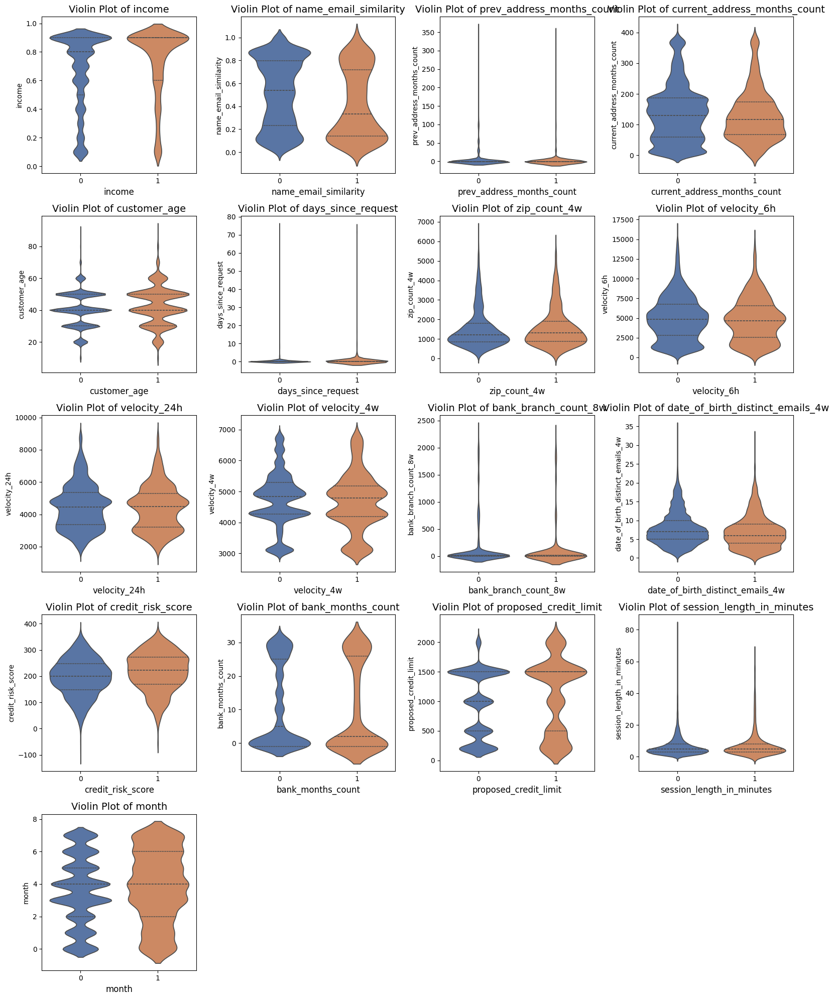

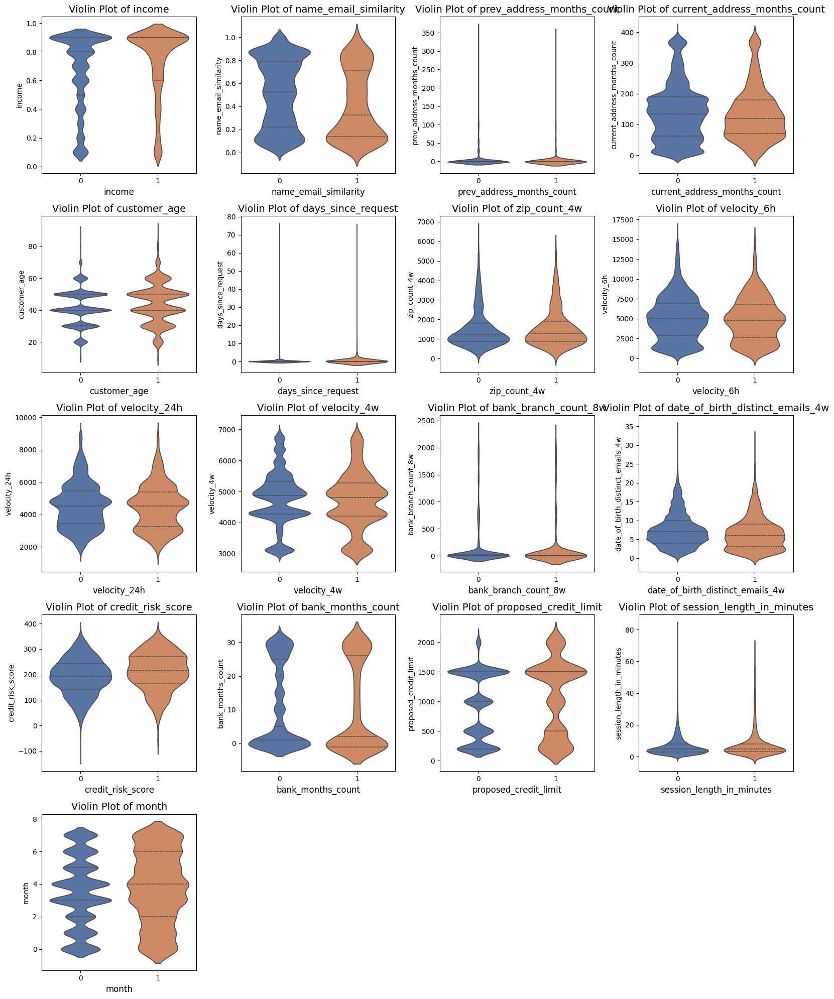

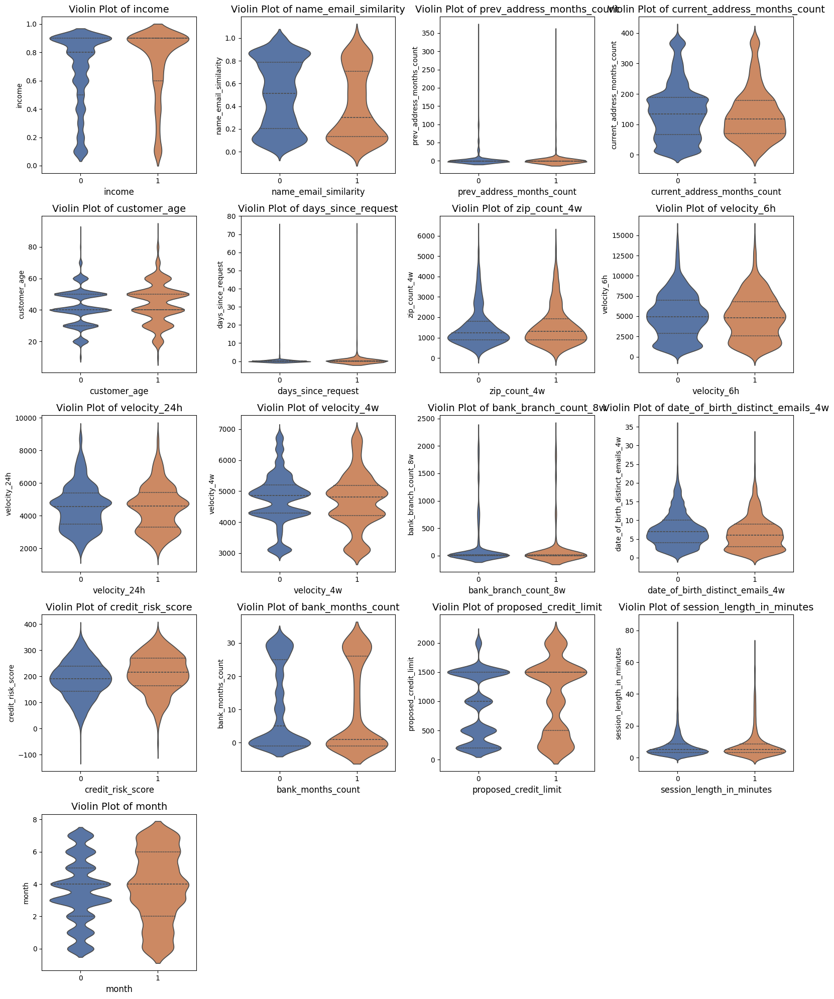

In [ ]:
# 통합 데이터 분석 2
# Top3 군집에 대한 numerical 분석
# ['employment', 'housing', 'os'] -> ['CA', 'BA', 'win'] : 7%, 3277
# ['housing', 'os', 'forign'] -> ['BA', 'win', 0] : 7%, 3713
# ['housing', 'os', 'keep_alive'] -> ['BA', 'win', 0] : 9%, 2669
# 각 군집별로 봤을 때 확률분포의 뚜렷한 유의차를 발견하기 힘들다.

df_temp = df.copy()
df_temp_1 = df_temp[(df_temp['employment_status'] == 'CA') & (df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
df_temp_2 = df_temp[(df_temp['foreign_request'] == 0) & (df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
df_temp_3 = df_temp[(df_temp['keep_alive_session'] == 0) & (df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]

for df_temp in [df_temp_1, df_temp_2, df_temp_3]:
  n_cols = 4
  n_rows = (len(cols_numerical_over5) + n_cols - 1) // n_cols
  fig, axs = plt.subplots(n_rows, n_cols, figsize=(16, 4 * n_rows))
  axs = axs.flatten()
  for i, col in enumerate(cols_numerical_over5):
      sns.violinplot(x='fraud_bool', y=col, data=df_temp, scale='width', inner='quartile', ax=axs[i], palette='deep')
      axs[i].set_title(f'Violin Plot of {col}', fontsize=14)
      axs[i].set_xlabel(col, fontsize=12)
  for j in range(i + 1, len(axs)):
          axs[j].axis('off')
  plt.tight_layout()
  plt.show()

In [ ]:
# 통합 데이터 분석 3
# 공통 군집 추출

fraud_counts = df['fraud_bool'].value_counts()
fraud_ratio = df['fraud_bool'].value_counts(normalize=True) * 100
fraud_summary = pd.DataFrame({'Count': fraud_counts, 'Ratio': fraud_ratio})
print(fraud_summary)

df_temp = df.copy()
df_temp_1 = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]

fraud_counts = df_temp_1['fraud_bool'].value_counts()
fraud_ratio = df_temp_1['fraud_bool'].value_counts(normalize=True) * 100
fraud_summary = pd.DataFrame({'Count': fraud_counts, 'Ratio': fraud_ratio})
print(fraud_summary)

             Count    Ratio
fraud_bool                 
0           988971  98.8971
1            11029   1.1029
            Count      Ratio
fraud_bool                  
0           54010  93.236431
1            3918   6.763569


### **⭐️ EDA 결론**
---

> **군집 이진 분류**
```
여러번에 걸쳐서 classification을 해야할 것으로 보인다.
일단 우리가 발견한 군집을 먼저 해보고자 한다.
```

> **군집 A의 컨디션**
```
('housing_status' == 'BA') and ('device_os' == 'windows')
```

> **군집 A의 장점**
```
분석을 통해 추출한 군집으로 상대적으로 fraud 비율이 높다. (6.7% 확률)
전체 fraud 11k 중에서 약 4k를 차지한다. (36% 포션)
```

## **Process02: 모델링**

### **모델 탐색**


In [ ]:
# 랜덤 포레스트 모델 A 학습

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier


df_temp = df.copy()
df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
X = df_temp.drop('fraud_bool', axis=1)
Y = df_temp['fraud_bool']

cols_drop = ['device_fraud_count']
for col in cols_drop:
    X.drop(col, axis=1, inplace=True)

# cols_date = ['date_1', 'date_2']
# for col in cols_date:
#     X[f'week_{col}'] = X[col].dt.dayofweek
#     X[f'month_{col}'] = X[col].dt.month
#     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

for column in X.columns:
    if X[column].dtype == object:
        le = LabelEncoder()
        X[column] = le.fit_transform(X[column])

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)
model = RandomForestClassifier(random_state=42)
model.fit(x_train, y_train)

RandomForestClassifier(random_state=42)

In [ ]:
# 랜덤 포레스트 정확도

from sklearn.metrics import accuracy_score


y_pred_test = model.predict(x_test)
accuracy = accuracy_score(y_test, y_pred_test)
print(f"Accuracy: {accuracy*100:.2f}%")

Accuracy: 93.17%


In [ ]:
# 트레인 데이터셋 리포트

from sklearn.metrics import classification_report


y_pred_train = model.predict(x_train)
print(classification_report(y_train, y_pred_train))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     43208
           1       1.00      1.00      1.00      3134

    accuracy                           1.00     46342
   macro avg       1.00      1.00      1.00     46342
weighted avg       1.00      1.00      1.00     46342



In [ ]:
# 테스트 데이터셋 리포트
# 1에 대한 f-1을 봐야하는데 너무 낮다.

y_pred_test = model.predict(x_test)
print(classification_report(y_test, y_pred_test))

              precision    recall  f1-score   support

           0       0.93      1.00      0.96     10802
           1       0.29      0.01      0.01       784

    accuracy                           0.93     11586
   macro avg       0.61      0.50      0.49     11586
weighted avg       0.89      0.93      0.90     11586



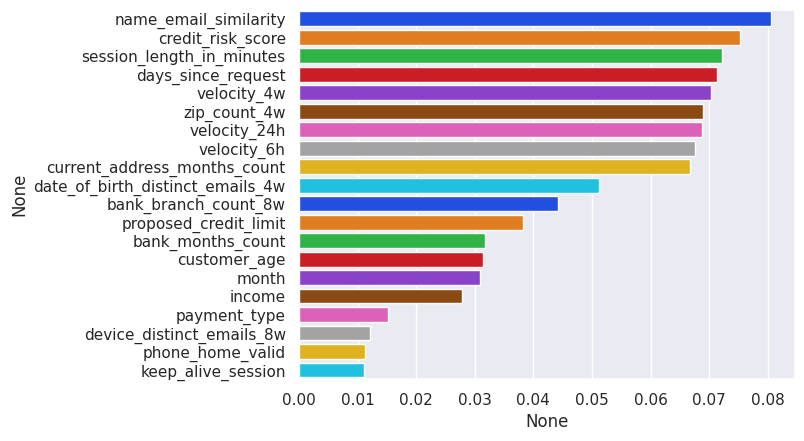

In [ ]:
# feature importance
# top3: name_email_similarity, credit_risk_score, days_since_request

sns.set(style="darkgrid")
palette = sns.color_palette("bright", 20)
ftr_importances_values = model.feature_importances_
ftr_importances = pd.Series(ftr_importances_values, index = x_train.columns)
ftr_top20 = ftr_importances.sort_values(ascending=False)[:20]
sns.barplot(x=ftr_top20, y=ftr_top20.index, palette=palette)
plt.show()

Comp 1 config: ['0.12', '-0.02', '0.01', '-0.07', '-0.07', '-0.01', '0.00', '-0.26', '-0.36', '-0.44', '-0.52', '-0.06', '-0.10', '-0.08', '0.10', '-0.02', '-0.00', '-0.04', '0.08', '-0.04', '0.03', '-0.02', '-0.01', '0.00', '-0.07', '-0.00', '-0.02', '-0.06', '0.52']
Comp 1 ratio: 0.11
Comp 2 config: ['-0.06', '0.01', '-0.21', '0.38', '0.48', '-0.07', '-0.10', '-0.06', '0.00', '-0.01', '-0.06', '0.08', '-0.47', '0.24', '0.06', '-0.06', '-0.00', '0.37', '-0.30', '0.06', '0.11', '0.03', '-0.06', '0.02', '0.03', '-0.00', '-0.01', '0.02', '0.05']
Comp 2 ratio: 0.07


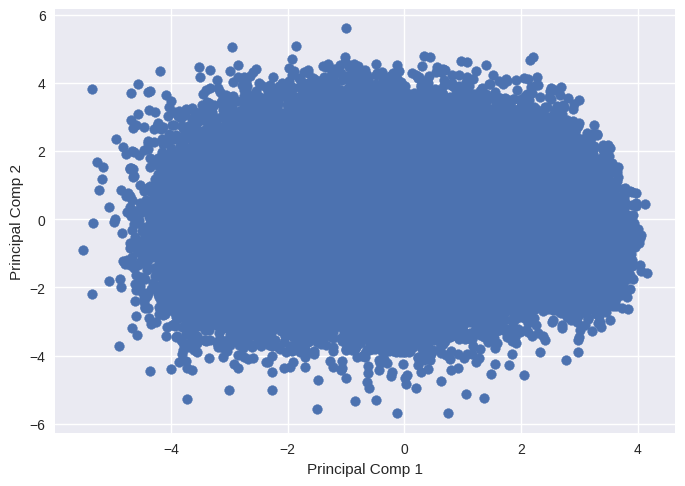

In [ ]:
# PCA 차원축소
# PCA가 너무 낮다.
# 그래프를 보면 분산에 대한 해석력이 전혀 없다.
# top3 feature를 지우고 진행해본다.

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

N = 2
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
pca = PCA(n_components=N)

X_pca = pca.fit_transform(X_scaled)
for i in range(N):
    component_str = [f'{value:.2f}' for value in pca.components_[i]]
    ratio_str = f'{pca.explained_variance_ratio_[i]:.2f}'
    print(f'Comp {i+1} config: {component_str}')
    print(f'Comp {i+1} ratio: {ratio_str}')

plt.style.use(['seaborn-v0_8'])
plt.scatter(X_pca[:, 0], X_pca[:, 1])
plt.xlabel('Principal Comp 1')
plt.ylabel('Principal Comp 2')
plt.show()

In [ ]:
# XGBoost 모델 B 학습
# ref: https://dacon.io/competitions/official/236355/codeshare/12074

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb


df_temp = df.copy()
df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
X = df_temp.drop('fraud_bool', axis=1)
Y = df_temp['fraud_bool']

cols_drop = ['device_fraud_count']
for col in cols_drop:
    X.drop(col, axis=1, inplace=True)

# cols_date = ['date_1', 'date_2']
# for col in cols_date:
#     X[f'week_{col}'] = X[col].dt.dayofweek
#     X[f'month_{col}'] = X[col].dt.month
#     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

for column in X.columns:
    if X[column].dtype == object:
        le = LabelEncoder()
        X[column] = le.fit_transform(X[column])

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)
# model = RandomForestClassifier(random_state=42)
model = xgb.XGBClassifier(objective='multi:softmax', num_class=len(Y.unique()), random_state=42)
model.fit(x_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None, num_class=2,
              num_parallel_tree=None, ...)

In [ ]:
# 데이터셋 별 리포트
# 트레이닝을 보면 1에 대한 f1이 0.65 이다.
# 조금 더 학습할 수 있을 것으로 보인다.
# 1에 대한 f1이 0.14 로 랜덤 포레스트보다는 좋다.

from sklearn.metrics import classification_report


y_pred_train = model.predict(x_train)
print(classification_report(y_train, y_pred_train))

y_pred_test = model.predict(x_test)
print(classification_report(y_test, y_pred_test))

              precision    recall  f1-score   support

           0       0.96      1.00      0.98     43208
           1       0.98      0.48      0.65      3134

    accuracy                           0.96     46342
   macro avg       0.97      0.74      0.82     46342
weighted avg       0.97      0.96      0.96     46342

              precision    recall  f1-score   support

           0       0.94      0.99      0.96     10802
           1       0.38      0.07      0.11       784

    accuracy                           0.93     11586
   macro avg       0.66      0.53      0.54     11586
weighted avg       0.90      0.93      0.91     11586



In [ ]:
# LightGBM 모델 C 학습
# ref: https://dacon.io/competitions/official/235871/codeshare/4555

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import lightgbm as lgb

LEARNING_RATE = 0.02
NUM_BOOST_ROUND = 500

params = {
  "learning_rate": LEARNING_RATE,
  "boosting_type": 'gbdt',
  "objective": "binary",
  'metric': 'binary_logloss',
  "num_leaves": 16,
  "max_depth": 6,
  "max_bin": 256,
  "feature_fraction": 0.5,
  "verbosity": -1,
  "drop_rate": 0.1,
  "is_unbalance": False,
  "max_drop": 50,
  "min_child_samples": 0,
  "min_child_weight": 0.01,
  "min_split_gain": 0,
  "subsample": 0.9,
  #  "early_stopping_rounds": 200,
  #  "device_type": 'gpu'
}

df_temp = df.copy()
df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
X = df_temp.drop('fraud_bool', axis=1)
Y = df_temp['fraud_bool']

cols_drop = ['device_fraud_count']
for col in cols_drop:
    X.drop(col, axis=1, inplace=True)

# cols_date = ['date_1', 'date_2']
# for col in cols_date:
#     X[f'week_{col}'] = X[col].dt.dayofweek
#     X[f'month_{col}'] = X[col].dt.month
#     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

for column in X.columns:
    if X[column].dtype == object:
        le = LabelEncoder()
        X[column] = le.fit_transform(X[column])

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)
ds_train = lgb.Dataset (x_train, label = y_train)

model = lgb.train(params, ds_train, NUM_BOOST_ROUND)

In [ ]:
# 데이터셋 별 리포트
# 트레이닝을 보면 1에 대한 f1이 0.34 이다.
# 조금 더 학습할 수 있을 것으로 보인다.
# 1에 대한 f1이 0.23 으로 XGBoost 보다도 좋다.

from sklearn.metrics import classification_report

y_pred_train = model.predict(x_train)
for i in range(0, len(y_pred_train)):
  if y_pred_train[i] >=.3:
    y_pred_train[i] = 1
  else:
    y_pred_train[i] = 0
print(classification_report(y_train, y_pred_train))


y_pred_test = model.predict(x_test)
for i in range(0,len(y_pred_test)):
  if y_pred_test[i] >=.3:
    y_pred_test[i] = 1
  else:
    y_pred_test[i] = 0
print(classification_report(y_test, y_pred_test))

              precision    recall  f1-score   support

           0       0.95      0.99      0.97     43208
           1       0.59      0.23      0.33      3134

    accuracy                           0.94     46342
   macro avg       0.77      0.61      0.65     46342
weighted avg       0.92      0.94      0.92     46342

              precision    recall  f1-score   support

           0       0.94      0.99      0.96     10802
           1       0.47      0.17      0.25       784

    accuracy                           0.93     11586
   macro avg       0.70      0.58      0.61     11586
weighted avg       0.91      0.93      0.92     11586



In [ ]:
!pip install -q pytorch-tabnet==3.1.1

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.5/887.5 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.1/317.1 MB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.0/21.0 MB 70.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 849.3/849.3 kB 39.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 557.1/557.1 MB 3.1 MB/s eta 0:00:00
ERROR: Operation cancelled by user
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/base_command.py", line 179, in exc_logging_wrapper
    status = run_func(*args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/req_command.py", line 67, in wrapper
    return func(self, options, args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/install.py", line 377, in run
    requirement_set = resolver.resolve(
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/resolution/resolvelib/resolver.py", line 

In [ ]:
# TabNet 모델 D 학습
# ref: https://dacon.io/competitions/official/236109/codeshare/8422
# 트레이닝을 보면 1에 대한 f1이 0.49 이다.
# epoch 3에서 얼리스탑 당한거 보면 lr을 수정할 필요가 있다.
# 1에 대한 f1이 0.49 으로 LightGBM 보다도 좋다.

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from pytorch_tabnet.tab_model  import TabNetClassifier
from pytorch_tabnet.metrics import Metric
from sklearn.metrics import f1_score
import torch

LEARNING_RATE = 0.02
EPOCH = 100
BATCH_SIZE = 64
NUM_WORKERS = 1

df_temp = df.copy()
df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
X = df_temp.drop('fraud_bool', axis=1)
Y = df_temp['fraud_bool']

cols_drop = ['device_fraud_count']
for col in cols_drop:
    X.drop(col, axis=1, inplace=True)

# cols_date = ['date_1', 'date_2']
# for col in cols_date:
#     X[f'week_{col}'] = X[col].dt.dayofweek
#     X[f'month_{col}'] = X[col].dt.month
#     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

cat_dims = []
cat_idxs = []

for column in X.columns:
    if X[column].dtype == object:
        le = LabelEncoder()
        X[column] = le.fit_transform(X[column])

        cat_dims.append(len(le.classes_))
        cat_idxs.append(X.columns.get_loc(column))

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)

x_train_tab = x_train.values
y_train_tab = y_train.values
x_test_tab = x_test.values
y_test_tab = y_test.values

tabnet_model = TabNetClassifier(cat_idxs=cat_idxs,
                       cat_dims=cat_dims,
                       cat_emb_dim=40,
                       optimizer_fn=torch.optim.Adam,
                       optimizer_params=dict(lr=2e-3)
                      )

class F1_Score(Metric):
    def __init__(self):
        self._name = "F1_score"
        self._maximize = True

    def __call__(self, y_true, y_score):
        y_pred = np.argmax(y_score, axis=1)
        score = f1_score(y_true, y_pred, average='macro')
        return score

tabnet_model.fit(
    X_train=x_train_tab, y_train=y_train_tab,
    eval_set=[(x_train_tab, y_train_tab), (x_test_tab, y_test_tab)],
    eval_name=['train', 'test'],
    eval_metric=['logloss','F1_score'],
    max_epochs=EPOCH , patience=2,
    batch_size=BATCH_SIZE,
    virtual_batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    drop_last=False,
)

Device used : cpu
epoch 0  | loss: 0.29118 | train_logloss: 0.25095 | train_F1_score: 0.48311 | test_logloss: 0.25012 | test_F1_score: 0.48249 |  0:00:58s
epoch 1  | loss: 0.24924 | train_logloss: 0.27604 | train_F1_score: 0.4825  | test_logloss: 0.27534 | test_F1_score: 0.48249 |  0:01:35s
epoch 2  | loss: 0.24194 | train_logloss: 0.25618 | train_F1_score: 0.4825  | test_logloss: 0.25654 | test_F1_score: 0.48249 |  0:02:13s

Early stopping occurred at epoch 2 with best_epoch = 0 and best_test_F1_score = 0.48249
Best weights from best epoch are automatically used!


In [ ]:
# # 랜덤 포레스트 모델 그리드 서치 A' 학습
# # f1 score가 개선되지 않는다.

# from sklearn.model_selection import train_test_split
# from sklearn.preprocessing import LabelEncoder
# from sklearn.ensemble import RandomForestClassifier
# from sklearn.model_selection import GridSearchCV


# df_temp = df.copy()
# df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
# X = df_temp.drop('fraud_bool', axis=1)
# Y = df_temp['fraud_bool']

# cols_drop = ['device_fraud_count']
# for col in cols_drop:
#     X.drop(col, axis=1, inplace=True)

# # cols_date = ['date_1', 'date_2']
# # for col in cols_date:
# #     X[f'week_{col}'] = X[col].dt.dayofweek
# #     X[f'month_{col}'] = X[col].dt.month
# #     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

# for column in X.columns:
#     if X[column].dtype == object:
#         le = LabelEncoder()
#         X[column] = le.fit_transform(X[column])

# x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)
# model = RandomForestClassifier(random_state=42)
# model.fit(x_train, y_train)

# param_grid = {
#   'n_estimators': [100, 200],  # 트리 개수
#   'max_depth': [None, 10],  # 트리의 최대 깊이
#   'min_samples_split': [2, 5],  # 노드를 분할하기 위한 최소 샘플 수
#   'min_samples_leaf': [1, 2],  # 리프 노드의 최소 샘플 수
# }

# grid_cv = GridSearchCV(model, param_grid, cv=3, n_jobs=-1, scoring='f1')
# grid_cv.fit(x_train, y_train)
# print(f'The best params: {grid_cv.best_params_}')
# print(f'The best score: {grid_cv.best_score_:.4f}')

In [ ]:
# LightGBM 모델 샘플링하여 C' 학습
# test name: (pre) (rec) (f1)
# Not Fraud 15%: 0.44      0.53     0.48
# Not Fraud 10%: 0.45      0.63     0.53


from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import lightgbm as lgb

params = {}
params ['learning_rate'] = 0.02
params ['boosting_type'] = 'gbdt'
params ['objective'] = 'binary'
params ['metric'] = 'binary_logloss'
params ['max_depth'] = 2
params ['num_leaves'] = 4
params ['seed'] = 23456

df_temp = df.copy()
df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]

# 샘플링하는 부분
# frac 조절 시 비율 조절 된다.
fraud_data = df_temp[df_temp['fraud_bool']== 1]
non_fraud_data = df_temp[df_temp['fraud_bool'] == 0].sample(frac = 0.1, random_state = 42)
df_temp = pd.concat([fraud_data , non_fraud_data], ignore_index = True)
print(df_temp['fraud_bool'].value_counts())

X = df_temp.drop('fraud_bool', axis=1)
Y = df_temp['fraud_bool']

cols_drop = ['device_fraud_count']
for col in cols_drop:
    X.drop(col, axis=1, inplace=True)

# cols_date = ['date_1', 'date_2']
# for col in cols_date:
#     X[f'week_{col}'] = X[col].dt.dayofweek
#     X[f'month_{col}'] = X[col].dt.month
#     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

for column in X.columns:
    if X[column].dtype == object:
        le = LabelEncoder()
        X[column] = le.fit_transform(X[column])

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)

model = lgb.LGBMClassifier(**params, n_estimators=500)
model.fit(x_train, y_train)


y_pred_train = model.predict(x_train)

for i in range(0, len(y_pred_train)):
  if y_pred_train[i] >=.2:
    y_pred_train[i] = 1
  else:
    y_pred_train[i] = 0

y_pred_test = model.predict(x_test)
for i in range(0,len(y_pred_test)):
  if y_pred_test[i] >=.2:
    y_pred_test[i] = 1
  else:
    y_pred_test[i] = 0

print(classification_report(y_train, y_pred_train))
print(classification_report(y_test, y_pred_test))

fraud_bool
0    5401
1    3918
Name: count, dtype: int64
              precision    recall  f1-score   support

           0       0.95      0.25      0.40      4321
           1       0.49      0.98      0.65      3134

    accuracy                           0.56      7455
   macro avg       0.72      0.62      0.53      7455
weighted avg       0.75      0.56      0.51      7455

              precision    recall  f1-score   support

           0       0.88      0.25      0.40      1080
           1       0.48      0.95      0.64       784

    accuracy                           0.55      1864
   macro avg       0.68      0.60      0.52      1864
weighted avg       0.71      0.55      0.50      1864



### **⭐️ 모델탐색 결론**
---

> **TabNet**
```
여러가지 모델 중에서 TabNet의 성능이 가장 좋았다.
TabNet에 대하여 파라미터를 조절해 develop 해본다.
(TabNet 자료조사 -> 모델링하여 best f1 score 만들기)
```

> **샘플링**
```
20%, 15%, 10% 샘플링하여 학습할 경우 성능이 좋아졌다.
outlier가 제거되는 효과가 있다는 가설을 수립했다.
최종 TabNet develop 후 샘플링 학습을 실험해본다.
```

### **TabNet develop**

#### **TabNet 논문 리뷰**

```
[Abstract]
tabular 형식 데이터에 대한 고성능의 해석 가능한 아키텍쳐
Sequential Attention 사용
```

```
[트리 기반 모델이 우세한 원인]
1. 트리는 초평면(hyperplane) 경계의 manifolds에서 효율적이다.
 -> (=트리는 비선형 경계를 생성하는 데 유리하다.)
 -> 공간을 분할하며 구역화를 하기 때문이다.
2. 해석할 수 있는 모델이며 분석 메서드가 많다.
3. 학습속도가 빠르다.
4. DNN 모델들은 tabular에 특화해서 만들어지지 않았다.
```

```
[TabNet overview]
전처리 과정 없이 raw tabular data를 input 가능하다.
옵티마이저를 사용하는 end-to-end 모델이다.
sequential attention을 사용해 해석이 가능하게 한다.
-> 각 decision에서 어떤 feature를 사용했는지 알 수 있다.
-> feature importance를 구할 수 있다.
-> feature가 어떻게 결합되는지 알 수 있다.
마스킹 베이스의 SSL을 시도했다.
```

```
[Architecture]
인코더 디코더 구조 이다.
인코더: feature TR와 attentive TR가 반복되는 구조 이다.
디코더: feature TR만 있는 구조 이다.
Feature TR: FC-BN-GLU 반복, Residual 사용
Attentive TR: FC-BN-SparseMax

인코더에서 중간중간에 값을 뽑아내서 추후 해석에 사용한다.
```

```
[결론]
하이퍼 파라미터 바꿔가며 학습한다.

dim, lr, batch
optimizer_fn, scheduler_fn
n_d, n_a: 디코더(n_d)와 인코더(n_a)의 피처 차원 수

k-fold 사용

내장된 분석 메서드를 사용해본다.
```

#### **하이퍼 파라미터 최적화**

In [ ]:
# TabNet develop 1
# ref: https://www.kaggle.com/code/datafan07/optiver-volatility-predictions-using-tabnet/notebook#Setting-Loss-and-Metrics
# 하이퍼 파라미터 최적화

# [cat_dim]
# 원래 디멘션의 배수로 하니깐 잘된다.
# cat_dim = 80, lr = 2e-3, batch = 64: 0.482
# cat_dim = 50, lr = 2e-3, batch = 64: 0.573
# cat_dim = 40, lr = 2e-3, batch = 64: 0.561
# cat_dim = 20, lr = 2e-3, batch = 64: 0.490
# cat_dim = 10, lr = 2e-3, batch = 64: 0.583
# cat_dim = 5, lr = 2e-3, batch = 64: 0.534
# 배수가 아닐 경우 과적합 된다.
# cat_dim = 32, lr = 2e-3, batch = 64: 0.482
# cat_dim = 16, lr = 2e-3, batch = 64: 0.482
# cat_dim = 8, lr = 2e-3, batch = 64: 0.484

# [lr]
# cat_dim = 10, lr = 3e-3, batch = 64: 0.497
# cat_dim = 10, lr = 2e-3, batch = 64: 0.583
# cat_dim = 10, lr = 1e-3, batch = 64: 0.482

# [batch]
# cat_dim = 10, lr = 7e-2, batch = 2048, patience = 30 : 0.596
# cat_dim = 10, lr = 6e-2, batch = 2048, patience = 30 : 0.604
# cat_dim = 10, lr = 64e-3, batch = 2048, patience = 10 : 0.606
# cat_dim = 10, lr = 64e-3, batch = 2048, patience = 5: 0.516
# cat_dim = 10, lr = 32e-3, batch = 1024: 0.484
# cat_dim = 10, lr = 16e-3, batch = 512: 0.510
# cat_dim = 10, lr = 2e-3, batch = 64: 0.583

# [AdamW]
# cat_dim = 10, lr = 6e-2, batch = 2048, patience = 30 : 0.604
# Adam -> AdamW: 0.534
# 미사용

# [cosineLR]
# (cat_dim = 10, lr = 6e-2, batch = 2048, patience = 30, Adam)
# None, epoch = 100 : 0.604
# None -> cosineLR, epoch = 100: 0.559
# None -> cosineLR, epoch = 40: 0.571
# None -> cosineLR, epoch = 200: (x, 불안정)
# None -> cosineLR, epoch = 40, lr =5e-2: 0.595 (매우 안정적)
# None -> cosineLR, epoch = 60, lr =5e-2: 0.608

# [n_d, n_a]
# (cat_dim = 10, lr = 5e-2, batch = 2048, epoch = 60, patience = 30, Adam, cosineLR)
# 8 -> 16, lr = 1e-1: 0.517
# 미사용

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from pytorch_tabnet.tab_model  import TabNetClassifier
from pytorch_tabnet.metrics import Metric
from sklearn.metrics import f1_score
import torch
import random

SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

EMB_DIM = 10
LEARNING_RATE = 5e-2
BATCH_SIZE = 2048
EPOCH = 60
PATIENCE = 30
NUM_WORKERS = 1

df_temp = df.copy()
df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
X = df_temp.drop('fraud_bool', axis=1)
Y = df_temp['fraud_bool']

cols_drop = ['device_fraud_count']
for col in cols_drop:
    X.drop(col, axis=1, inplace=True)

# cols_date = ['date_1', 'date_2']
# for col in cols_date:
#     X[f'week_{col}'] = X[col].dt.dayofweek
#     X[f'month_{col}'] = X[col].dt.month
#     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

cat_dims = []
cat_idxs = []

for column in X.columns:
    if X[column].dtype == object:
        le = LabelEncoder()
        X[column] = le.fit_transform(X[column])

        cat_dims.append(len(le.classes_))
        cat_idxs.append(X.columns.get_loc(column))

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)

x_train_tab = x_train.values
y_train_tab = y_train.values
x_test_tab = x_test.values
y_test_tab = y_test.values

class F1_Score(Metric):
    def __init__(self):
        self._name = "F1_score"
        self._maximize = True

    def __call__(self, y_true, y_score):
        y_pred = np.argmax(y_score, axis=1)
        score = f1_score(y_true, y_pred, average='macro')
        return score


tabnet_model = TabNetClassifier(cat_idxs=cat_idxs,
                    cat_dims=cat_dims,
                    cat_emb_dim=EMB_DIM,
                    optimizer_fn=torch.optim.Adam,
                    optimizer_params=dict(lr=LEARNING_RATE),
                    scheduler_fn=torch.optim.lr_scheduler.CosineAnnealingLR,
                    scheduler_params={"T_max": EPOCH},
                  )

tabnet_model.fit(
    X_train=x_train_tab, y_train=y_train_tab,
    eval_set=[(x_train_tab, y_train_tab), (x_test_tab, y_test_tab)],
    eval_name=['train', 'test'],
    eval_metric=['logloss','F1_score'],
    max_epochs=EPOCH , patience=PATIENCE,
    batch_size=BATCH_SIZE,
    virtual_batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    drop_last=False,
)

Using device: cpu
Device used : cpu
epoch 0  | loss: 0.27528 | train_logloss: 0.30578 | train_F1_score: 0.4825  | test_logloss: 0.30421 | test_F1_score: 0.48244 |  0:00:09s
epoch 1  | loss: 0.23756 | train_logloss: 0.25737 | train_F1_score: 0.48281 | test_logloss: 0.25674 | test_F1_score: 0.48379 |  0:00:20s
epoch 2  | loss: 0.23169 | train_logloss: 0.24556 | train_F1_score: 0.4825  | test_logloss: 0.24639 | test_F1_score: 0.48249 |  0:00:29s
epoch 3  | loss: 0.22975 | train_logloss: 0.24073 | train_F1_score: 0.48282 | test_logloss: 0.24223 | test_F1_score: 0.48249 |  0:00:41s
epoch 4  | loss: 0.22714 | train_logloss: 0.25995 | train_F1_score: 0.4825  | test_logloss: 0.2615  | test_F1_score: 0.48249 |  0:00:53s
epoch 5  | loss: 0.2239  | train_logloss: 0.25241 | train_F1_score: 0.4825  | test_logloss: 0.25452 | test_F1_score: 0.48249 |  0:00:57s
epoch 6  | loss: 0.22335 | train_logloss: 0.2372  | train_F1_score: 0.4825  | test_logloss: 0.24188 | test_F1_score: 0.48249 |  0:01:01s
epoch

#### **언더 샘플링**

In [ ]:
# TabNet develop 2
# 언더 샘플링
# X, Y를 일부 랜덤 샘플링
# (cat_dim = 10, lr = 5e-2, batch = 2048, epoch = 60, patience = 30, Adam, cosineLR)
# 100%: 0.595 -> 0.595
# 10%: 0.689 -> 0.538
# 20%: 0.678 -> 0.586
# 30%: 0.640 -> 0.614
# 40%: 0.634 -> 0.606

# 최종 결과
'''
              precision    recall  f1-score   support

           0       0.94      0.99      0.96     54010
           1       0.38      0.12      0.19      3918

    accuracy                           0.93     57928
   macro avg       0.66      0.55      0.57     57928
weighted avg       0.90      0.93      0.91     57928
'''
# 1만 보면 f1이 0.19....

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from pytorch_tabnet.tab_model  import TabNetClassifier
from pytorch_tabnet.metrics import Metric
from sklearn.metrics import f1_score
import torch
from sklearn.metrics import classification_report


SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

FRAC = 0.20
EMB_DIM = 10
LEARNING_RATE = 5e-2
BATCH_SIZE = 2048
EPOCH = 60
PATIENCE = 30
NUM_WORKERS = 1

for FRAC in [0.3]:
  df_temp = df.copy()
  df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]

  fraud_data = df_temp[df_temp['fraud_bool']== 1]
  non_fraud_data = df_temp[df_temp['fraud_bool'] == 0].sample(frac = FRAC, random_state = 42)
  df_temp = pd.concat([fraud_data , non_fraud_data], ignore_index = True)
  print(f'########### {FRAC*100:.0f}% ###########')
  print(df_temp['fraud_bool'].value_counts())

  X = df_temp.drop('fraud_bool', axis=1)
  Y = df_temp['fraud_bool']

  cols_drop = ['device_fraud_count']
  for col in cols_drop:
      X.drop(col, axis=1, inplace=True)

  # cols_date = ['date_1', 'date_2']
  # for col in cols_date:
  #     X[f'week_{col}'] = X[col].dt.dayofweek
  #     X[f'month_{col}'] = X[col].dt.month
  #     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

  cat_dims = []
  cat_idxs = []

  for column in X.columns:
      if X[column].dtype == object:
          le = LabelEncoder()
          X[column] = le.fit_transform(X[column])

          cat_dims.append(len(le.classes_))
          cat_idxs.append(X.columns.get_loc(column))

  x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)

  x_train_tab = x_train.values
  y_train_tab = y_train.values
  x_test_tab = x_test.values
  y_test_tab = y_test.values

  class F1_Score(Metric):
      def __init__(self):
          self._name = "F1_score"
          self._maximize = True

      def __call__(self, y_true, y_score):
          y_pred = np.argmax(y_score, axis=1)
          score = f1_score(y_true, y_pred, average='macro')
          return score


  tabnet_model = TabNetClassifier(cat_idxs=cat_idxs,
                      cat_dims=cat_dims,
                      cat_emb_dim=EMB_DIM,
                      optimizer_fn=torch.optim.Adam,
                      optimizer_params=dict(lr=LEARNING_RATE),
                      scheduler_fn=torch.optim.lr_scheduler.CosineAnnealingLR,
                      scheduler_params={"T_max": EPOCH},
                    )

  tabnet_model.fit(
      X_train=x_train_tab, y_train=y_train_tab,
      eval_set=[(x_train_tab, y_train_tab), (x_test_tab, y_test_tab)],
      eval_name=['train', 'test'],
      eval_metric=['logloss','F1_score'],
      max_epochs=EPOCH , patience=PATIENCE,
      batch_size=BATCH_SIZE,
      virtual_batch_size=BATCH_SIZE,
      num_workers=NUM_WORKERS,
      drop_last=False,
  )

  print(f'########### All data test ###########')
  df_temp = df.copy()
  df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
  X = df_temp.drop('fraud_bool', axis=1)
  Y = df_temp['fraud_bool']

  cat_dims = []
  cat_idxs = []

  for column in X.columns:
      if X[column].dtype == object:
          le = LabelEncoder()
          X[column] = le.fit_transform(X[column])

          cat_dims.append(len(le.classes_))
          cat_idxs.append(X.columns.get_loc(column))

  all_data = X.values
  all_labels = Y.values
  all_preds = tabnet_model.predict(all_data)
  f1 = f1_score(all_labels, all_preds, average='macro')
  print(f'F1 score: {f1:.3f}')
  print(classification_report(all_labels, all_preds))

ModuleNotFoundError: No module named 'pytorch_tabnet'

### **LightGBM develop**

#### **하이퍼 파라미터 최적화**

In [ ]:
# LightGBM develop 1
# Ref condition: 0.24
# 하이퍼 파라미터 최적화

# [lr]
# lr=2e-1: 0.18
# lr=1e-1: 0.24
# lr=9e-2: 0.24
# lr=8e-2: 0.25
# lr=7e-2: 0.26 (best)
# lr=6e-2: 0.25
# lr=5e-2: 0.25
# lr=4e-2: 0.24
# lr=3e-2: 0.26
# lr=2e-2: 0.24
# lr=2e-3: 0.02

# [Epoch]
# lr=7e-2, Epoch=1000: 0.24
# lr=7e-2, Epoch=700: 0.26
# lr=7e-2, Epoch=500: 0.26 (best)
# lr=7e-2, Epoch=300: 0.25
# 500 유지

# [num_leaves]
# lr=7e-2, Epoch=500, num_leaves=128: 0.24
# lr=7e-2, Epoch=500, num_leaves=64: 0.19
# lr=7e-2, Epoch=500, num_leaves=32: 0.25
# lr=7e-2, Epoch=500, num_leaves=16: 0.26 (best)
# lr=7e-2, Epoch=500, num_leaves=8: 0.26
# 16 유지

# [max_depth]
# max_depth=24: 0.23
# max_depth=12: 0.26
# max_depth=6: 0.26 (best)
# max_depth=3: 0.25
# 6 유지

# [drop_rate]
# drop_rate=0.1: 0.26
# drop_rate=0.2: 0.24
# drop_rate=0.3: 0.27 (best)
# drop_rate=0.4: 0.27



from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import lightgbm as lgb
from sklearn.metrics import classification_report

LEARNING_RATE = 7e-2
NUM_BOOST_ROUND = 500

for v_temp in [1/2, 2, 4]:
  print(f'############# {v_temp} #############')
  params = {
    "learning_rate": LEARNING_RATE,
    "boosting_type": 'gbdt',
    "objective": "binary",
    'metric': 'binary_logloss',
    "num_leaves": 16,
    "max_depth": 6,
    "max_bin": 256,
    "feature_fraction": 0.5,
    "verbosity": -1,
    "drop_rate": 0.3,
    "is_unbalance": False,
    "max_drop": 50,
    "min_child_samples": 0,
    "min_child_weight": 0.01,
    "min_split_gain": 0,
    "subsample": 0.9,
    # "early_stopping_rounds": 200,
    "seed": 42,
  }

  df_temp = df.copy()
  df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
  X = df_temp.drop('fraud_bool', axis=1)
  Y = df_temp['fraud_bool']

  cols_drop = ['device_fraud_count']
  for col in cols_drop:
      X.drop(col, axis=1, inplace=True)

  # cols_date = ['date_1', 'date_2']
  # for col in cols_date:
  #     X[f'week_{col}'] = X[col].dt.dayofweek
  #     X[f'month_{col}'] = X[col].dt.month
  #     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

  for column in X.columns:
      if X[column].dtype == object:
          le = LabelEncoder()
          X[column] = le.fit_transform(X[column])

  x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)
  ds_train = lgb.Dataset (x_train, label = y_train)
  ds_test = lgb.Dataset (x_test, label = y_test)

  model = lgb.train(
      params,
      ds_train,
      NUM_BOOST_ROUND,
      # valid_sets=[ds_test],
      # valid_names=['test'],
      )


  y_pred_train = model.predict(x_train)
  for i in range(0, len(y_pred_train)):
    if y_pred_train[i] >=.3:
      y_pred_train[i] = 1
    else:
      y_pred_train[i] = 0
  print(classification_report(y_train, y_pred_train))


  y_pred_test = model.predict(x_test)
  for i in range(0,len(y_pred_test)):
    if y_pred_test[i] >=.3:
      y_pred_test[i] = 1
    else:
      y_pred_test[i] = 0
  print(classification_report(y_test, y_pred_test))

############# 0.5 #############
              precision    recall  f1-score   support

           0       0.96      0.99      0.98     43208
           1       0.74      0.49      0.59      3134

    accuracy                           0.95     46342
   macro avg       0.85      0.74      0.78     46342
weighted avg       0.95      0.95      0.95     46342

              precision    recall  f1-score   support

           0       0.94      0.98      0.96     10802
           1       0.37      0.19      0.25       784

    accuracy                           0.92     11586
   macro avg       0.66      0.58      0.61     11586
weighted avg       0.90      0.92      0.91     11586

############# 2 #############
              precision    recall  f1-score   support

           0       0.96      0.99      0.98     43208
           1       0.74      0.48      0.58      3134

    accuracy                           0.95     46342
   macro avg       0.85      0.73      0.78     46342
weighted avg

#### **언더 샘플링**

In [ ]:
# LightGBM develop 2
# 언더 샘플링
# X, Y를 일부 랜덤 샘플링
# 10%: 0.721 -> 0.257
# 20%: 0.578 -> 0.372
# 30%: 0.511 -> 0.447
# 40%: 0.444 -> 0.486
# 50%: 0.402 -> 0.518
# 60%: 0.368 -> 0.530
# 70%: 0.328 -> 0.539 (best)
# 80%: 0.285 -> 0.529
# 90%: 0.282 -> 0.525
# 100%: 0.256 -> 0.526

# 2차 튜닝
# lr=9e-2: 0.578
# lr=1e-1: 0.589
# lr=3e-1: 0.743
# lr=4e-1: 0.760 (best)
# lr=5e-1: 0.664

# lr=4e-1, num_leaves=8: 0.615
# lr=4e-1, num_leaves=16: 0.760
# lr=4e-1, num_leaves=32: 0.799
# lr=4e-1, num_leaves=64: 0.828 (best)
# lr=4e-1, num_leaves=128: 0.818
# lr=4e-1, num_leaves=256: 0.824

# lr=4e-1, num_leaves=64, max_depth=3: 0.563
# lr=4e-1, num_leaves=64, max_depth=6: 0.828 (유지)
# lr=4e-1, num_leaves=64, max_depth=12: 0.335
# lr=4e-1, num_leaves=64, max_depth=24: 0.815

# lr=4e-1, num_leaves=64, drop_rate=0.1: 0.818
# lr=4e-1, num_leaves=64, drop_rate=0.2: 0.824
# lr=4e-1, num_leaves=64, drop_rate=0.3: 0.828 (유지)
# lr=4e-1, num_leaves=64, drop_rate=0.4: 0.828
# lr=4e-1, num_leaves=64, drop_rate=0.5: 0.824

# lr=3e-1, threshold=0.1: 0.755
# lr=3e-1, threshold=0.2: 0.804
# lr=3e-1, threshold=0.3: 0.828
# lr=3e-1, threshold=0.4: 0.837
# lr=3e-1, threshold=0.5: 0.851
# lr=3e-1, threshold=0.6: 0.851
# lr=3e-1, threshold=0.7: 0.860
# lr=3e-1, threshold=0.8: 0.871
# lr=3e-1, threshold=0.9: 0.875 (best)

# lr=4e-1, num_leaves=64, threshold=0.9, epoch=250: 0.660
# lr=4e-1, num_leaves=64, threshold=0.9, epoch=500: 0.875
# lr=4e-1, num_leaves=64, threshold=0.9, epoch=1000: 0.878 (best)
# lr=4e-1, num_leaves=64, threshold=0.9, epoch=1500: 0.875
# lr=4e-1, num_leaves=64, threshold=0.9, epoch=2000: 0.871

# 결과 상세
'''
              precision    recall  f1-score   support

           0      0.986     0.997     0.992     54010
           1      0.956     0.811     0.878      3918

    accuracy                          0.985     57928
   macro avg      0.971     0.904     0.935     57928
weighted avg      0.984     0.985     0.984     57928
'''

# A 군집 fraud, 3918개 중에 81.1% 검출 (3178개)
# 전체 fraud, 11029개 중에 28.8% 검출


from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import lightgbm as lgb
from sklearn.metrics import classification_report
import random
import torch

FRAC= 0.7
LEARNING_RATE = 4e-1
NUM_BOOST_ROUND = 1000
THRESHOLD = 0.9

SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)

for NUM_BOOST_ROUND in [1000]:
  print(f'############# {NUM_BOOST_ROUND} #############')
  params = {
    "learning_rate": LEARNING_RATE,
    "boosting_type": 'gbdt',
    "objective": "binary",
    'metric': 'binary_logloss',
    "num_leaves": 64,
    "max_depth": 6,
    "max_bin": 256,
    "feature_fraction": 0.5,
    "verbosity": -1,
    "drop_rate": 0.3,
    "is_unbalance": False,
    "max_drop": 50,
    "min_child_samples": 0,
    "min_child_weight": 0.01,
    "min_split_gain": 0,
    "subsample": 0.9,
    # "early_stopping_rounds": 200,
    "seed": SEED,
  }

  df_temp = df.copy()
  df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]

  fraud_data = df_temp[df_temp['fraud_bool']== 1]
  non_fraud_data = df_temp[df_temp['fraud_bool'] == 0].sample(frac=FRAC, random_state=SEED)
  df_temp = pd.concat([fraud_data , non_fraud_data], ignore_index = True)
  print(f'########### {FRAC*100:.0f}% ###########')
  print(df_temp['fraud_bool'].value_counts())

  X = df_temp.drop('fraud_bool', axis=1)
  Y = df_temp['fraud_bool']

  cols_drop = ['device_fraud_count']
  for col in cols_drop:
      X.drop(col, axis=1, inplace=True)

  # cols_date = ['date_1', 'date_2']
  # for col in cols_date:
  #     X[f'week_{col}'] = X[col].dt.dayofweek
  #     X[f'month_{col}'] = X[col].dt.month
  #     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

  for column in X.columns:
      if X[column].dtype == object:
          le = LabelEncoder()
          X[column] = le.fit_transform(X[column])

  x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=SEED)
  ds_train = lgb.Dataset (x_train, label = y_train)
  ds_test = lgb.Dataset (x_test, label = y_test)

  model = lgb.train(
      params,
      ds_train,
      NUM_BOOST_ROUND,
      # valid_sets=[ds_test],
      # valid_names=['test'],
      )

  y_pred_train = model.predict(x_train)
  for i in range(0, len(y_pred_train)):
    if y_pred_train[i] >=THRESHOLD:
      y_pred_train[i] = 1
    else:
      y_pred_train[i] = 0
  print(classification_report(y_train, y_pred_train, digits=3))


  y_pred_test = model.predict(x_test)
  for i in range(0,len(y_pred_test)):
    if y_pred_test[i] >=THRESHOLD:
      y_pred_test[i] = 1
    else:
      y_pred_test[i] = 0
  print(classification_report(y_test, y_pred_test, digits=3))

  df_temp = df.copy()
  df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]
  X = df_temp.drop('fraud_bool', axis=1)
  Y = df_temp['fraud_bool']

  cols_drop = ['device_fraud_count']
  for col in cols_drop:
      X.drop(col, axis=1, inplace=True)

  for column in X.columns:
      if X[column].dtype == object:
          le = LabelEncoder()
          X[column] = le.fit_transform(X[column])

  Y_pred = model.predict(X)
  for i in range(0,len(Y_pred)):
    if Y_pred[i] >=THRESHOLD:
      Y_pred[i] = 1
    else:
      Y_pred[i] = 0
  print(classification_report(Y, Y_pred, digits=3))

  model_a = model

############# 1000 #############
########### 70% ###########
fraud_bool
0    37807
1     3918
Name: count, dtype: int64
              precision    recall  f1-score   support

           0      1.000     1.000     1.000     30246
           1      1.000     1.000     1.000      3134

    accuracy                          1.000     33380
   macro avg      1.000     1.000     1.000     33380
weighted avg      1.000     1.000     1.000     33380

              precision    recall  f1-score   support

           0      0.910     0.992     0.949      7561
           1      0.424     0.054     0.095       784

    accuracy                          0.904      8345
   macro avg      0.667     0.523     0.522      8345
weighted avg      0.864     0.904     0.869      8345

              precision    recall  f1-score   support

           0      0.986     0.997     0.991     54010
           1      0.945     0.811     0.873      3918

    accuracy                          0.984     57928
   macro

### **중간 결과 (A군집)**
---

```
A 군집 fraud 기준 3918개 중에 81.1% 검출 (3178개)
전체 fraud 기준 11029개 중에 28.8% 검출
```

## **Process03: 데이터 EDA**

In [ ]:
# A군집을 제외한 나머지 데이터
# fraud 비율은 약 0.75%, 개수는 7111개

df_temp = df.copy()
df_temp = df_temp[(df_temp['housing_status'] != 'BA') | (df_temp['device_os'] != 'windows')]

fraud_counts = df_temp['fraud_bool'].value_counts()
fraud_ratio = df_temp['fraud_bool'].value_counts(normalize=True) * 100
fraud_summary = pd.DataFrame({'Count': fraud_counts, 'Ratio': fraud_ratio})
print(fraud_summary)

             Count      Ratio
fraud_bool                   
0           934961  99.245174
1             7111   0.754826


In [ ]:
cols_categorical = df_temp.select_dtypes(include=object).columns
cols_numerical = df_temp.select_dtypes(exclude=object).columns

### **Categorical**

payment_type: 5
employment_status: 7
housing_status: 7
source: 2
device_os: 5
--------------------------------------------------
##### payment_type Distribution #####


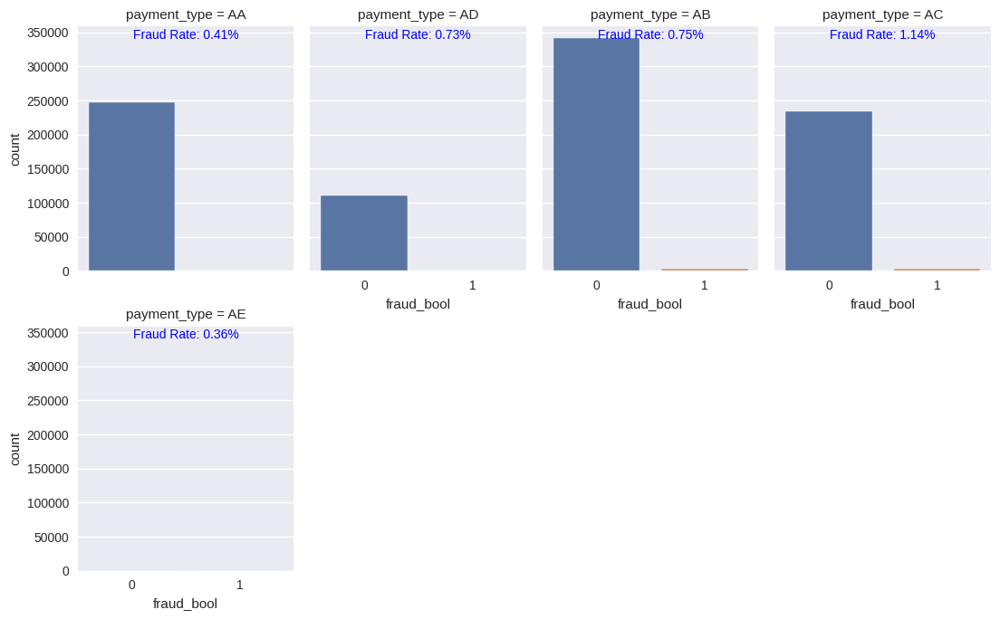

--------------------------------------------------
--------------------------------------------------
##### employment_status Distribution #####


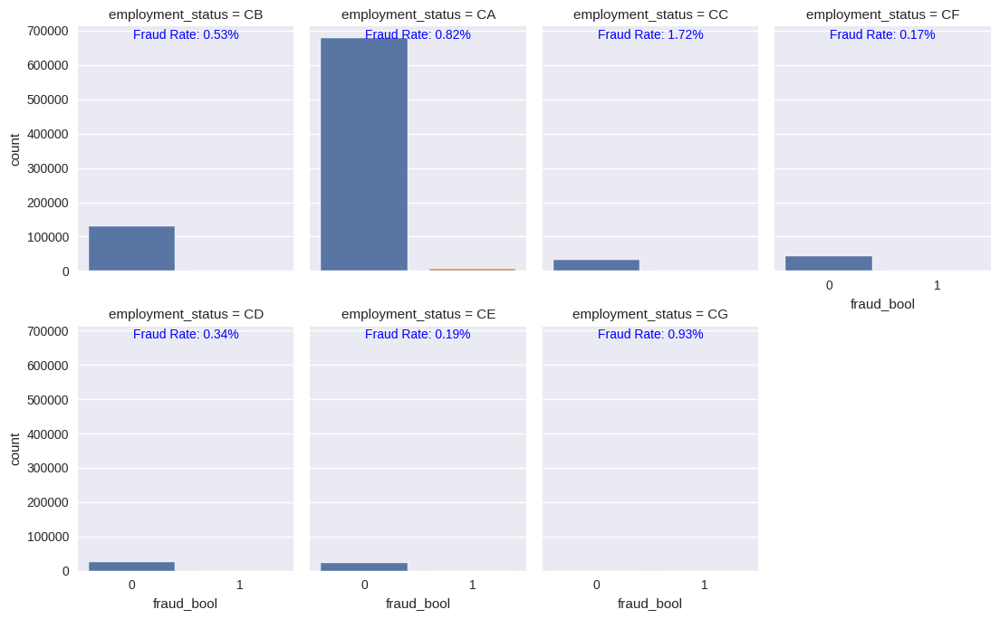

--------------------------------------------------
--------------------------------------------------
##### housing_status Distribution #####


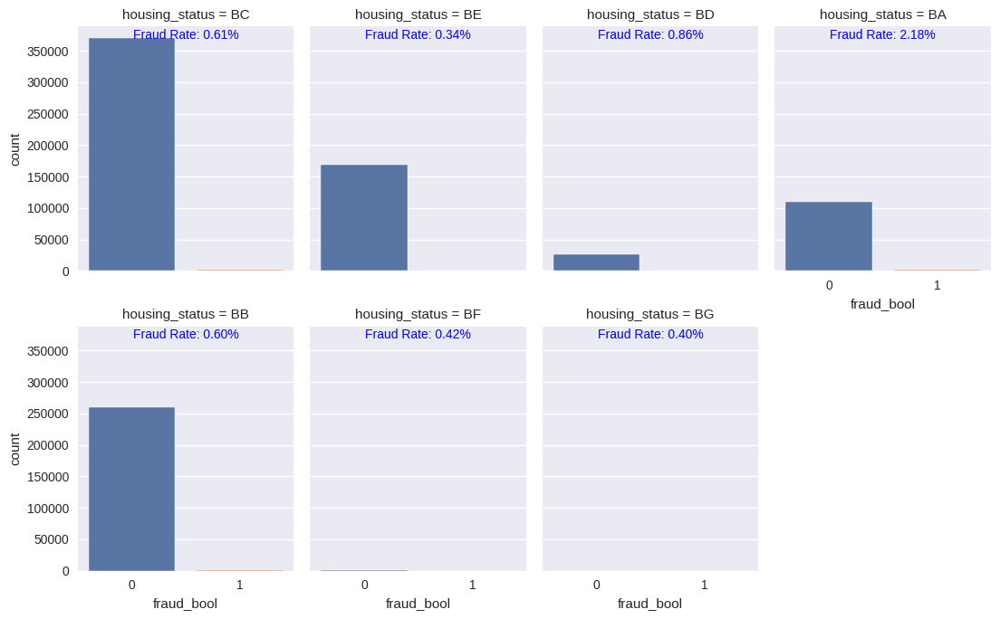

--------------------------------------------------
--------------------------------------------------
##### source Distribution #####


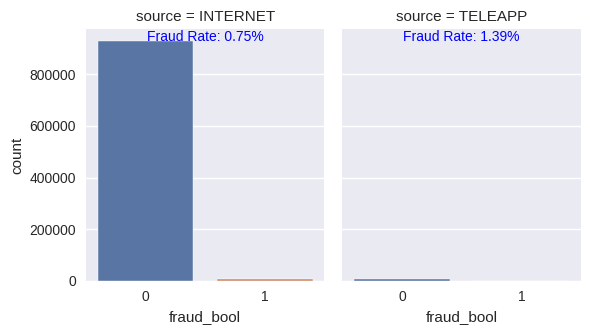

--------------------------------------------------
--------------------------------------------------
##### device_os Distribution #####


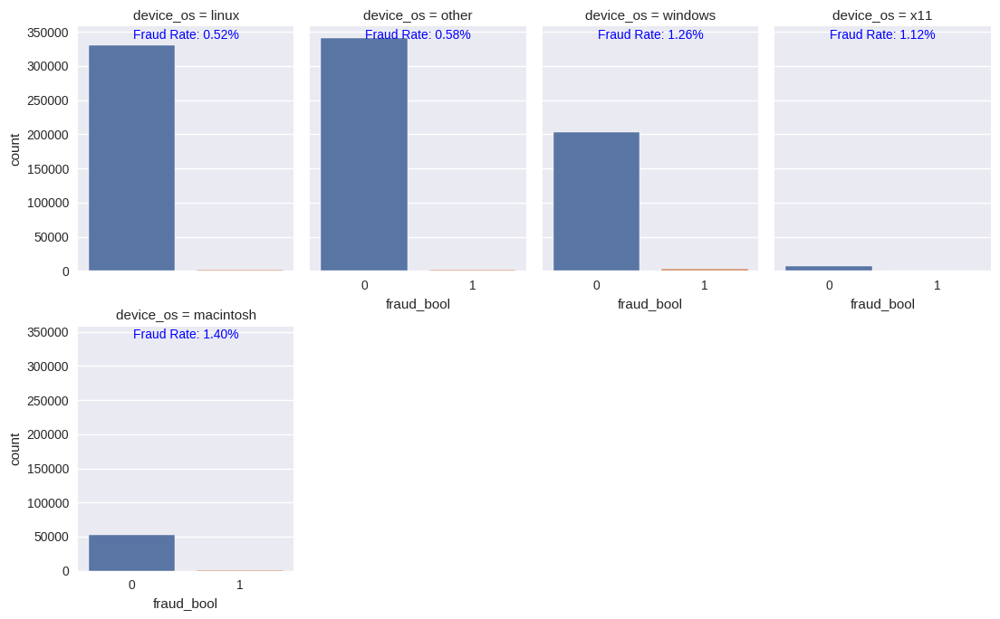

--------------------------------------------------


In [ ]:
# 카테고리컬 데이터 분석 1
# 구성 확인 및 사기 비율 확인
# 평균 fraud 비율과 비슷하거나 더 많은 클래스 확인

# payment_type, housing_status, device_os

[print(f'{col}: {df_temp[col].nunique()}') for col in cols_categorical]
for col in cols_categorical:
    print(f'-'*50)
    print(f'##### {col} Distribution #####')
    ratio_1 = df_temp[df_temp["fraud_bool"] == 1].groupby(col).size() / df_temp.groupby(col).size() * 100
    g = sns.catplot(x="fraud_bool", col=col, col_wrap=4, data=df_temp,
                kind="count", height=3.5, aspect=.8,  palette='deep')
    for ax in g.axes.flat:
        cat = ax.get_title().split(" = ")[-1]
        if cat in ratio_1:
            ax.text(0.5, 0.94,
                    f"Fraud Rate: {ratio_1[cat]:.2f}%",
                    ha="center", va="bottom", transform=ax.transAxes, fontsize=10, color="blue")
    plt.show()
    print(f'-'*50)

### **Numerical**

In [ ]:
unique_counts = {col: df_temp[col].nunique() for col in cols_numerical}
cols_numerical_under5 = [col for col, count in unique_counts.items() if count <= 5]
cols_numerical_over5 = [col for col, count in unique_counts.items() if count > 5]

--------------------------------------------------
##### fraud_bool Distribution #####


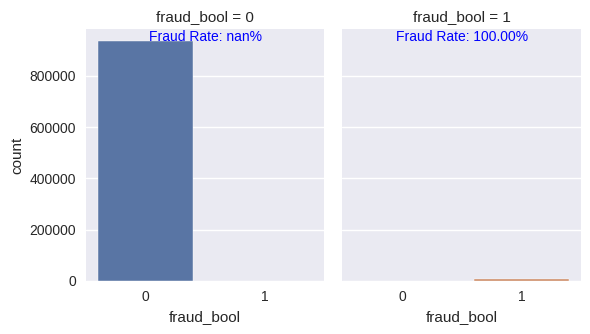

--------------------------------------------------
--------------------------------------------------
##### email_is_free Distribution #####


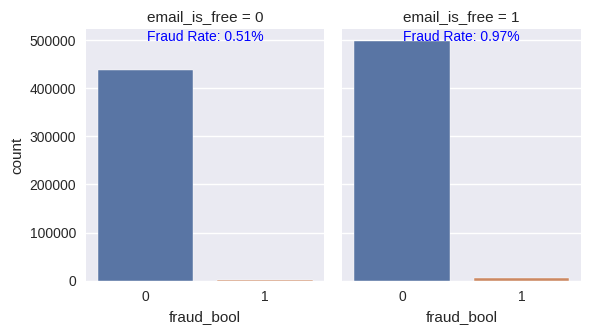

--------------------------------------------------
--------------------------------------------------
##### phone_home_valid Distribution #####


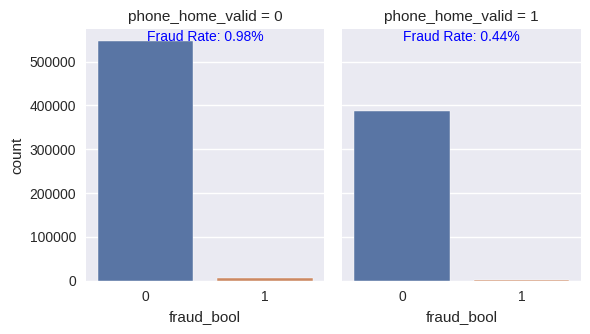

--------------------------------------------------
--------------------------------------------------
##### phone_mobile_valid Distribution #####


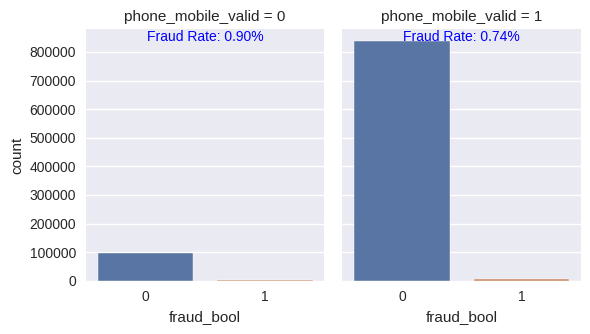

--------------------------------------------------
--------------------------------------------------
##### has_other_cards Distribution #####


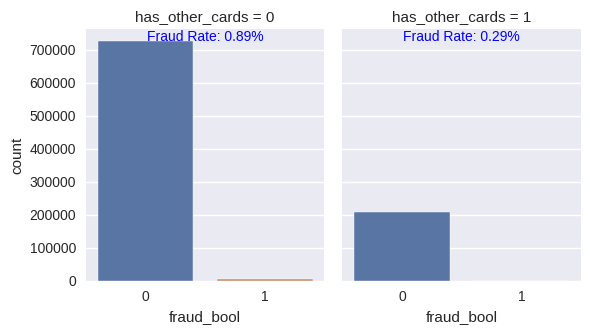

--------------------------------------------------
--------------------------------------------------
##### foreign_request Distribution #####


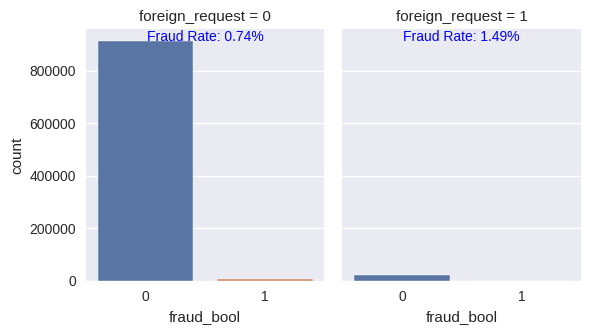

--------------------------------------------------
--------------------------------------------------
##### keep_alive_session Distribution #####


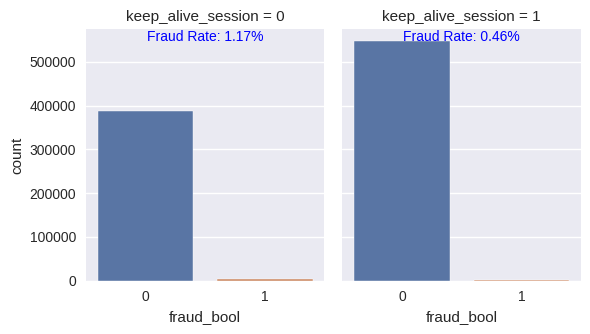

--------------------------------------------------
--------------------------------------------------
##### device_distinct_emails_8w Distribution #####


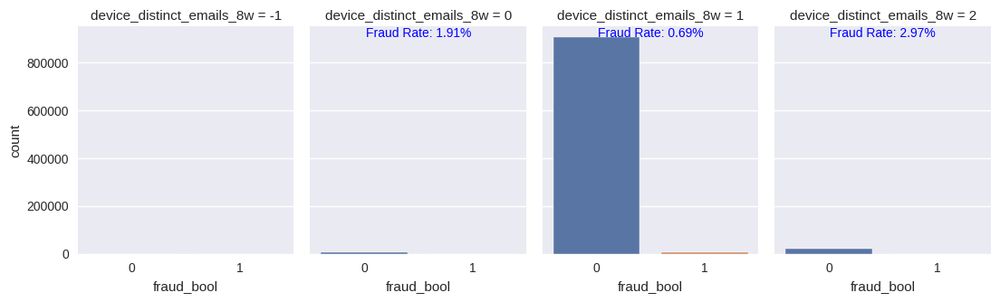

--------------------------------------------------
--------------------------------------------------
##### device_fraud_count Distribution #####


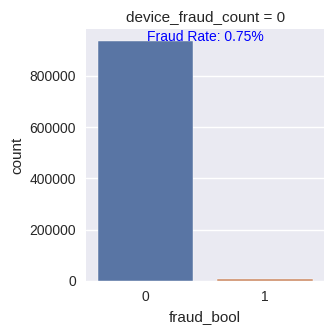

--------------------------------------------------


In [ ]:
# 뉴머리컬 데이터 분석 1 (=카테고리컬)
# 구성 확인 및 사기 비율 확인
# 평균 fraud 비율과 비슷하거나 더 많은 클래스 확인

# email_is_free, phone_home_valid, has_other_cards, keep_alive_session, foreign_request

for col in cols_numerical_under5:
    print(f'-'*50)
    print(f'##### {col} Distribution #####')
    ratio_1 = df_temp[df_temp["fraud_bool"] == 1].groupby(col).size() / df_temp.groupby(col).size() * 100
    g = sns.catplot(x="fraud_bool", col=col, col_wrap=4, data=df_temp,
                kind="count", height=3.5, aspect=.8,  palette='deep')
    fig.suptitle('sf')
    for ax in g.axes.flat:
        cat = ax.get_title().split(" = ")[-1]
        try:
            cat = int(cat) if cat.isdigit() else cat
        except ValueError:
            pass
        if cat in ratio_1:
            ax.text(0.5, 0.94,
                    f"Fraud Rate: {ratio_1[cat]:.2f}%",
                    ha="center", va="bottom", transform=ax.transAxes, fontsize=10, color="blue")
    plt.show()
    print(f'-'*50)

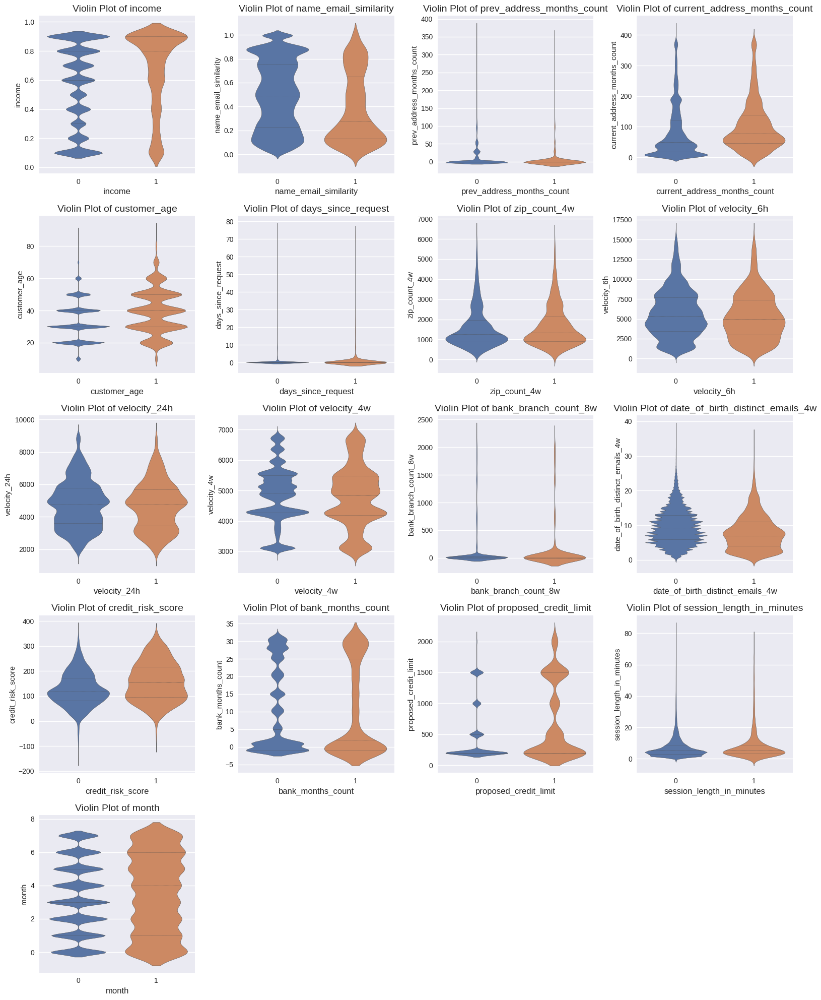

In [ ]:
# 뉴머리컬 데이터 분석 2
# 바이올린 플랏의 shape이 다른 feature 선별

# 큰 분포 차이 : income, name_email_similarity
# 작은 분포 차이 : customer_age, address_months_count, credit_risk_score, proposed_credit_limit

n_cols = 4
n_rows = (len(cols_numerical_over5) + n_cols - 1) // n_cols
fig, axs = plt.subplots(n_rows, n_cols, figsize=(16, 4 * n_rows))
axs = axs.flatten()
for i, col in enumerate(cols_numerical_over5):
    sns.violinplot(x='fraud_bool', y=col, data=df_temp, scale='width', inner='quartile', ax=axs[i], palette='deep')
    axs[i].set_title(f'Violin Plot of {col}', fontsize=14)
    axs[i].set_xlabel(col, fontsize=12)
for j in range(i + 1, len(axs)):
        axs[j].axis('off')
plt.tight_layout()
plt.show()

### **Total**

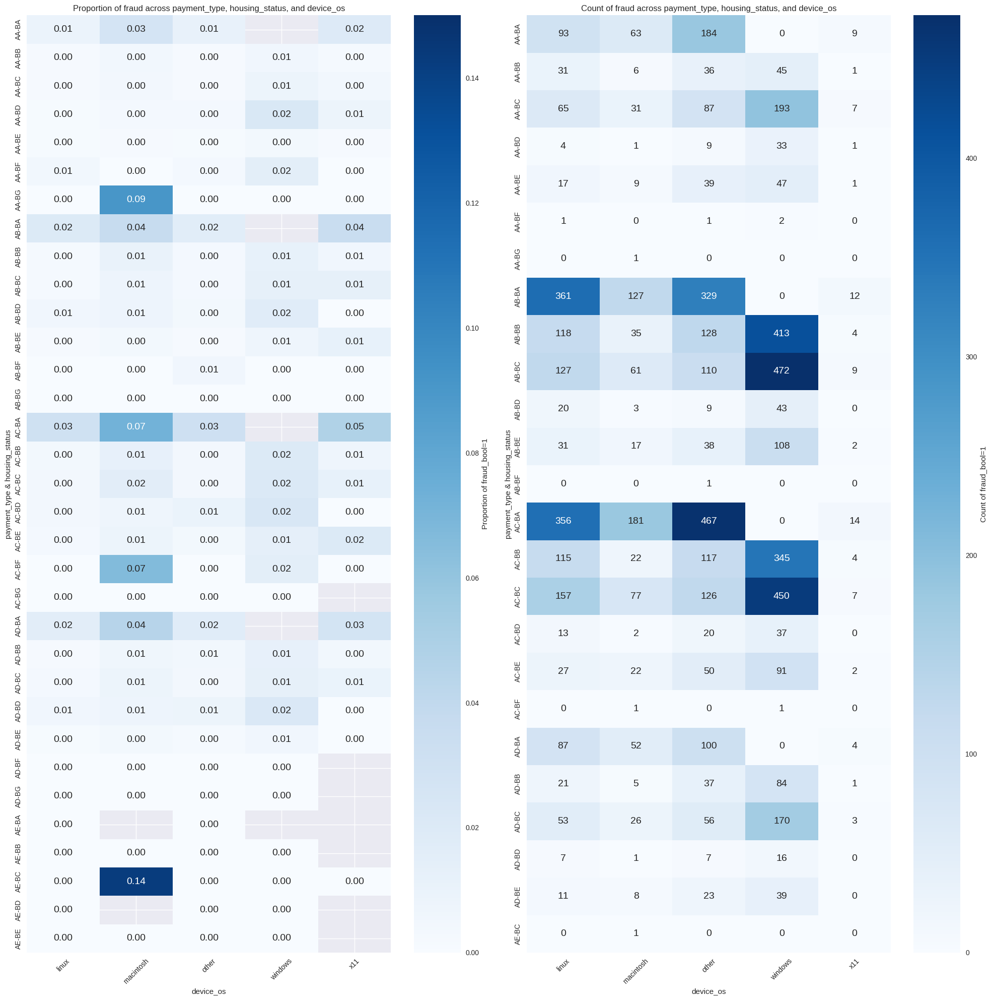

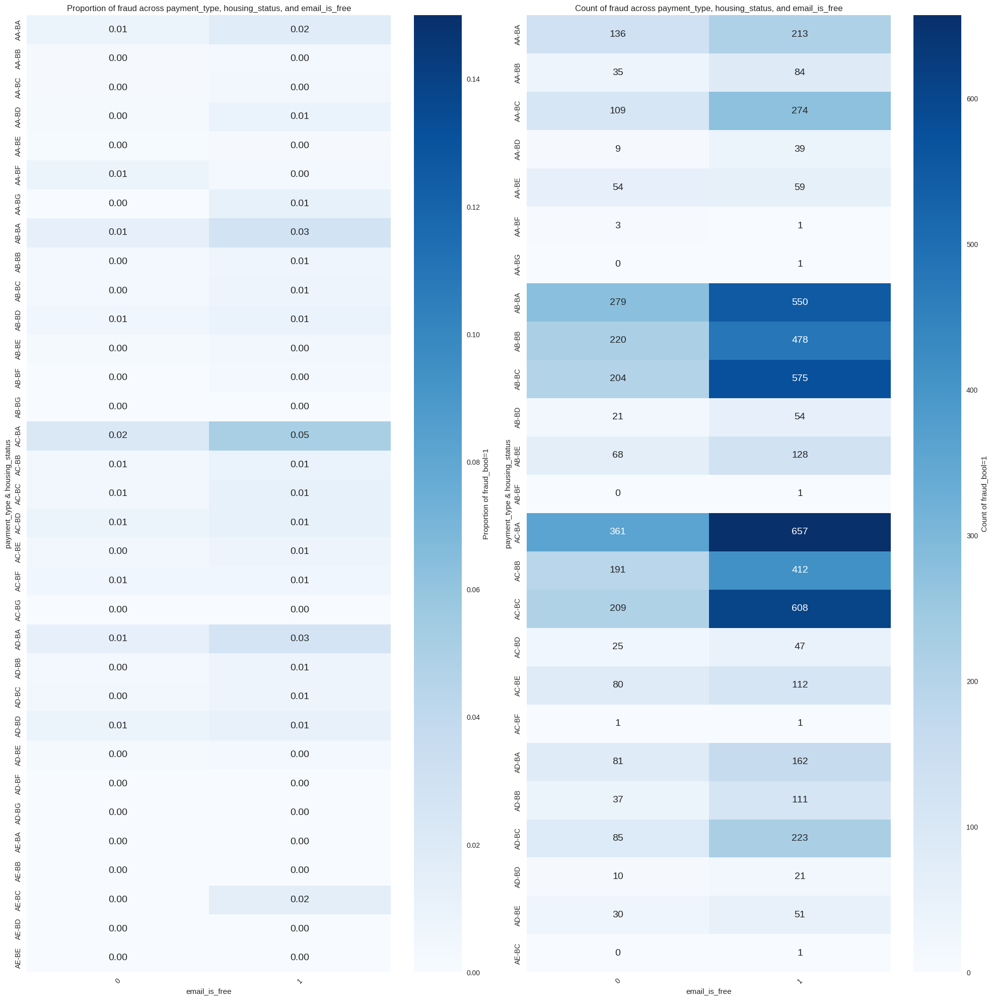

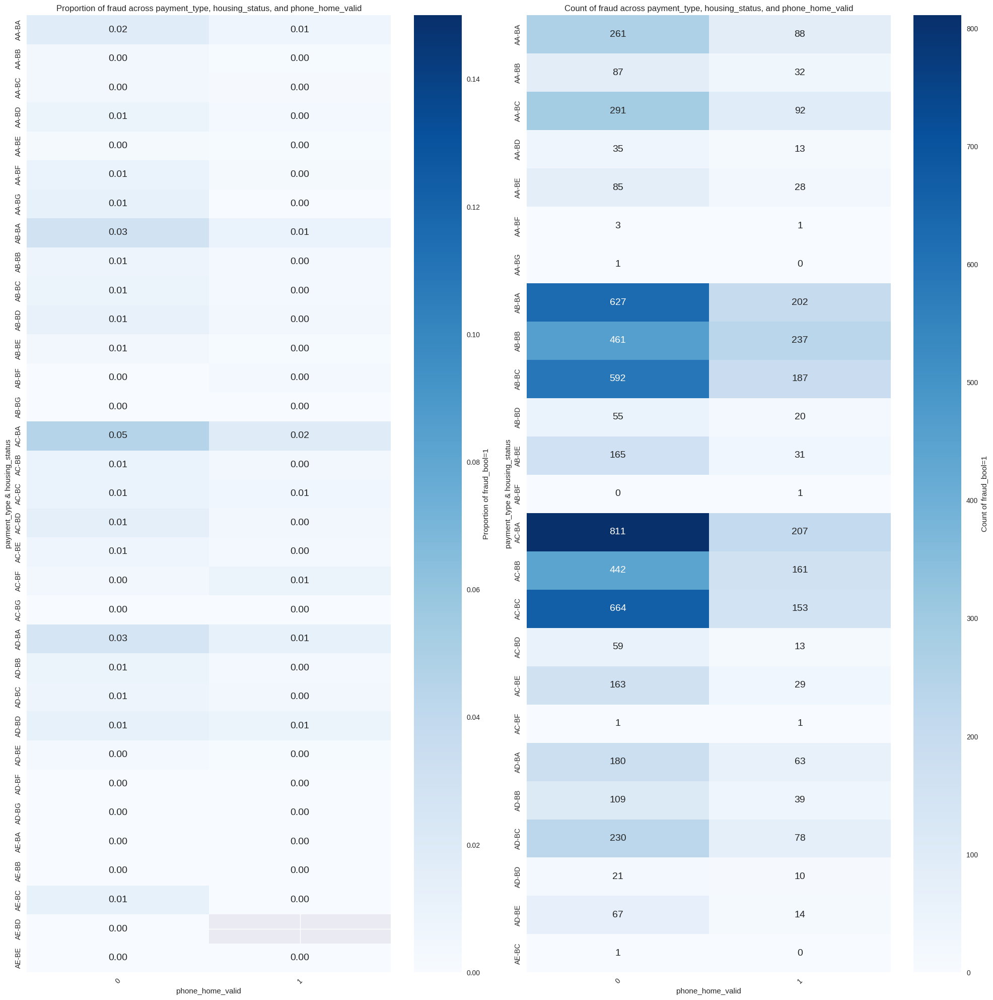

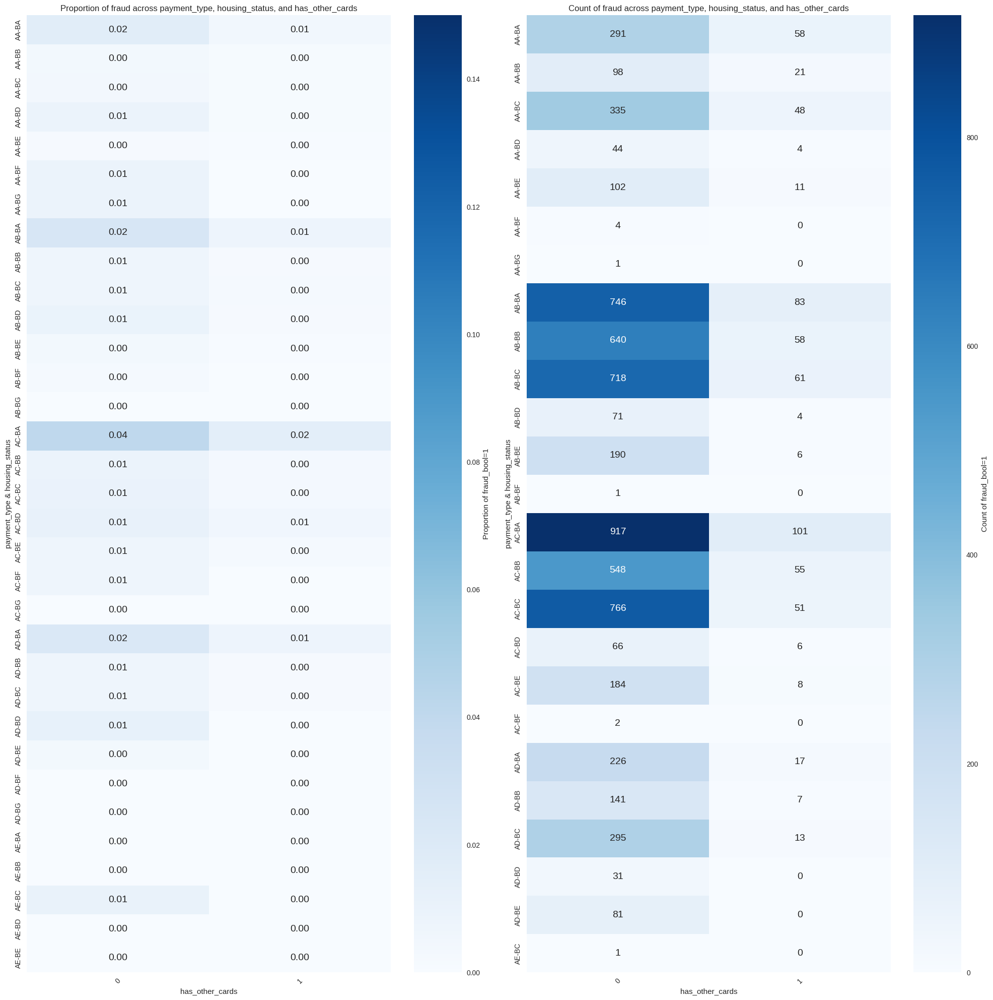

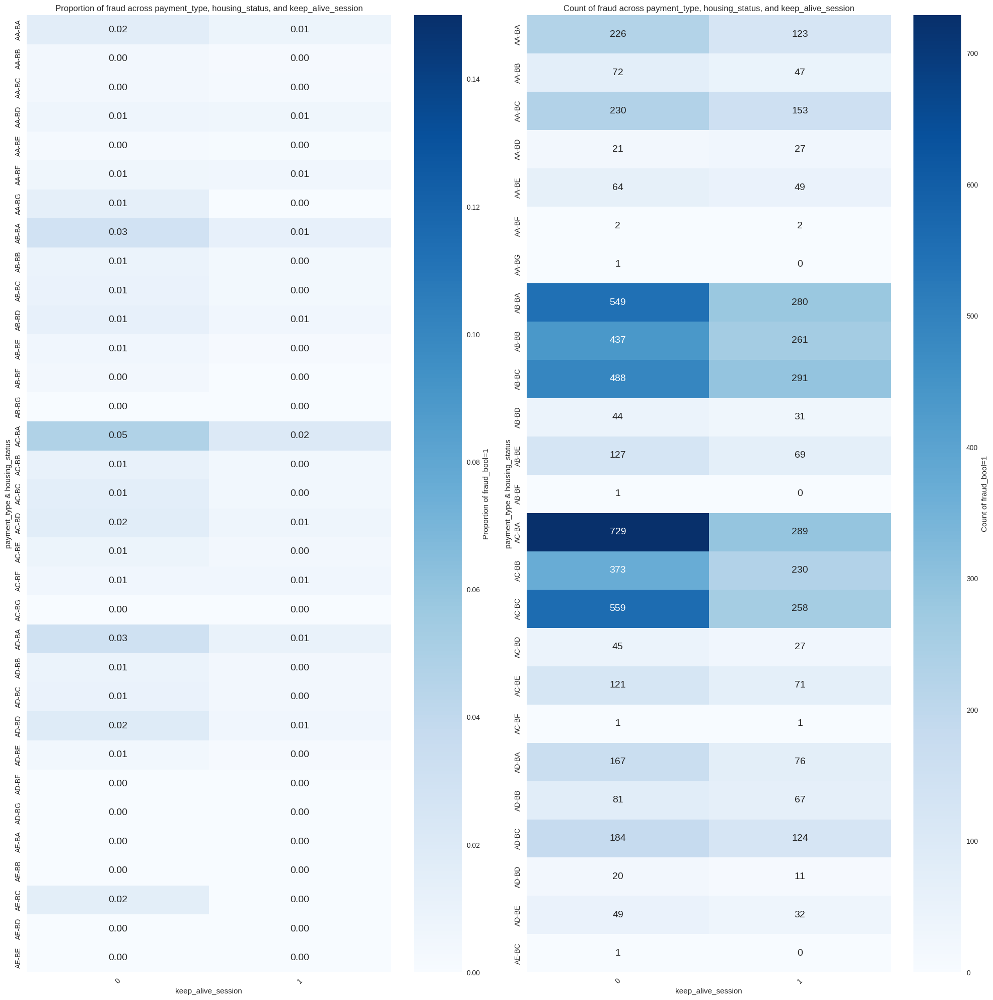

...

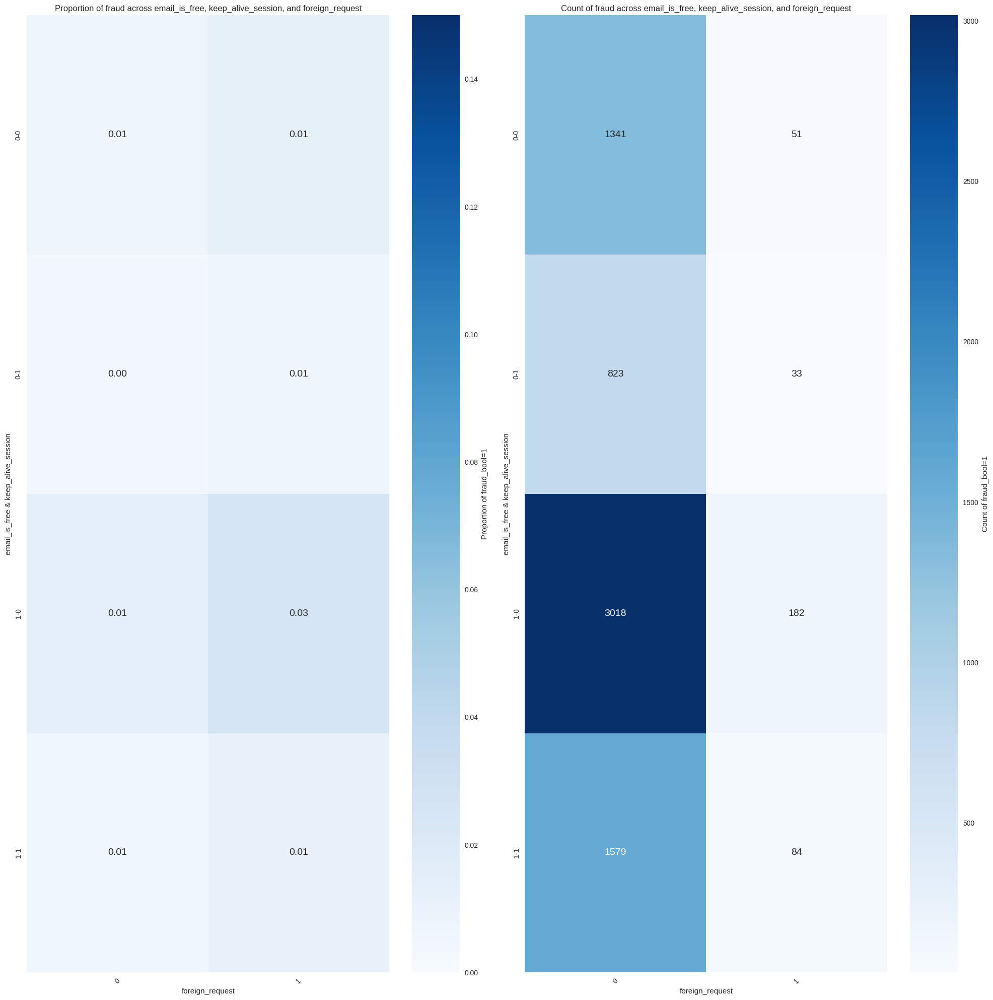

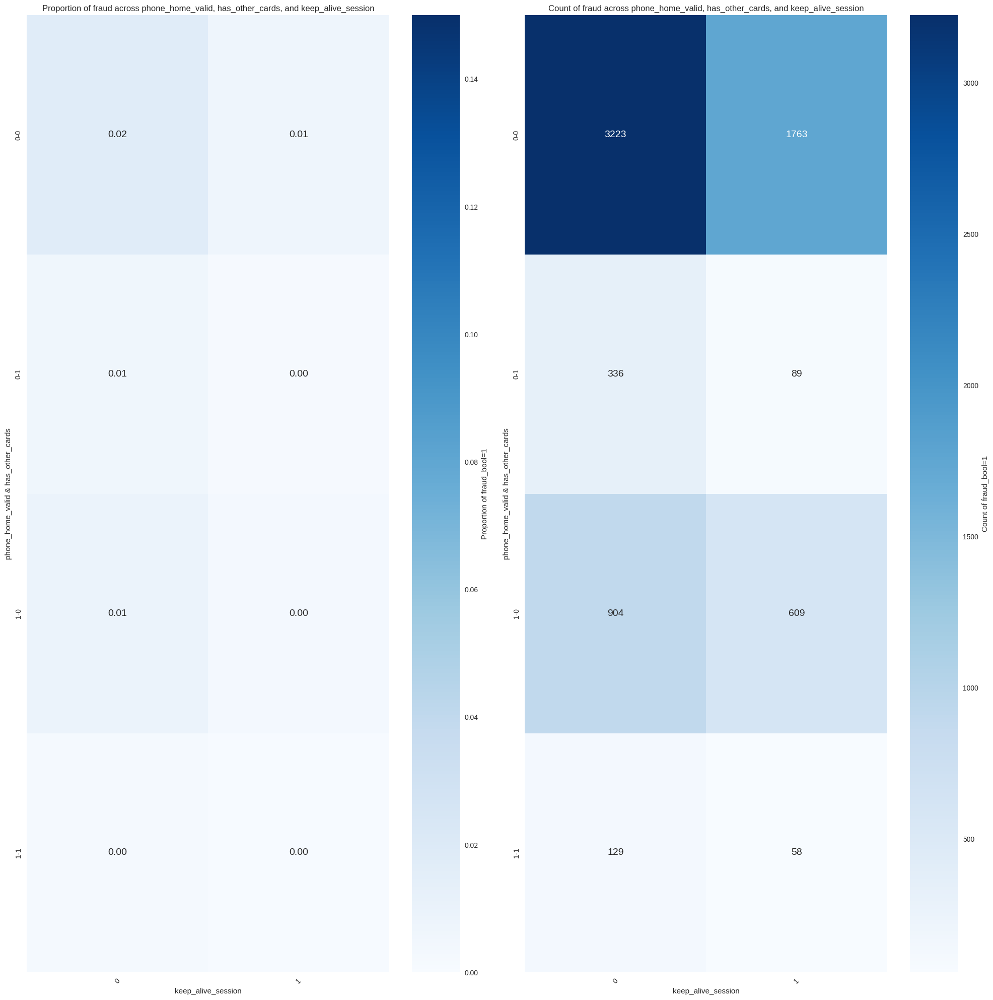

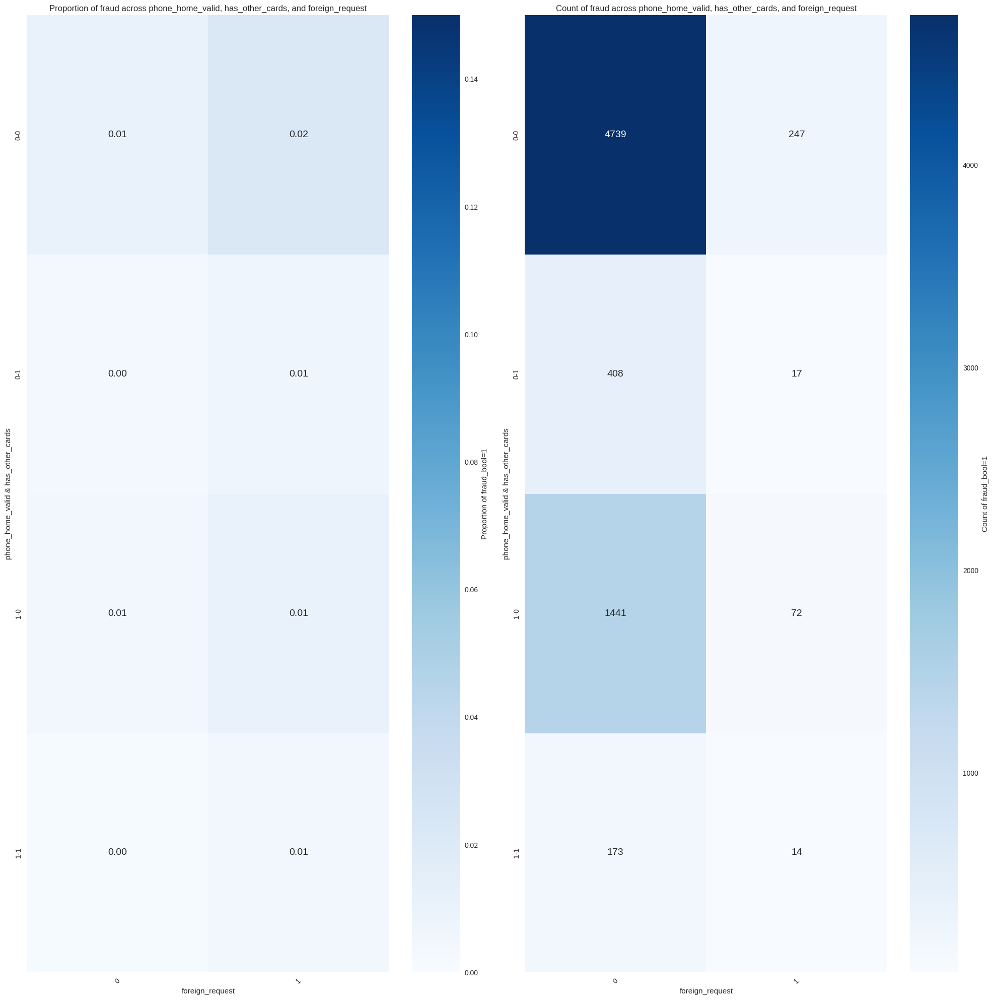

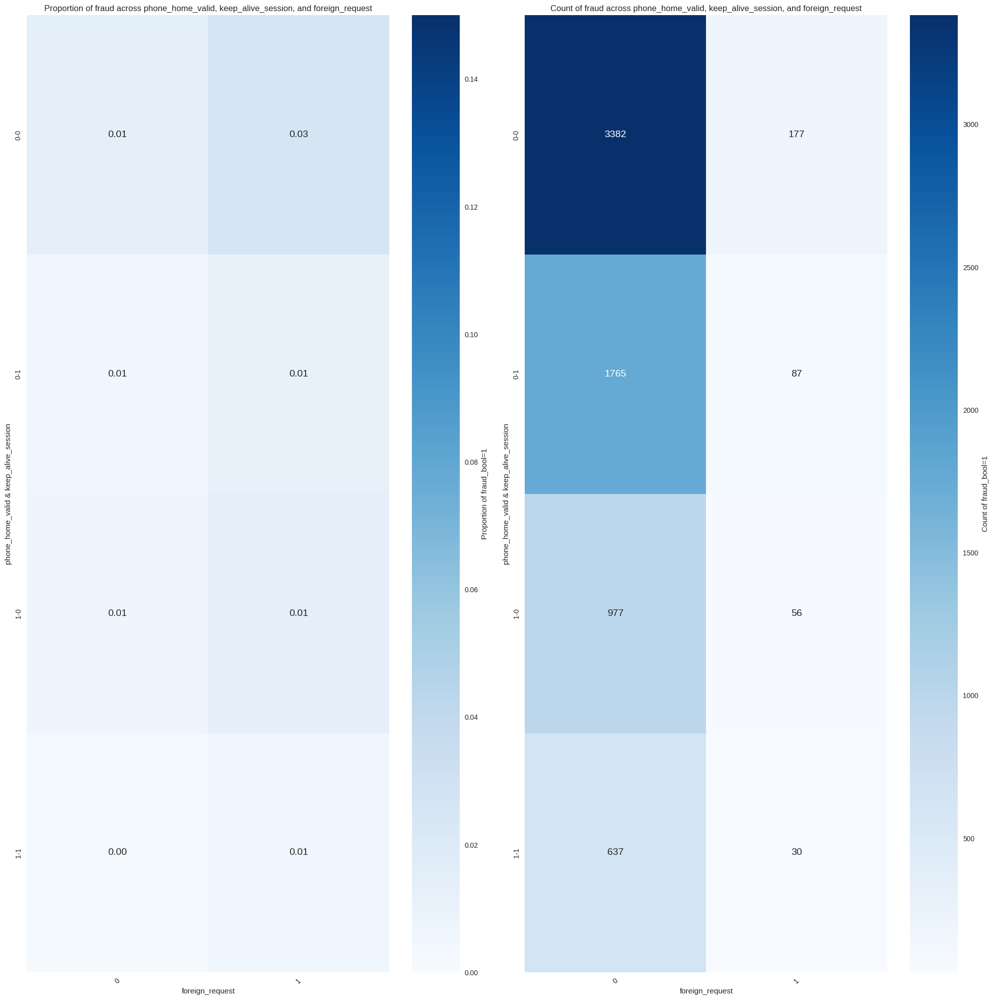

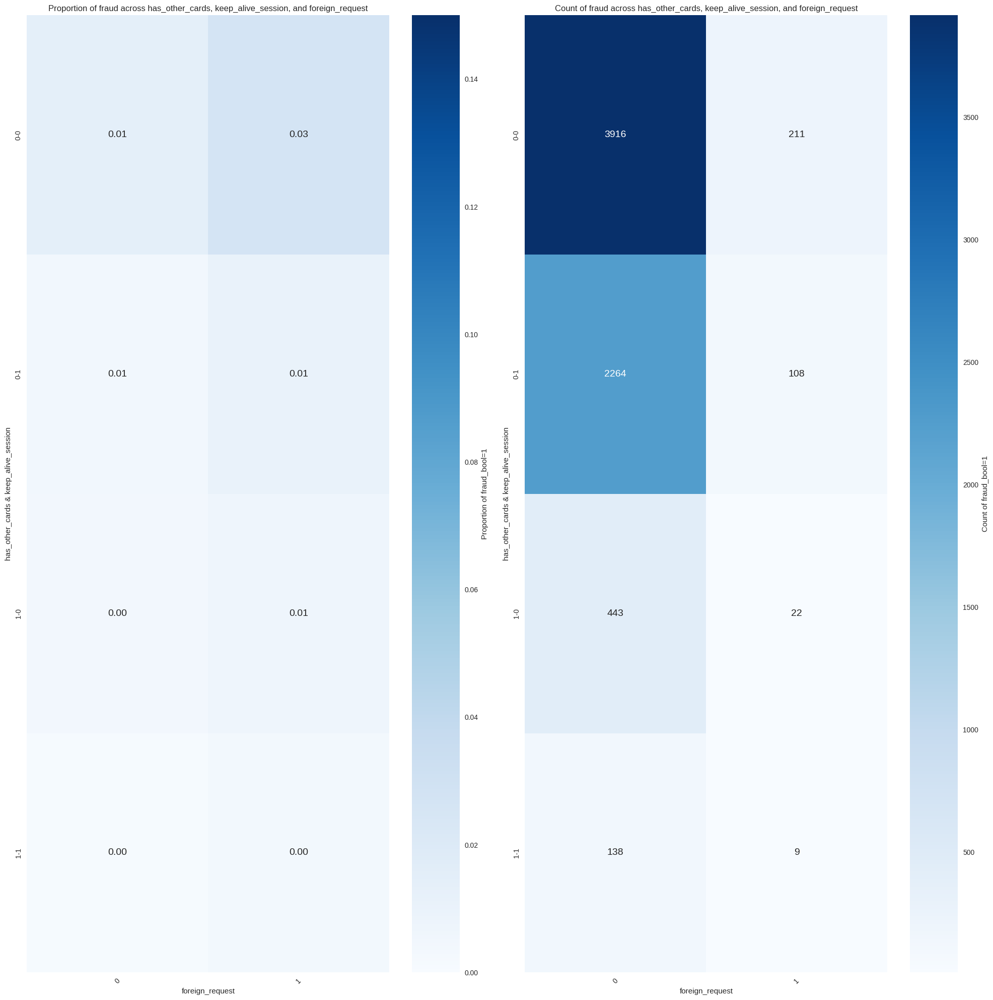

In [ ]:
# 통합 데이터 분석 1
# 카테고리컬만 활용해서 군집 추출
# 기준: 2000명 이상, 2% 이상
# ['housing_status', 'has_other_cards', 'foreign_request'] -> ['BA', 0, 0] : 3%, 2078
# ['email_is_free', 'has_other_cards', 'keep_alive_session'] -> [1, 0, 0] : 2%, 2890
# [‘phone_home_valid’, 'has_other_cards', 'keep_alive_session'] -> [0, 0, 0] : 2%, 3223

import itertools

cols_temp_cat1 = ['payment_type', 'housing_status', 'device_os']
cols_temp_cat2 = ['email_is_free', 'phone_home_valid', 'has_other_cards', 'keep_alive_session', 'foreign_request']
cols_temp_cat = cols_temp_cat1 + cols_temp_cat2
cols_temp_num = ['income', 'name_email_similarity', 'current_address_months_count',
                 'customer_age', 'credit_risk_score', 'proposed_credit_limit']


for combo in itertools.combinations(cols_temp_cat, 3):
    df_temp = df.copy()
    df_temp = df_temp[(df_temp['housing_status'] != 'BA') | (df_temp['device_os'] != 'windows')]

    col_A, col_B, col_C = combo

    grouped_mean = df_temp.groupby([col_A, col_B, col_C])['fraud_bool'].mean().reset_index()
    pivot_df_mean = grouped_mean.pivot_table(values='fraud_bool', index=[col_A, col_B], columns=col_C)

    df_temp = df_temp[df_temp['fraud_bool'] == 1]
    grouped_count = df_temp.groupby([col_A, col_B, col_C])['fraud_bool'].count().reset_index(name='count')
    pivot_df_count = grouped_count.pivot_table(values='count', index=[col_A, col_B], columns=col_C, fill_value=0)
    pivot_df_count = np.round(pivot_df_count).astype(int)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))

    sns.heatmap(pivot_df_mean, annot=True, cmap="Blues", fmt=".2f", cbar_kws={'label': 'Proportion of fraud_bool=1'}, annot_kws={'size': 14}, ax=ax1, vmin=0, vmax=0.15)
    ax1.set_title(f"Proportion of fraud across {col_A}, {col_B}, and {col_C}")
    ax1.set_ylabel(f"{col_A} & {col_B}")
    ax1.set_xlabel(f"{col_C}")
    ax1.tick_params(axis='x', rotation=45)

    sns.heatmap(pivot_df_count, annot=True, cmap="Blues", fmt="d", cbar_kws={'label': 'Count of fraud_bool=1'}, annot_kws={'size': 14}, ax=ax2)
    ax2.set_title(f"Count of fraud across {col_A}, {col_B}, and {col_C}")
    ax2.set_ylabel(f"{col_A} & {col_B}")
    ax2.set_xlabel(f"{col_C}")
    ax2.tick_params(axis='x', rotation=45)

    plt.tight_layout()
    plt.show()

In [ ]:
# 통합 데이터 분석 2
# 공통 군집 추출

# ['housing_status', 'has_other_cards', 'foreign_request'] -> ['BA', 0, 0] : 3%, 2078
# ['email_is_free', 'has_other_cards', 'keep_alive_session'] -> [1, 0, 0] : 2%, 2890
# [‘phone_home_valid’, 'has_other_cards', 'keep_alive_session'] -> [0, 0, 0] : 2%, 3223

# ('has_other_cards' == 0) and ('keep_alive_session' == 0)

df_temp = df.copy()
df_temp_1 = df_temp[(df_temp['has_other_cards'] == 0) & (df_temp['keep_alive_session'] == 0)]
fraud_counts = df_temp_1['fraud_bool'].value_counts()
fraud_ratio = df_temp_1['fraud_bool'].value_counts(normalize=True) * 100
fraud_summary = pd.DataFrame({'Count': fraud_counts, 'Ratio': fraud_ratio})
print(fraud_summary)

             Count     Ratio
fraud_bool                  
0           301998  97.87874
1             6545   2.12126


### **⭐️ EDA 결론**
---

> **군집 이진 분류**
```
2번째로 발견한 군집에 대하여 이진 분류를 진행한다.
```

> **군집 B의 컨디션**
```
('has_other_cards' == 0) and ('keep_alive_session' == 0)
```

> **군집 B의 장점**
```
분석을 통해 추출한 군집으로 상대적으로 fraud 비율이 높다. (2.1% 확률)
전체 fraud 11k 중에서 약 7k를 차지한다. (59% 포션)
```

## **Process04: 모델링**

#### **언더 샘플링 및 최적화**

In [ ]:
# LightGBM develop
# 언더 샘플링
# 10%: 0.523 -> 0.345
# 20%: 0.398 -> 0.492 (best)
# 30%: 0.339 -> 0.449
# 40%: 0.283 -> 0.488
# 50%: 0.244 -> 0.312
# 60%: 0.237 -> 0.314
# 70%: 0.044 -> 0.039
# 80%: 0.190 -> 0.258
# 90%: 0.078 -> 0.076
# 100%: 0.157 -> 0.251


# 튜닝
# lr=2e-1: 0.480
# lr=3e-1: 0.499 (best)
# lr=4e-1: 0.492
# lr=5e-1: 0.489
# lr=6e-1: 0.192

# lr=3e-1, num_leaves=16: 0.385
# lr=3e-1, num_leaves=32: 0.435
# lr=3e-1, num_leaves=64: 0.499 (유지)
# lr=3e-1, num_leaves=128: 0.491
# lr=3e-1, num_leaves=256: 0.492

# lr=3e-1, threshold=0.1: 0.333
# lr=3e-1, threshold=0.2: 0.428
# lr=3e-1, threshold=0.3: 0.491
# lr=3e-1, threshold=0.4: 0.546
# lr=3e-1, threshold=0.5: 0.604
# lr=3e-1, threshold=0.6: 0.656
# lr=3e-1, threshold=0.7: 0.704
# lr=3e-1, threshold=0.8: 0.721 (best)
# lr=3e-1, threshold=0.9: 0.672

# lr=3e-1, threshold=0.8, epoch=500: 0.721
# lr=3e-1, threshold=0.8, epoch=1000: 0.741 (best)
# lr=3e-1, threshold=0.8, epoch=1500: 0.723
# lr=3e-1, threshold=0.8, epoch=2000: 0.700

# 결과 상세
'''
              precision    recall  f1-score   support

           0      0.996     0.991     0.994    301998
           1      0.665     0.836     0.741      6545

    accuracy                          0.988    308543
   macro avg      0.831     0.913     0.867    308543
weighted avg      0.989     0.988     0.988    308543
'''

# B 군집 fraud, 6545개 중에 83.6% 검출 (5472개)
# 전체 fraud, 11029개 중에 49.6% 검출

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import lightgbm as lgb
from sklearn.metrics import classification_report
import random
import torch


FRAC= 0.2
LEARNING_RATE = 3e-1
NUM_BOOST_ROUND = 1000
THRESHOLD = 0.8

SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)

for NUM_BOOST_ROUND in [1000]:
  print(f'############# {NUM_BOOST_ROUND} #############')
  params = {
    "learning_rate": LEARNING_RATE,
    "boosting_type": 'gbdt',
    "objective": "binary",
    'metric': 'binary_logloss',
    "num_leaves": 64,
    "max_depth": 6,
    "max_bin": 256,
    "feature_fraction": 0.5,
    "verbosity": -1,
    "drop_rate": 0.3,
    "is_unbalance": False,
    "max_drop": 50,
    "min_child_samples": 0,
    "min_child_weight": 0.01,
    "min_split_gain": 0,
    "subsample": 0.9,
    # "early_stopping_rounds": 200,
    "seed": SEED,
  }

  df_temp = df.copy()
  df_temp = df_temp[(df_temp['has_other_cards'] == 0) & (df_temp['keep_alive_session'] == 0)]

  fraud_data = df_temp[df_temp['fraud_bool']== 1]
  non_fraud_data = df_temp[df_temp['fraud_bool'] == 0].sample(frac=FRAC, random_state=SEED)
  df_temp = pd.concat([fraud_data , non_fraud_data], ignore_index = True)
  print(f'########### {FRAC*100:.0f}% ###########')
  print(df_temp['fraud_bool'].value_counts())

  X = df_temp.drop('fraud_bool', axis=1)
  Y = df_temp['fraud_bool']

  cols_drop = ['device_fraud_count']
  for col in cols_drop:
      X.drop(col, axis=1, inplace=True)

  # cols_date = ['date_1', 'date_2']
  # for col in cols_date:
  #     X[f'week_{col}'] = X[col].dt.dayofweek
  #     X[f'month_{col}'] = X[col].dt.month
  #     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

  for column in X.columns:
      if X[column].dtype == object:
          le = LabelEncoder()
          X[column] = le.fit_transform(X[column])

  x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)
  ds_train = lgb.Dataset (x_train, label = y_train)
  ds_test = lgb.Dataset (x_test, label = y_test)

  model = lgb.train(
      params,
      ds_train,
      NUM_BOOST_ROUND,
      # valid_sets=[ds_test],
      # valid_names=['test'],
      )


  y_pred_train = model.predict(x_train)
  for i in range(0, len(y_pred_train)):
    if y_pred_train[i] >=THRESHOLD:
      y_pred_train[i] = 1
    else:
      y_pred_train[i] = 0
  print(classification_report(y_train, y_pred_train, digits=3))


  y_pred_test = model.predict(x_test)
  for i in range(0,len(y_pred_test)):
    if y_pred_test[i] >=THRESHOLD:
      y_pred_test[i] = 1
    else:
      y_pred_test[i] = 0
  print(classification_report(y_test, y_pred_test, digits=3))

  df_temp = df.copy()
  df_temp = df_temp[(df_temp['has_other_cards'] == 0) & (df_temp['keep_alive_session'] == 0)]
  X = df_temp.drop('fraud_bool', axis=1)
  Y = df_temp['fraud_bool']

  cols_drop = ['device_fraud_count']
  for col in cols_drop:
      X.drop(col, axis=1, inplace=True)

  for column in X.columns:
      if X[column].dtype == object:
          le = LabelEncoder()
          X[column] = le.fit_transform(X[column])

  Y_pred = model.predict(X)
  for i in range(0,len(Y_pred)):
    if Y_pred[i] >=THRESHOLD:
      Y_pred[i] = 1
    else:
      Y_pred[i] = 0
  print(classification_report(Y, Y_pred, digits=3))

  model_b = model

############# 1000 #############
########### 20% ###########
fraud_bool
0    60400
1     6545
Name: count, dtype: int64
              precision    recall  f1-score   support

           0      1.000     1.000     1.000     48320
           1      1.000     1.000     1.000      5236

    accuracy                          1.000     53556
   macro avg      1.000     1.000     1.000     53556
weighted avg      1.000     1.000     1.000     53556

              precision    recall  f1-score   support

           0      0.918     0.988     0.952     12080
           1      0.627     0.189     0.290      1309

    accuracy                          0.910     13389
   macro avg      0.773     0.588     0.621     13389
weighted avg      0.890     0.910     0.887     13389

              precision    recall  f1-score   support

           0      0.996     0.990     0.993    301998
           1      0.656     0.838     0.736      6545

    accuracy                          0.987    308543
   macro

### **중간 결과 (B군집)**
---

```
B 군집 fraud, 6545개 중에 83.6% 검출 (5472개)
전체 fraud, 11029개 중에 49.6% 검출
```

### **⭐️ 종합 결과**
---

```
A 군집에서 3918개 중에 81.1%인 3178개를 검출했다.
B 군집에서 6545개 중에 83.6%인 5472개를 검출했다.

두 군집을 합하면 총 8650개를 검출했다.
이는 전체 fraud 11029개 중에 78.4%를 검출한 것이다.
```

## **Process05: 결과 해석**

### **모델 해석 및 평가**

#### **모델 A**

In [ ]:
model = model_a

df_temp = df.copy()
df_temp = df_temp[(df_temp['housing_status'] == 'BA') & (df_temp['device_os'] == 'windows')]

fraud_data = df_temp[df_temp['fraud_bool']== 1]
non_fraud_data = df_temp[df_temp['fraud_bool'] == 0].sample(frac=FRAC, random_state=SEED)
df_temp = pd.concat([fraud_data , non_fraud_data], ignore_index = True)
print(f'########### {FRAC*100:.0f}% ###########')
print(df_temp['fraud_bool'].value_counts())

X = df_temp.drop('fraud_bool', axis=1)
Y = df_temp['fraud_bool']

cols_drop = ['device_fraud_count']
for col in cols_drop:
    X.drop(col, axis=1, inplace=True)

# cols_date = ['date_1', 'date_2']
# for col in cols_date:
#     X[f'week_{col}'] = X[col].dt.dayofweek
#     X[f'month_{col}'] = X[col].dt.month
#     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

for column in X.columns:
    if X[column].dtype == object:
        le = LabelEncoder()
        X[column] = le.fit_transform(X[column])

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=SEED)
ds_train = lgb.Dataset (x_train, label = y_train)
ds_test = lgb.Dataset (x_test, label = y_test)

########### 70% ###########
fraud_bool
0    37807
1     3918
Name: count, dtype: int64


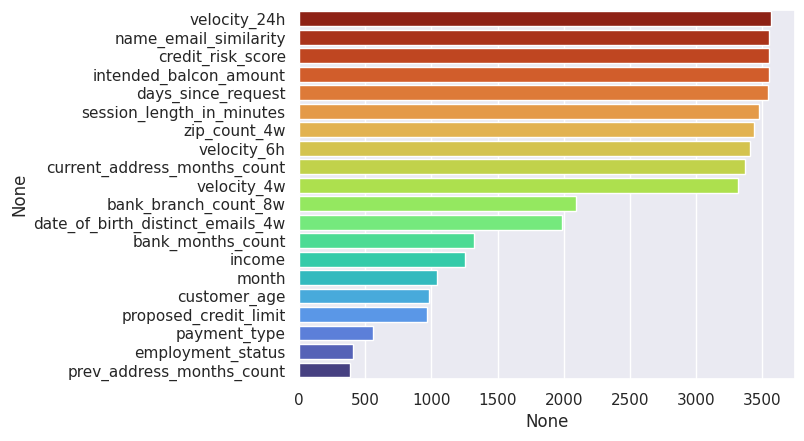

In [ ]:
# A 모델 해석 및 평가 1
# Feature importance 분석
# 간단 기여도 분석 시 신청의 속도, 주소, 인적사항 등이 중요하다.


sns.set(style="darkgrid")
palette = sns.color_palette("turbo", 20)[::-1]
ftr_importances_values = model.feature_importance()
ftr_importances = pd.Series(ftr_importances_values, index = x_test.columns)
ftr_top20 = ftr_importances.sort_values(ascending=False)[:20]
sns.barplot(x=ftr_top20, y=ftr_top20.index, palette=palette)
plt.show()

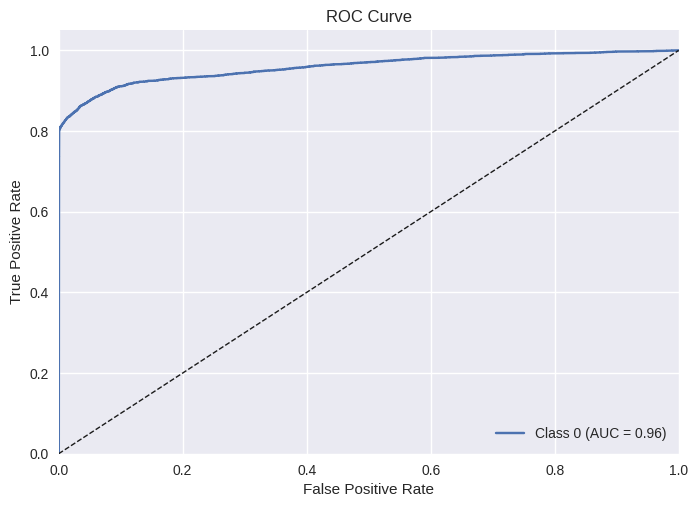

In [ ]:
# A 모델 해석 및 평가 2
# ROC Curve
# 커브가 왼쪽 위로 꺾여있고, AUROC 값이 0.96으로 아주 높은 값이다.
# 모델의 전반적인 분류 성능이 좋다.

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize


Y_predict = model.predict(X, output_margin=False)
if Y_predict.ndim == 1:
    Y_predict = Y_predict.reshape(-1, 1)
classes=np.unique(Y)
Y_bin = label_binarize(Y, classes=classes)
n_classes = Y_bin.shape[1]

plt.style.use(['seaborn-v0_8'])
plt.figure()
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(Y_bin[:, i], Y_predict[:, i])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'Class {classes[i]} (AUC = {roc_auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=1)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower right")
plt.show()

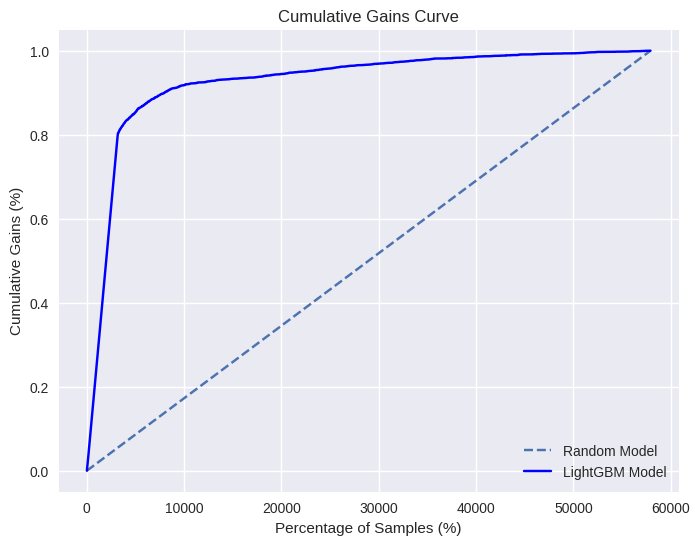

In [ ]:
# A 모델 해석 및 평가 3
# Cumulative Gains Curve
# 커브가 왼쪽 위로 꺾여있다.
# 가장 잘 예측한 샘플들에서 실제로 많은 중요한 결과를 찾았다.

y_test = Y.to_numpy()
Y_predict = model.predict(X)
sorted_indices = np.argsort(Y_predict)[::-1]
sorted_y_test = y_test[sorted_indices]
cumulative_gains = np.cumsum(sorted_y_test) / np.sum(sorted_y_test)

plt.figure(figsize=(8, 6))
plt.plot([0, len(y_test)], [0, 1], linestyle="--", label="Random Model")
plt.plot(np.arange(1, len(y_test) + 1), cumulative_gains, label="LightGBM Model", color='blue')
plt.title('Cumulative Gains Curve')
plt.xlabel('Percentage of Samples (%)')
plt.ylabel('Cumulative Gains (%)')
plt.legend()
plt.grid(True)
plt.show()

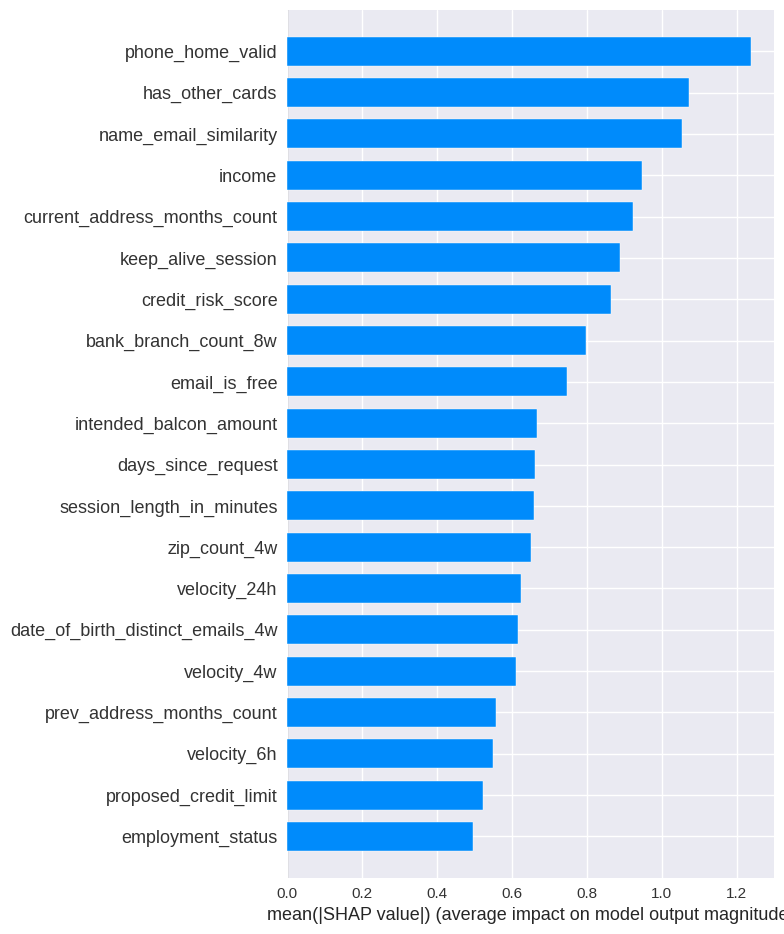

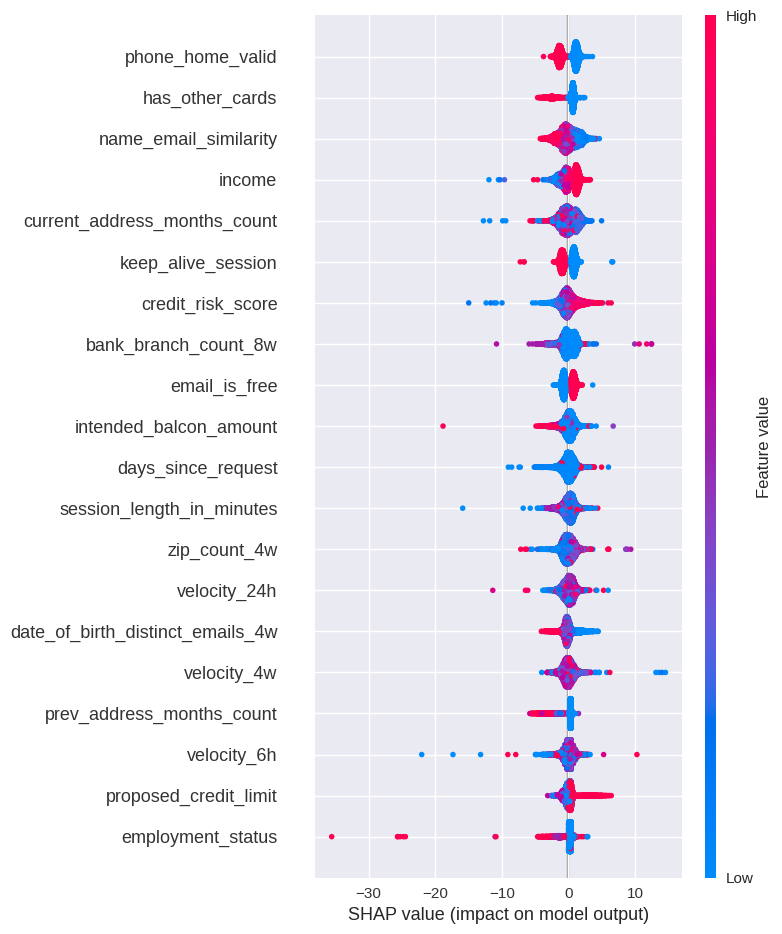

In [ ]:
# A 모델 해석 및 평가 4
# shaply value 요약 비선형을 고려한 top5 기여 feature 확인
# ['phone_home_valid', 'has_other_cards', 'name_email_similarity', 'income', 'current_address_months_count']

# 군집 컨디션: ('housing_status' == 'BA') and ('device_os' == 'windows')
# BA 주거 형태의 윈도우 os를 사용하는 군집.

# 거짓 집전화 정보를 사용하는 경우 사기일 가능성이 높다.
# 다른 카드가 없을 경우 사기일 가능성이 높다.
# 이름과 이메일의 유사도가 떨어질 경우 사기일 가능성이 높다.
# 소득을 높게 적을 경우 사기일 가능성이 높다.
# 현재 등록 주소의 유지 개월수가 낮을수록 사기일 가능성이 높다.

# 주소와 인적사항 관련된 값들이다.
# 허위 주소와 인적사항을 사용하는 경우 사기일 확률이 높다.
# 주소와 인적사항에 대하여 인증을 강화한다.
# 주소와 인적사항 관련 feature들을 다양하게 추출하여 모니터링한다. (주소, 이름, 메일, 전화번호)

# 추가로 카드가 없는 것과 소득이 높은 것도 연관성이 있다.


import shap

explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(x_test)
shap.summary_plot(shap_values, x_test, plot_type='bar')
shap.summary_plot(shap_values, x_test)
plt.show()

In [ ]:
pip install rulefit

  Preparing metadata (setup.py) ... done
  Created wheel for rulefit: filename=rulefit-0.3.1-py3-none-any.whl size=7798 sha256=ad74bfac664c39afbbf37dcc879269add5c32bda64a974836cae65b045d10119
  Stored in directory: /root/.cache/pip/wheels/0d/e7/77/17919d2e417a6589ae77e0722a78f2287c308fca24af14c600
Successfully built rulefit


In [ ]:
# A 모델 해석 및 평가 6
# top5 feature 로 다시 학습한 후 rule extraction

from rulefit import RuleFit

features = ['phone_home_valid', 'has_other_cards', 'name_email_similarity', 'income', 'current_address_months_count']

x_train_rule = x_train[features]
rulefit = RuleFit(tree_size=8, sample_fract='default', max_rules=300, random_state=42)
rulefit.fit(x_train_rule.values, y_train.values.ravel(), x_train_rule.columns)
y_pred = rulefit.predict(x_train_rule.values)
y_pred_binary = (y_pred > 0.2).astype(int)
print(classification_report(y_train, y_pred_binary, digits=3))

rules = rulefit.get_rules()
rules = rules[rules.coef != 0]

table_temp = rules.sort_values("importance", ascending=False).head(5)
display(table_temp)

print(f'########## Rule Extraction ##########')
[print(i) for i in table_temp['rule']]

              precision    recall  f1-score   support

           0      0.923     0.921     0.922     30246
           1      0.253     0.257     0.255      3134

    accuracy                          0.859     33380
   macro avg      0.588     0.589     0.589     33380
weighted avg      0.860     0.859     0.859     33380



,rule,type,coef,support,importance
115,current_address_months_count > 37.5 & current_...,rule,0.038226,0.650502,0.018227
149,name_email_similarity <= 0.999680757522583 & p...,rule,-0.036302,0.440635,0.018023
110,income > 0.8499999940395355 & current_address_...,rule,0.031966,0.159699,0.011710
258,current_address_months_count <= 239.5 & curren...,rule,0.038781,0.087793,0.010975
269,income > 0.8499999940395355 & current_address_...,rule,0.026399,0.140468,0.009173


########## Rule Extraction ##########
current_address_months_count > 37.5 & current_address_months_count > 39.5 & has_other_cards <= 0.5
name_email_similarity <= 0.999680757522583 & phone_home_valid > 0.5
income > 0.8499999940395355 & current_address_months_count > 40.5 & phone_home_valid <= 0.5
current_address_months_count <= 239.5 & current_address_months_count > 71.5 & name_email_similarity <= 0.33270254731178284 & has_other_cards <= 0.5 & name_email_similarity > 0.007174613187089562 & name_email_similarity <= 0.33916740119457245 & phone_home_valid <= 0.5
income > 0.8499999940395355 & current_address_months_count <= 128.5 & has_other_cards <= 0.5


[None, None, None, None, None]

#### **모델 B**

In [ ]:
model = model_b

df_temp = df.copy()
df_temp = df_temp[(df_temp['has_other_cards'] == 0) & (df_temp['keep_alive_session'] == 0)]

fraud_data = df_temp[df_temp['fraud_bool']== 1]
non_fraud_data = df_temp[df_temp['fraud_bool'] == 0].sample(frac=FRAC, random_state=SEED)
df_temp = pd.concat([fraud_data , non_fraud_data], ignore_index = True)
print(f'########### {FRAC*100:.0f}% ###########')
print(df_temp['fraud_bool'].value_counts())

X = df_temp.drop('fraud_bool', axis=1)
Y = df_temp['fraud_bool']

cols_drop = ['device_fraud_count']
for col in cols_drop:
    X.drop(col, axis=1, inplace=True)

# cols_date = ['date_1', 'date_2']
# for col in cols_date:
#     X[f'week_{col}'] = X[col].dt.dayofweek
#     X[f'month_{col}'] = X[col].dt.month
#     X[col] = pd.to_datetime(X[col]).astype(int) / 10**9

for column in X.columns:
    if X[column].dtype == object:
        le = LabelEncoder()
        X[column] = le.fit_transform(X[column])

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, stratify=Y)
ds_train = lgb.Dataset (x_train, label = y_train)
ds_test = lgb.Dataset (x_test, label = y_test)

########### 20% ###########
fraud_bool
0    60400
1     6545
Name: count, dtype: int64


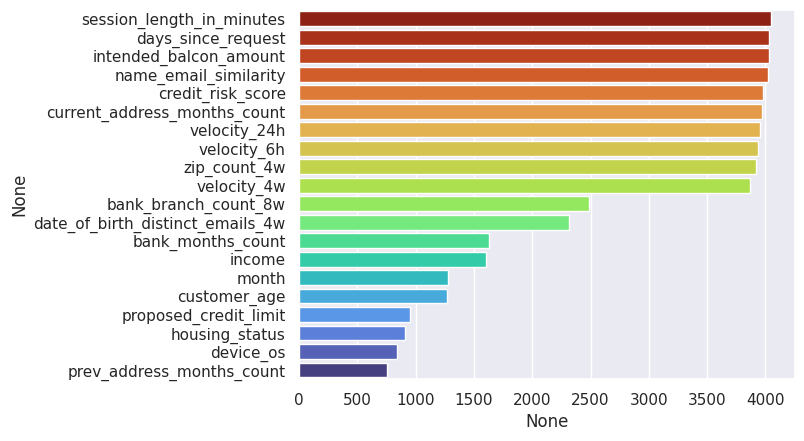

In [ ]:
# B 모델 해석 및 평가 1
# Feature importance 분석
# 간단 기여도 분석 시 세션의 길이, 신청빈도, 초기 이체금액 등이 중요하다.

sns.set(style="darkgrid")
palette = sns.color_palette("turbo", 20)[::-1]
ftr_importances_values = model.feature_importance()
ftr_importances = pd.Series(ftr_importances_values, index = x_train.columns)
ftr_top20 = ftr_importances.sort_values(ascending=False)[:20]
sns.barplot(x=ftr_top20, y=ftr_top20.index, palette=palette)
plt.show()

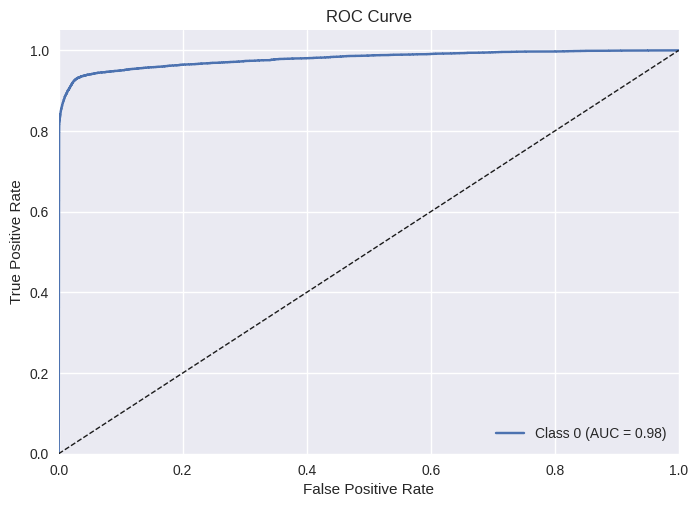

In [ ]:
# B 모델 해석 및 평가 2
# ROC Curve
# 커브가 왼쪽 위로 꺾여있고, AUROC 값이 0.98으로 높은 값이다.
# 모델의 전반적인 분류 성능이 좋다.

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize


Y_predict = model.predict(X, output_margin=False)
if Y_predict.ndim == 1:
    Y_predict = Y_predict.reshape(-1, 1)
classes=np.unique(Y)
Y_bin = label_binarize(Y, classes=classes)
n_classes = Y_bin.shape[1]

plt.style.use(['seaborn-v0_8'])
plt.figure()
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(Y_bin[:, i], Y_predict[:, i])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'Class {classes[i]} (AUC = {roc_auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=1)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower right")
plt.show()

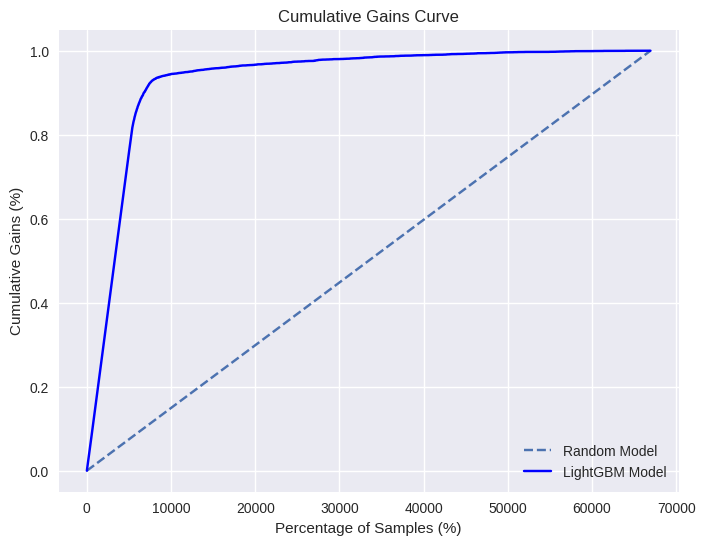

In [ ]:
# B 모델 해석 및 평가 3
# Cumulative Gains Curve
# 커브가 왼쪽 위로 꺾여있다.
# 가장 잘 예측한 샘플들에서 실제로 많은 중요한 결과를 찾았다.

y_test = Y.to_numpy()
Y_predict = model.predict(X)
sorted_indices = np.argsort(Y_predict)[::-1]
sorted_y_test = y_test[sorted_indices]
cumulative_gains = np.cumsum(sorted_y_test) / np.sum(sorted_y_test)

plt.figure(figsize=(8, 6))
plt.plot([0, len(y_test)], [0, 1], linestyle="--", label="Random Model")
plt.plot(np.arange(1, len(y_test) + 1), cumulative_gains, label="LightGBM Model", color='blue')
plt.title('Cumulative Gains Curve')
plt.xlabel('Percentage of Samples (%)')
plt.ylabel('Cumulative Gains (%)')
plt.legend()
plt.grid(True)
plt.show()

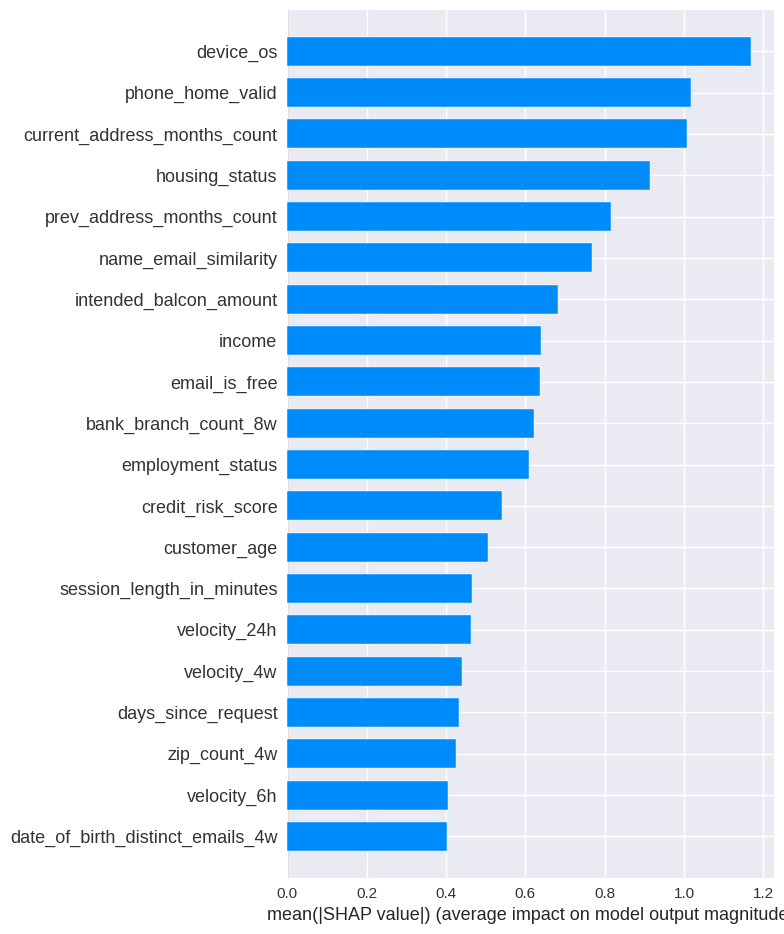

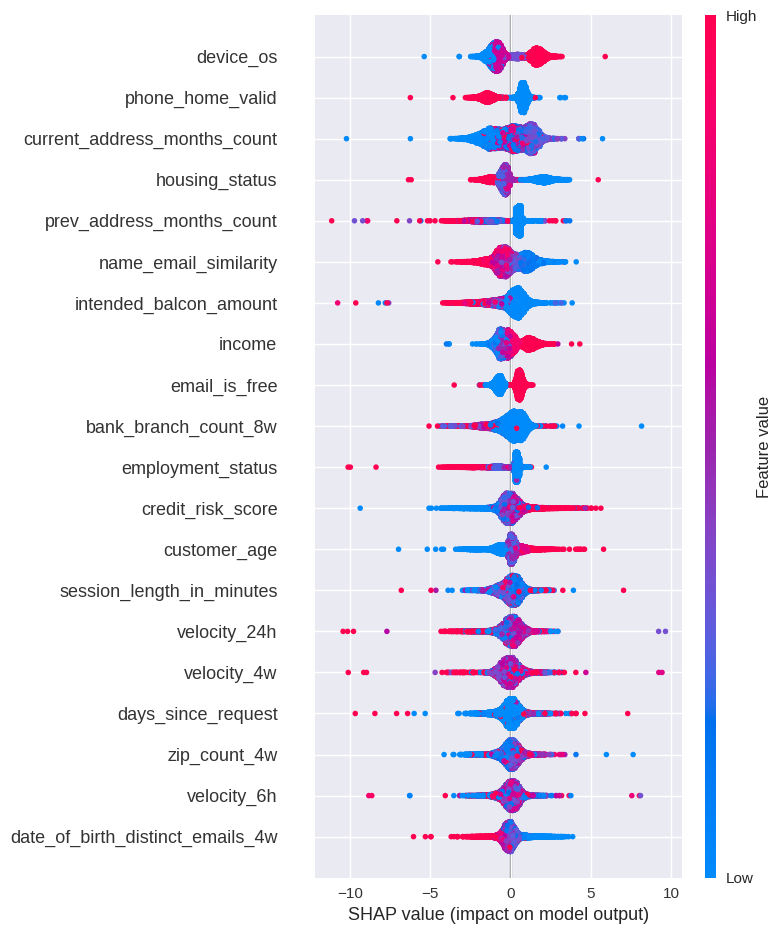

In [ ]:
# A 모델 해석 및 평가 4
# shaply value 요약 비선형을 고려한 top5 기여 feature 확인
#

# 군집 컨디션: ('has_other_cards' == 0) and ('keep_alive_session' == 0)
# 같은 은행의 다른 카드가 없고 세션을 로그아웃 없이 계속 유지하고 있는 군집.

# 모델 A에서 사용했던 디바이스 os, 거주 형태에 따라 사기 가능성이 높았다.
# 모델 A결과와 유사하게 거짓 집전화 정보, 거짓 주소 정보일 경우 사기일 가능성이 높다.


import shap

explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(x_test)
shap.summary_plot(shap_values, x_test, plot_type='bar')
shap.summary_plot(shap_values, x_test)
plt.show()

In [ ]:
# A 모델 해석 및 평가 5
# top5 feature 로 다시 학습한 후 rule extraction
# 여기서도 모델 A의 컨디션이 거의 그대로 나왔다.
# 윈도우 사용자, 주거 형태에 따른 사기 가능성을 지목하고 있다.

from rulefit import RuleFit

features = ['device_os', 'phone_home_valid', 'current_address_months_count', 'housing_status', 'prev_address_months_count']

x_train_rule = x_train[features]
rulefit = RuleFit(tree_size=8, sample_fract='default', max_rules=300, random_state=42)
rulefit.fit(x_train_rule.values, y_train.values.ravel(), x_train_rule.columns)
y_pred = rulefit.predict(x_train_rule.values)
y_pred_binary = (y_pred > 0.2).astype(int)
print(classification_report(y_train, y_pred_binary, digits=3))

rules = rulefit.get_rules()
rules = rules[rules.coef != 0]

table_temp = rules.sort_values("importance", ascending=False).head(5)
display(table_temp)

print(f'########## Rule Extraction ##########')
[print(i) for i in table_temp['rule']]

              precision    recall  f1-score   support

           0      0.947     0.873     0.909     48320
           1      0.320     0.550     0.404      5236

    accuracy                          0.841     53556
   macro avg      0.633     0.712     0.656     53556
weighted avg      0.886     0.841     0.859     53556



,rule,type,coef,support,importance
194,device_os <= 3.5 & device_os > 2.5 & housing_s...,rule,0.131836,0.088710,0.037484
93,housing_status > 0.5 & device_os <= 2.5,rule,-0.066676,0.516801,0.033319
0,device_os,linear,-0.016118,1.000000,0.019580
141,device_os > 2.5 & housing_status <= 0.5 & curr...,rule,0.064661,0.084677,0.018002
139,device_os <= 0.5 & housing_status <= 0.5,rule,-0.069600,0.065860,0.017264


########## Rule Extraction ##########
device_os <= 3.5 & device_os > 2.5 & housing_status <= 0.5
housing_status > 0.5 & device_os <= 2.5
device_os
device_os > 2.5 & housing_status <= 0.5 & current_address_months_count > 36.5
device_os <= 0.5 & housing_status <= 0.5


[None, None, None, None, None]

### **인사이트**

> **사기 데이터 관련 정보**

>> **군집화 feature**
```
주거 형태, 디바이스 OS, 세션 유지 여부가 군집을 나누는데 활용된다.
```

>> **허위 정보 기입**
```
거짓 집전화 정보, 이름과 이메일 유사도, 등록 미기재
허위 주소와 인적사항을 사용하는 경우 사기일 가능성이 높다.
주소와 인적사항에 대하여 인증을 강화한다.
주소와 인적사항 관련 feature들을 더 추출하여 모니터링한다.
```

>> **자동화 사기**
```
디바이스 OS, 세션 유지, 세션 길이, 하루에 신청한 양
자동화를 통해서 스캠을 시도하는 것을 의심해볼 수 있다.
자동화를 측정할 수 있는 feature들을 다양하게 추출하여 모니터링한다.
자동화 의심 횟수 초과 시 계좌 개설을 차단한다.
```

> **은행 데이터 관련 정보**

>> **군집화 feature**
```
카드를 가지고 있는지 여부가 군집을 나누는데 활용된다.
```

>> **소득**
```
소득이 높을수록 사기 가능성이 올라갔다.
소득 관련 feature들을 더 추출하여 모니터링한다.
```

# **⭐️스토리 정리**
---

> **전처리**
```
intended_balcon_amount는 명세서와 다른 부분이 있어 컬럼을 제거했다.
```

> **EDA**
```
데이터의 인사이트를 얻기 위해 데이터 EDA를 진행했다.
EDA 결과 fraud의 점유율과 fraud 확률이 동시에 높은 군집 A를 발견했다.
(컨디션: ('housing_status' == 'BA') and ('device_os' == 'windows'))
(fraud 점유율: 전체 fraud 11k 중 약 4k로 36%)
(fraud 확률: 전체 데이터셋의 1.1% -> 군집 데이터셋의 6.7%)
```

> **모델링**
```
A 군집에 대한 이진분류 모델을 설계했다.
여러 모델을 탐색한 결과 TabNet이 가장 성능이 좋았다.
TabNet에 대한 자료조사와 fine-tuning을 진행했다.
TabNet의 성능이 생각보다 좋지 않아서 LightGBM으로 다시 시도했다.
```

> **중간 결과 (A 군집)**
```
A 군집 fraud 기준 3918개 중에 81.1% 검출 (3178개)
전체 fraud 기준 11029개 중에 28.8% 검출
```

> **EDA**
```
A 군집을 제외한 나머지 데이터를 다시 EDA 진행했다.
EDA 결과 fraud의 점유율과 fraud 확률이 동시에 높은 군집 B를 발견했다.
(컨디션: ('has_other_cards' == 0) and ('keep_alive_session' == 0))
(fraud 점유율: 전체 fraud 11k 중 약 7k로 59%)
(fraud 확률: 전체 데이터셋의 1.1% -> 군집 데이터셋의 2.1%)
```

> **모델링**
```
B 군집에 대한 이진분류 모델을 설계했다.
LightGBM을 그대로 사용하면서 하이퍼 파리미터를 튜닝했다.
```

> **중간 결과 (B 군집)**
```
B 군집 fraud, 6545개 중에 83.6% 검출 (5472개)
전체 fraud, 11029개 중에 49.6% 검출
```

> **종합 결과**
```
A 군집에서 3918개 중에 81.1%인 3178개를 검출했다.
B 군집에서 6545개 중에 83.6%인 5472개를 검출했다.
두 군집을 합하면 총 8650개를 검출했다.
이는 전체 fraud 11029개 중에 78.4%를 검출한 것이다.
```

> **모델 해석**
```
shaply value와 rule extraction 결과 허위정보 기입과 자동화 사기를 방지 해야한다.
두 모델 모두 ROC curve와 cumulative gain curve가 왼쪽 위로 꺾여있다.
-> 모델의 전반적인 분류 성능이 좋다.
-> 가장 잘 예측한 샘플들에서 실제로 많은 중요한 결과를 찾았다.
```

> **인사이트**
```
인사이트 참고
```

# **Lesson & Learn**

> **시각화 능력 향상**
```
다차원 표현 능력 향상
바이올린 플랏을 통한 개형 분석
스캐터링은 크기가 클 경우 샘플링하여 플랏
```

> **분류 모델링 능력 향상**
```
랜덤포레스트, XGBoost, LightGBM, TabNet 활용
TabNet과 LightGBM 하이퍼파라미터 연구
shaply value를 통한 모델 해석
rule extraction을 통한 레시피 도출
```

> **인사이트 도출 능력 향상**
```
세부 feature를 분석하여 유의미한 사기 관련 정보 획득
```

> **사기 데이터에서 추출한 유용한 정보**
```
인사이트 참고
```

> **은행 데이터에서 추출한 유용한 정보**
```
인사이트 참고
```